# Time Series Analysis for each station

In [1]:
import pandas as pd
import os
import numpy as np
import utils
import time

from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from pmdarima import auto_arima # for determining ARIMA orders

import matplotlib.ticker as ticker
formatter = ticker.StrMethodFormatter('{x:,.0f}')

In [2]:
from statsmodels.tsa.arima_model import ARMA,ARMAResults,ARIMA,ARIMAResults
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # for determining (p,q) orders
from pmdarima import auto_arima # for determining ARIMA orders
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import MinMaxScaler

In [3]:
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.preprocessing.sequence import TimeseriesGenerator

In [4]:
import prophet
from prophet import Prophet
from prophet.diagnostics import performance_metrics
from prophet.diagnostics import cross_validation
from prophet.plot import plot_cross_validation_metric

In [5]:
# dir(utils)

In [6]:
from utils import creating_time_series
from utils import load_single_timeseries
from utils import timeseries_eda
from utils import check_adfuller
from utils import model_evaluation

In [55]:
input_path = f"{os.getcwd()}\\input_data\\"
output_path = "C:\\Users\\DKici\\Desktop\\Metrolinx\\"
ts_path = f"{os.getcwd()}\\ts_data\\"
data_file = "interview_dataset.xlsx"
figures_path = f'{output_path}\\figures\\'
data_path = input_path + data_file

'C:\\Users\\DKici\\Desktop\\Metrolinx\\'

### Preprocess raw data and create sigle time series

Single Time Series for each rail corridor and station

data is loaded!


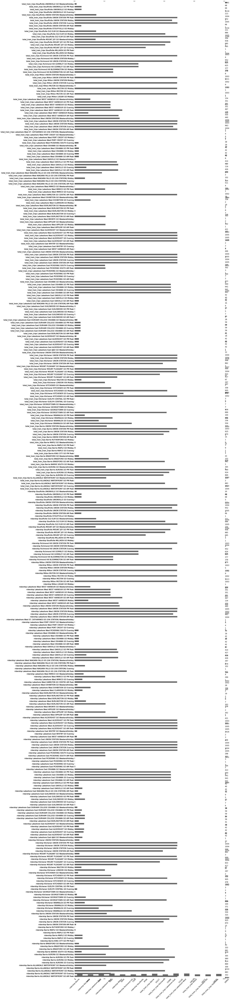

In [8]:
rc_data, rc_st_data, rc_st_tp_data = creating_time_series(data_path, ts_path)

In [9]:
holidays = pd.read_csv(f'{input_path}/holidays.csv')
holidays.columns= holidays.columns.str.lower()
holidays = holidays.iloc[:,:-2]
# print(holidays)

In [17]:
rc_st_data

['Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data',
 'Metrolinx_Barrie_AURORA GO_Data']

# Model Development

=================Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data.csv
time series loaded!
Data All: 
              ridership  trips
date                        
2019-01-02        174      3
2019-01-03       4218      7
2019-01-04       4434      7
2019-01-05       3886      7
2019-01-06        346      3
Data: 
              ridership
date                 
2019-01-02        174
2019-01-03       4218
2019-01-04       4434
2019-01-05       3886
2019-01-06        346
Data Regressors: 
              trips
date             
2019-01-02      3
2019-01-03      7
2019-01-04      7
2019-01-05      7
2019-01-06      3
            ridership
date                 
2019-01-02        174
2019-01-03       4218
2019-01-04       4434
2019-01-05       3886
2019-01-06        346
...               ...
2022-12-28        840
2022-12-29        962
2022-12-30        930
2022-12-31        752
2023-01-01

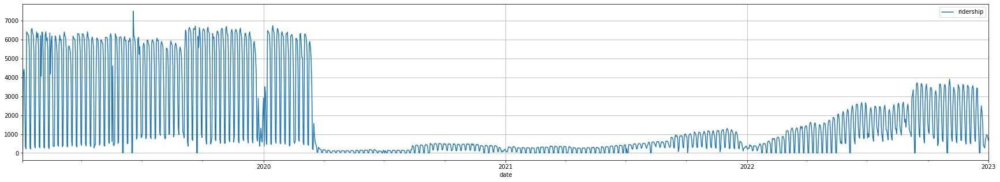

--------------
Test statistic:  -1.9171147753895854
p-value:  0.3240531073979981
Critical Values: {'1%': -3.4349056408696814, '5%': -2.863552005375758, '10%': -2.5678411776130114}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

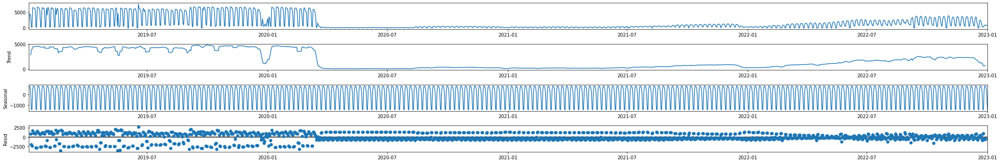

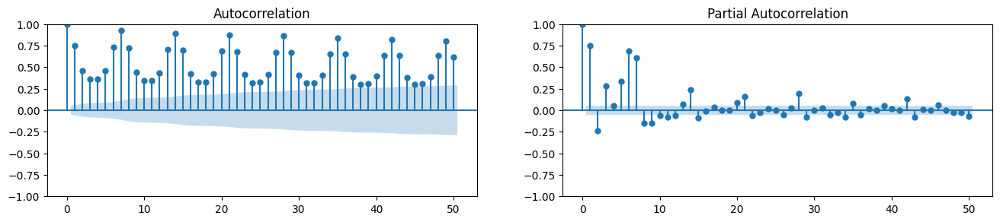

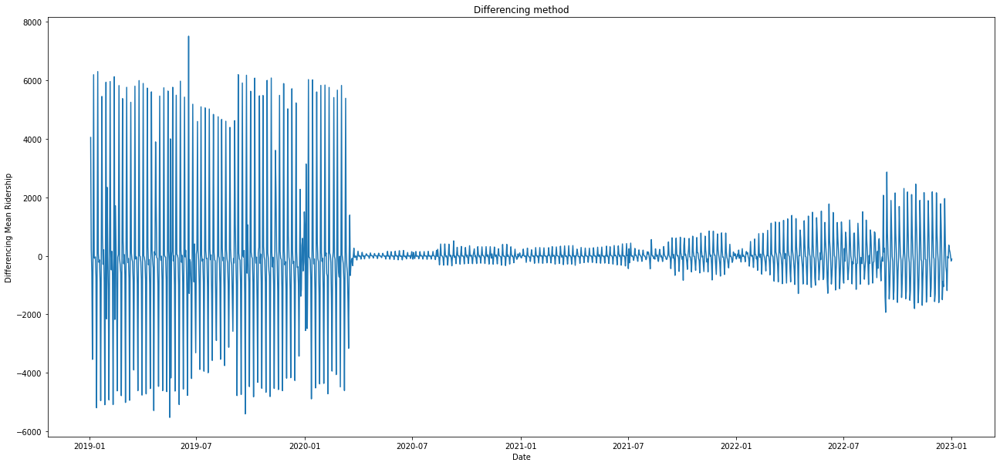

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19311.599, Time=0.41 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19440.081, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19417.431, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19002.063, Time=0.63 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19438.082, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19421.908, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19003.680, Time=1.02 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=19003.096, Time=2.03 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19416.427, Time=0.16 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=18891.335, Time=2.17 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=18752.603, Time=2.55 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=18716.550, Time=1.63 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=18886.685, Time=1.43 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=19149.453, Time=0.89 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data ARIMA MSE Error: 2055632.928
 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data ARIMA  RMSE Error: 1433.747861 
 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data ARIMA  R square: -0.7895198693
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 100)               40800     
                                                                 
 dense_3 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1066/1066 [==============================] - 5s 4ms/step - loss: 0.0551
Epoch 2/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0404
Epoch 3/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0221
Epoch 4/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0183
Epoch 5/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0143
Epoch 6/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0109
Epoch 7/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0098
Epoch 8/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0086
Epoch 9/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0085
Epoch 10/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0084
Epoch 11/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0085
Epoch 12/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0078
E

<IPython.core.display.Javascript object>


 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data LSTM MSE Error: 3450533.431
 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data LSTM  RMSE Error: 1857.561151 
 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data LSTM  R square: -2.003842782
          ds     y  trips
0 2019-01-02   174      3
1 2019-01-03  4218      7
2 2019-01-04  4434      7
3 2019-01-05  3886      7
4 2019-01-06   346      3
 
  ########## Cross validation for Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data ######### 
 


16:43:23 - cmdstanpy - INFO - Chain [1] start processing
16:43:23 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

16:43:23 - cmdstanpy - INFO - Chain [1] start processing
16:43:24 - cmdstanpy - INFO - Chain [1] done processing
16:43:25 - cmdstanpy - INFO - Chain [1] start processing
16:43:25 - cmdstanpy - INFO - Chain [1] done processing
16:43:26 - cmdstanpy - INFO - Chain [1] start processing
16:43:26 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.038891500000318


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse              5658895.3934
rmse              2348.268976
mae               1912.505077
mdape                1.672824
smape                1.470741
coverage             0.453241
dtype: object
             ds  trips
0    2019-01-02      3
1    2019-01-03      7
2    2019-01-04      7
3    2019-01-05      7
4    2019-01-06      3
...         ...    ...
1456 2022-12-28      6
1457 2022-12-29      9
1458 2022-12-30      9
1459 2022-12-31      9
1460 2023-01-01      6

[1461 rows x 2 columns]

 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data Prophet MSE Error: 550028.0818
 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data Prophet  RMSE Error: 741.6387812 
 Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data Prophet  R square: 0.5211760974
=================Metrolinx_Barrie_AURORA GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Barrie_AURORA GO_Data.csv
time 

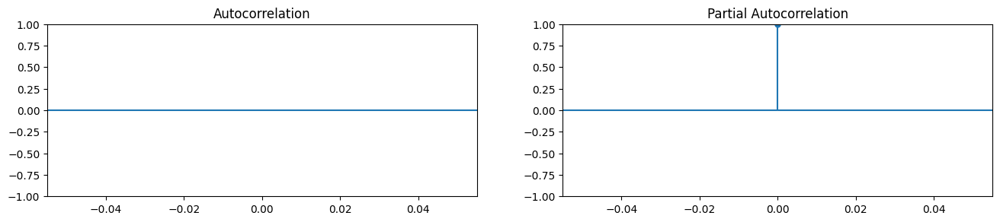

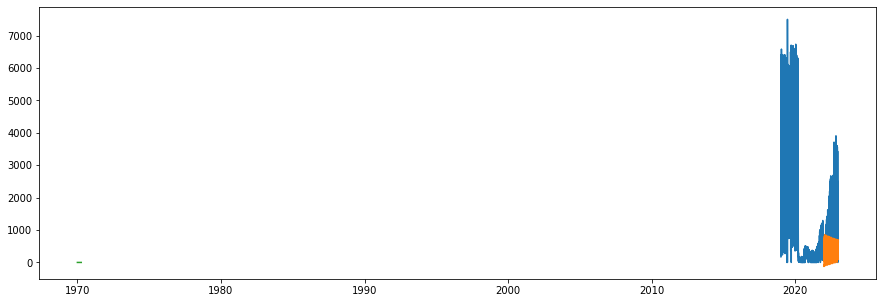

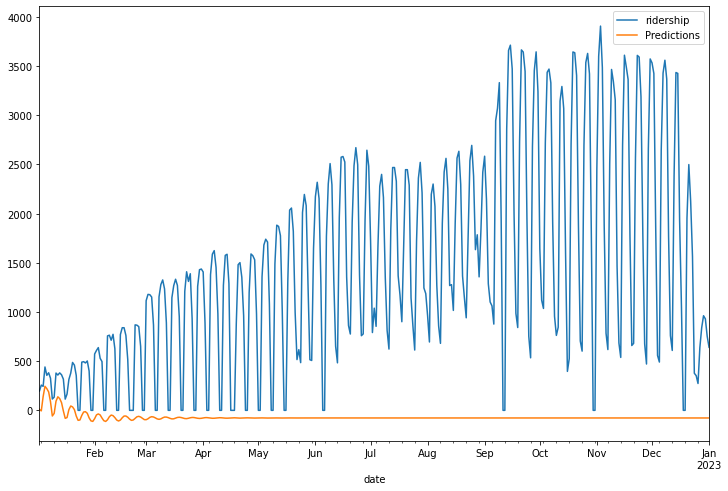

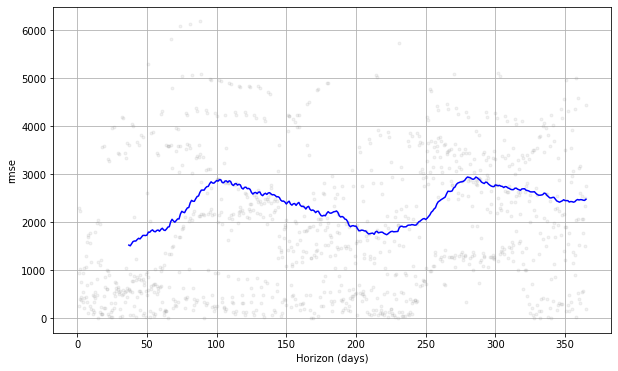

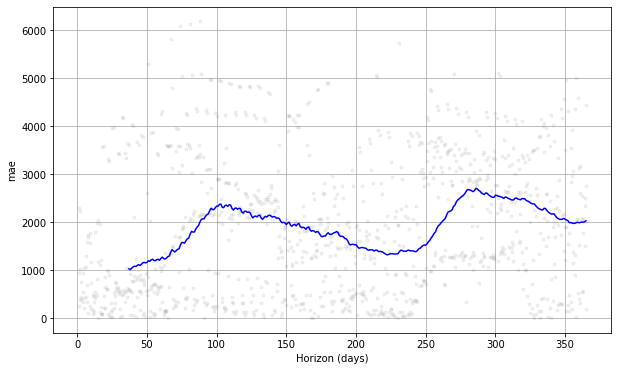

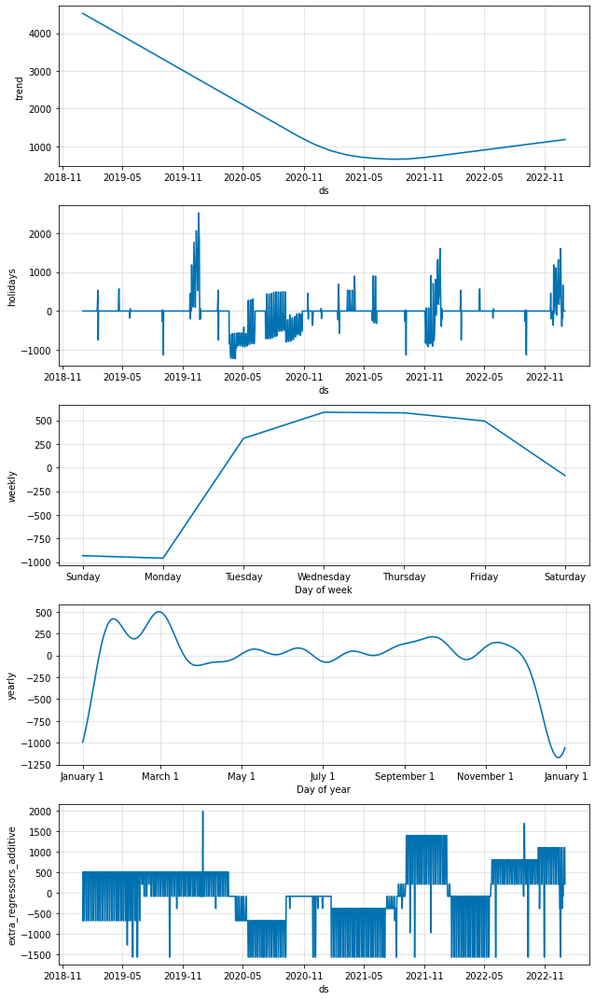

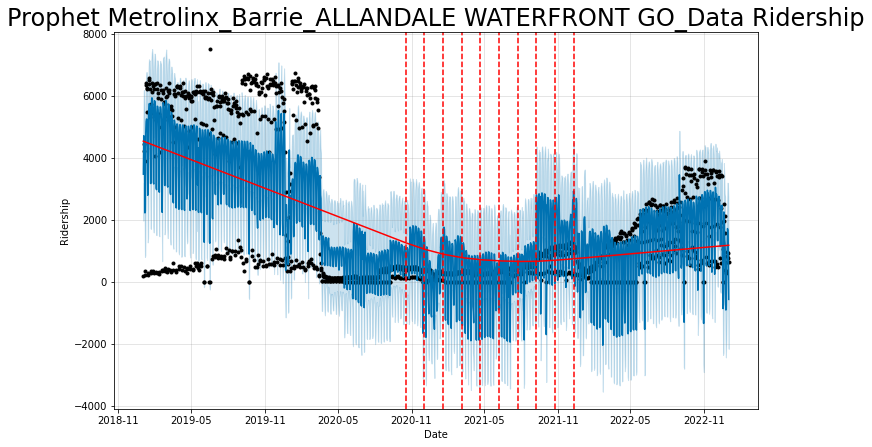

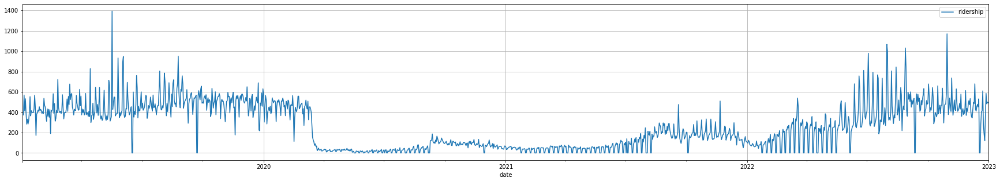

--------------
Test statistic:  -1.4073622643313042
p-value:  0.578741511289505
Critical Values: {'1%': -3.4349024693573584, '5%': -2.8635506057382325, '10%': -2.5678404322793846}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

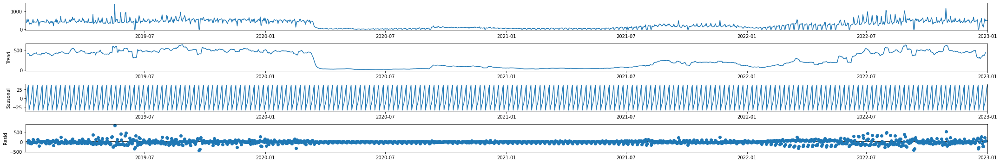

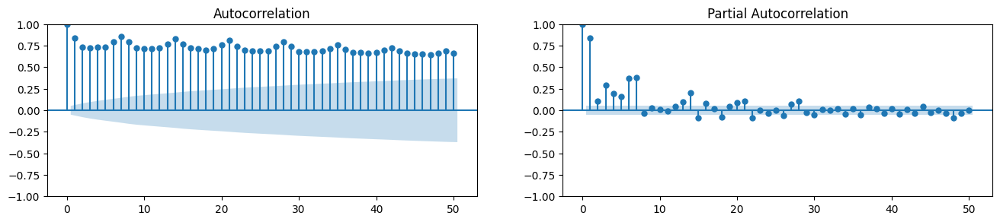

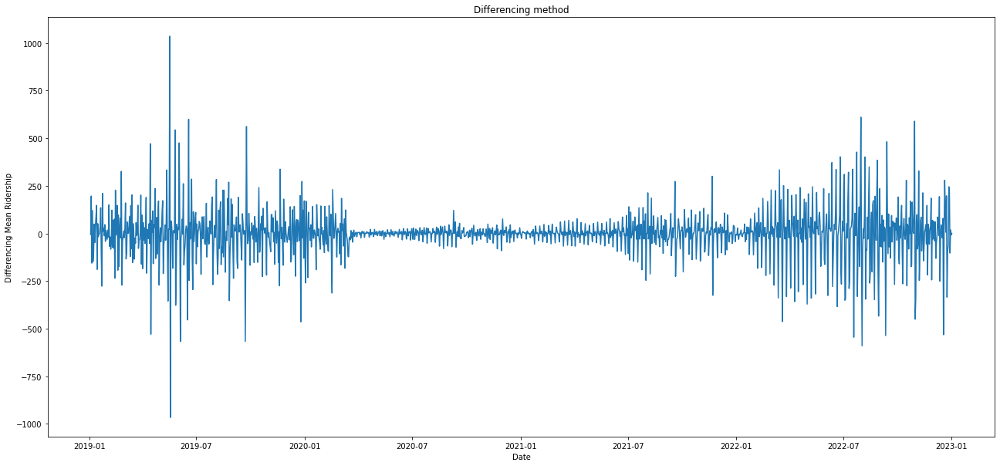

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=13290.757, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=13292.464, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=13202.135, Time=0.10 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=12936.100, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=13290.471, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=12938.560, Time=0.11 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=12938.008, Time=0.42 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=12937.492, Time=0.81 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=12936.402, Time=0.26 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=12913.669, Time=1.51 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=inf, Time=3.06 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=12909.506, Time=1.10 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=12936.289, Time=0.68 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=13292.756, Time=0.55 sec
 ARIMA(1,1,1)(2,0,1)[6] i

<IPython.core.display.Javascript object>


 Metrolinx_Barrie_AURORA GO_Data ARIMA MSE Error: 84279.99205
 Metrolinx_Barrie_AURORA GO_Data ARIMA  RMSE Error: 290.3101652 
 Metrolinx_Barrie_AURORA GO_Data ARIMA  R square: -0.8707348856
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 100)               40800     
                                                                 
 dense_4 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1066/1066 [==============================] - 5s 4ms/step - loss: 0.0057
Epoch 2/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0046
Epoch 3/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0045
Epoch 4/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0042
Epoch 5/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0043
Epoch 6/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0043
Epoch 7/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0042
Epoch 8/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0043
Epoch 9/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0042
Epoch 10/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0040
Epoch 11/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0040
Epoch 12/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0039
E

<IPython.core.display.Javascript object>


 Metrolinx_Barrie_AURORA GO_Data LSTM MSE Error: 159561.7203
 Metrolinx_Barrie_AURORA GO_Data LSTM  RMSE Error: 399.4517746 
 Metrolinx_Barrie_AURORA GO_Data LSTM  R square: -2.541738309
          ds    y  trips
0 2019-01-02  379     10
1 2019-01-03  373      8
2 2019-01-04  569      8
3 2019-01-05  413      8
4 2019-01-06  533     10
 
  ########## Cross validation for Metrolinx_Barrie_AURORA GO_Data ######### 
 


16:51:41 - cmdstanpy - INFO - Chain [1] start processing
16:51:41 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

16:51:42 - cmdstanpy - INFO - Chain [1] start processing
16:51:42 - cmdstanpy - INFO - Chain [1] done processing
16:51:43 - cmdstanpy - INFO - Chain [1] start processing
16:51:44 - cmdstanpy - INFO - Chain [1] done processing
16:51:45 - cmdstanpy - INFO - Chain [1] start processing
16:51:45 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.732848099999501


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Barrie_AURORA GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse              71910.381578
rmse               255.276064
mae                217.328029
mdape                0.750609
smape                1.275425
coverage             0.315068
dtype: object
             ds  trips
0    2019-01-02     10
1    2019-01-03      8
2    2019-01-04      8
3    2019-01-05      8
4    2019-01-06     10
...         ...    ...
1456 2022-12-28      9
1457 2022-12-29      6
1458 2022-12-30      5
1459 2022-12-31      6
1460 2023-01-01      9

[1461 rows x 2 columns]

 Metrolinx_Barrie_AURORA GO_Data Prophet MSE Error: 11656.93362
 Metrolinx_Barrie_AURORA GO_Data Prophet  RMSE Error: 107.9672803 
 Metrolinx_Barrie_AURORA GO_Data Prophet  R square: 0.7412549308
=================Metrolinx_Barrie_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Barrie_UNION STATION_Data.csv
time series loaded!
Data All: 
              ridershi

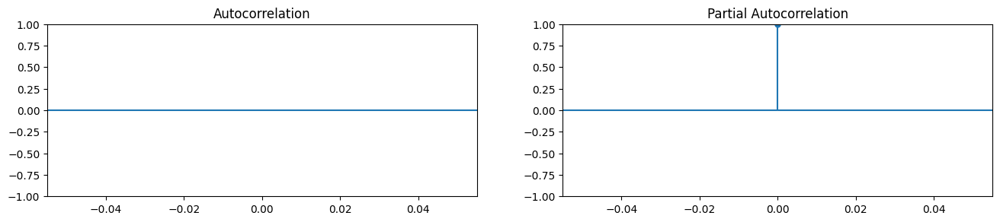

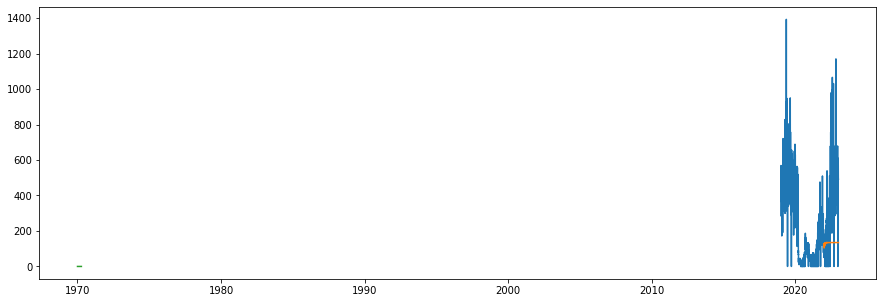

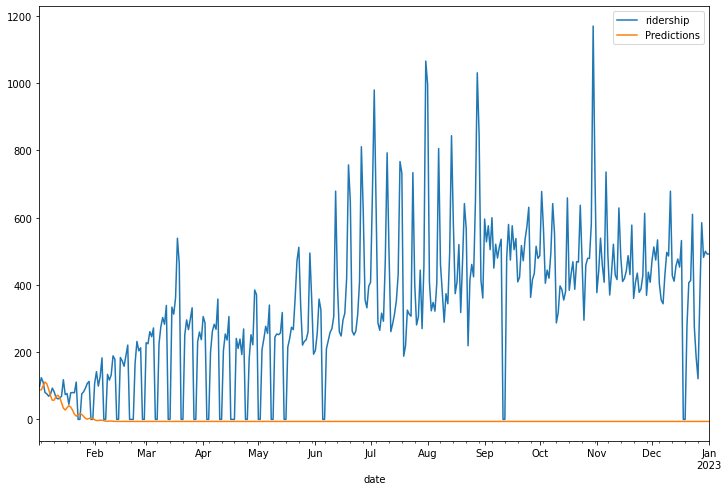

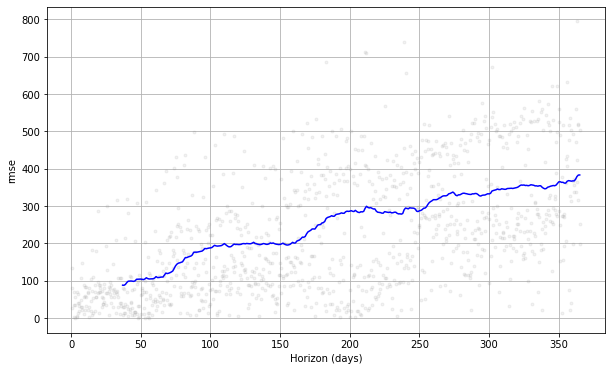

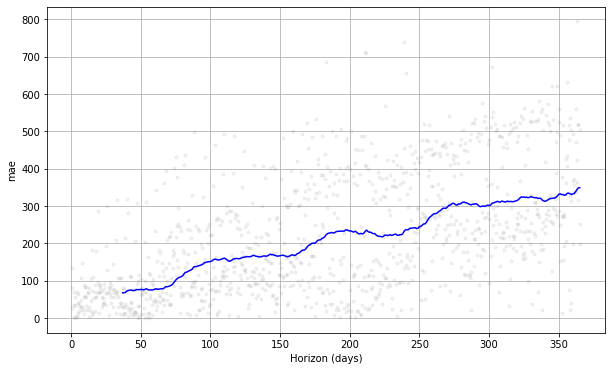

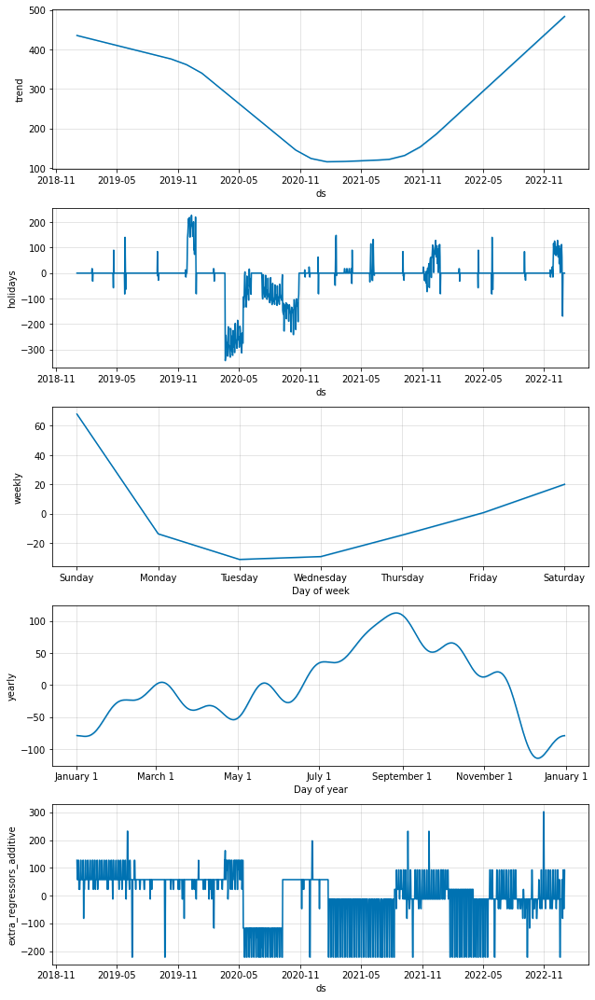

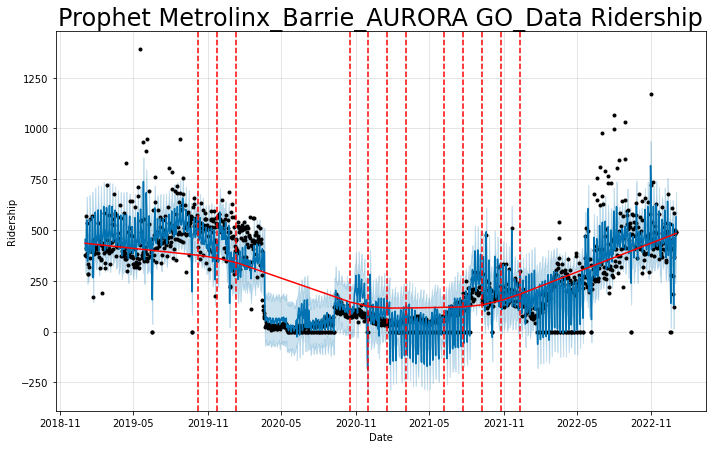

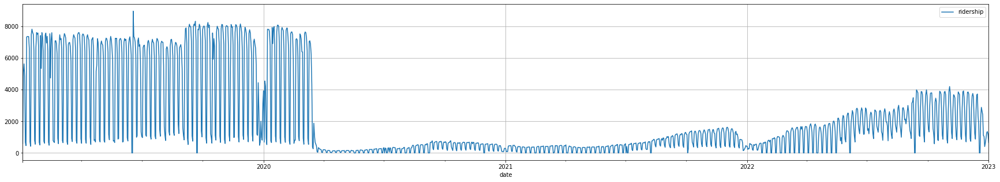

--------------
Test statistic:  -1.8924925082508435
p-value:  0.3356010722555509
Critical Values: {'1%': -3.4349056408696814, '5%': -2.863552005375758, '10%': -2.5678411776130114}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

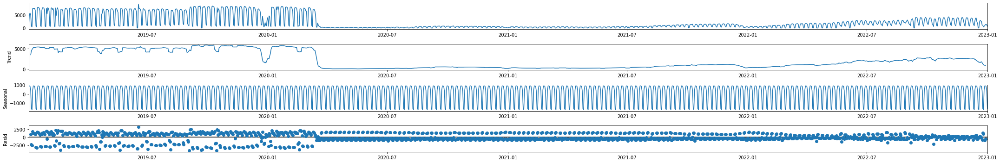

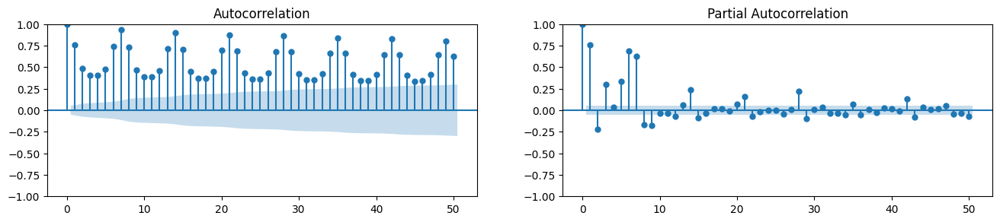

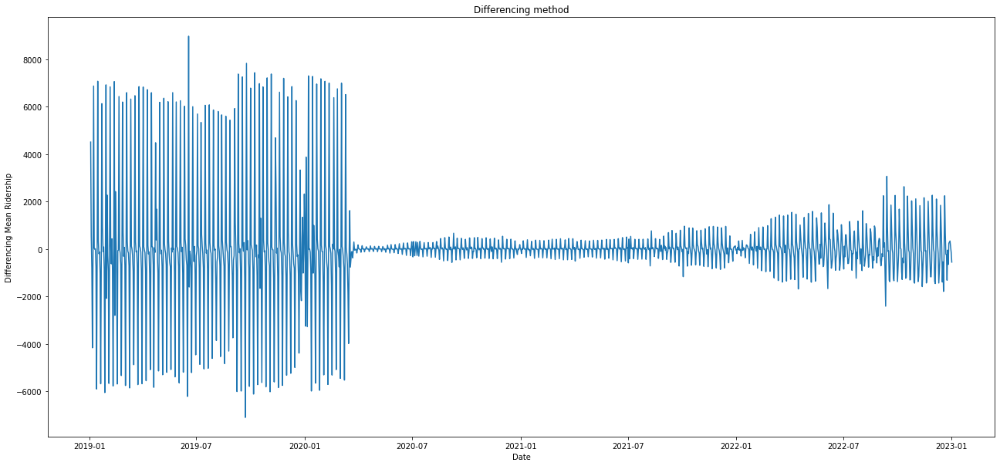

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19673.385, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19820.357, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19800.397, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19361.675, Time=0.62 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19818.357, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19803.321, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19363.650, Time=0.91 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=19523.673, Time=0.98 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19799.739, Time=0.16 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=19250.255, Time=2.19 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=19209.221, Time=2.55 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=19100.780, Time=1.75 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=19259.291, Time=1.41 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=19523.828, Time=1.07 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Barrie_UNION STATION_Data ARIMA MSE Error: 3088077.236
 Metrolinx_Barrie_UNION STATION_Data ARIMA  RMSE Error: 1757.292587 
 Metrolinx_Barrie_UNION STATION_Data ARIMA  R square: -1.436000175
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_5 (LSTM)               (None, 100)               40800     
                                                                 
 dense_5 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1066/1066 [==============================] - 5s 4ms/step - loss: 0.0524
Epoch 2/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0464
Epoch 3/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0427
Epoch 4/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0281
Epoch 5/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0189
Epoch 6/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0159
Epoch 7/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0118
Epoch 8/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0101
Epoch 9/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0093
Epoch 10/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0087
Epoch 11/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0088
Epoch 12/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0080
E

<IPython.core.display.Javascript object>


 Metrolinx_Barrie_UNION STATION_Data LSTM MSE Error: 5683112.553
 Metrolinx_Barrie_UNION STATION_Data LSTM  RMSE Error: 2383.927967 
 Metrolinx_Barrie_UNION STATION_Data LSTM  R square: -3.483068951
          ds     y  trips
0 2019-01-02   596     12
1 2019-01-03  5102     18
2 2019-01-04  5636     18
3 2019-01-05  4837     18
4 2019-01-06   670     12
 
  ########## Cross validation for Metrolinx_Barrie_UNION STATION_Data ######### 
 


17:00:00 - cmdstanpy - INFO - Chain [1] start processing
17:00:01 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:00:01 - cmdstanpy - INFO - Chain [1] start processing
17:00:01 - cmdstanpy - INFO - Chain [1] done processing
17:00:02 - cmdstanpy - INFO - Chain [1] start processing
17:00:03 - cmdstanpy - INFO - Chain [1] done processing
17:00:04 - cmdstanpy - INFO - Chain [1] start processing
17:00:04 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.5169683000003715


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Barrie_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse             7223319.37399
rmse              2672.099812
mae               2084.966655
mdape                1.275367
smape                1.475115
coverage             0.502886
dtype: object
             ds  trips
0    2019-01-02     12
1    2019-01-03     18
2    2019-01-04     18
3    2019-01-05     18
4    2019-01-06     12
...         ...    ...
1456 2022-12-28     15
1457 2022-12-29     16
1458 2022-12-30     16
1459 2022-12-31     16
1460 2023-01-01     15

[1461 rows x 2 columns]

 Metrolinx_Barrie_UNION STATION_Data Prophet MSE Error: 809423.2696
 Metrolinx_Barrie_UNION STATION_Data Prophet  RMSE Error: 899.6795372 
 Metrolinx_Barrie_UNION STATION_Data Prophet  R square: 0.3614941998
=================Metrolinx_Lakeshore East_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Lakeshore East_UNION STATION_Data.csv
time series loaded!
D

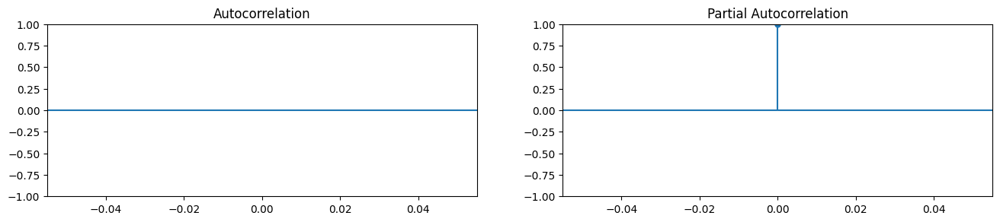

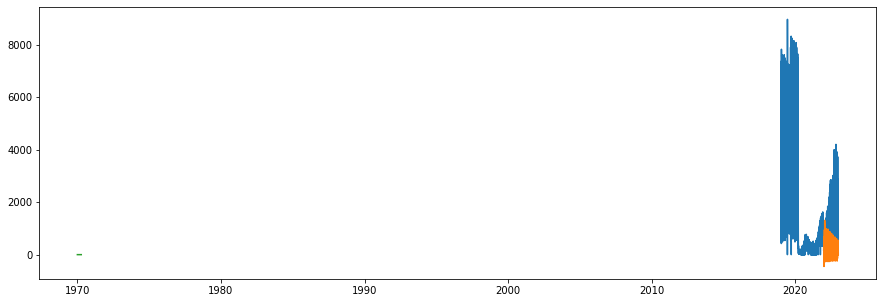

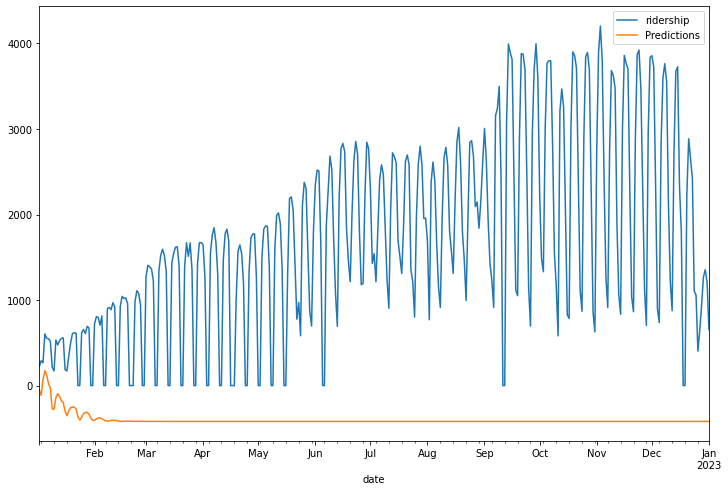

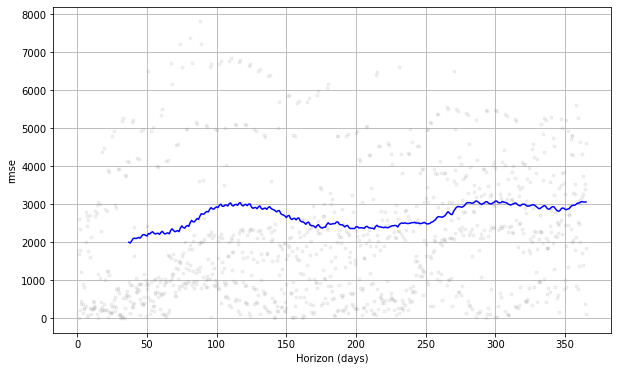

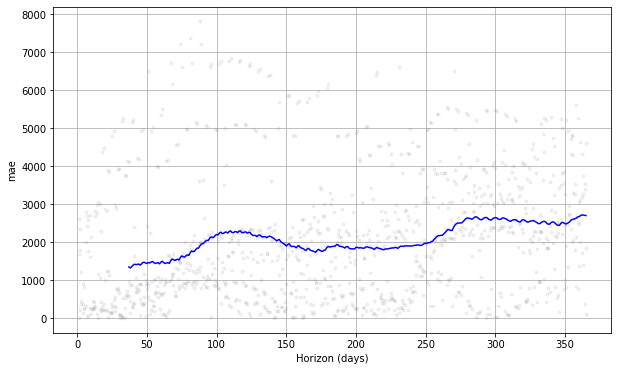

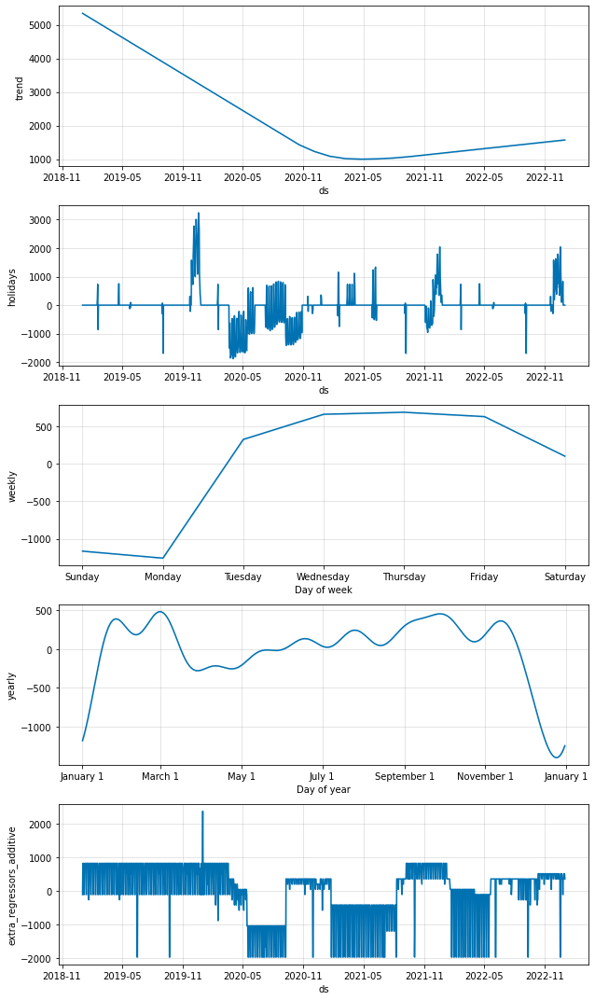

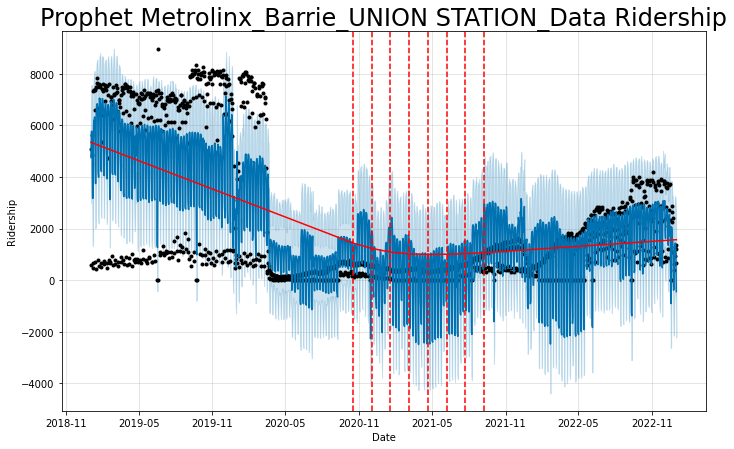

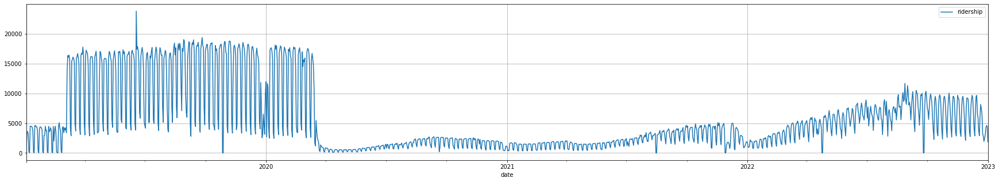

--------------
Test statistic:  -1.9277800750981222
p-value:  0.31910743113489337
Critical Values: {'1%': -3.4349056408696814, '5%': -2.863552005375758, '10%': -2.5678411776130114}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

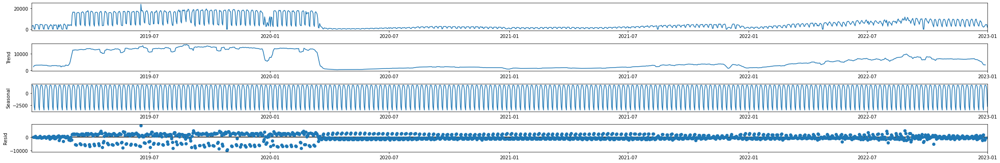

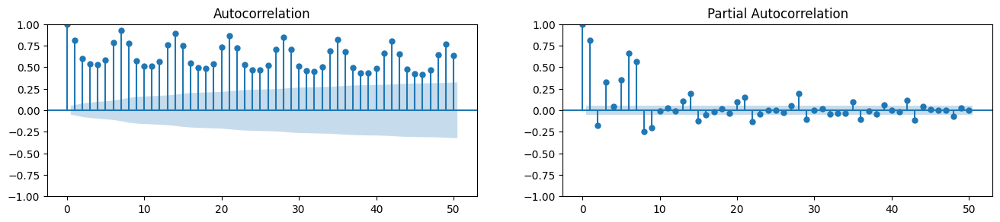

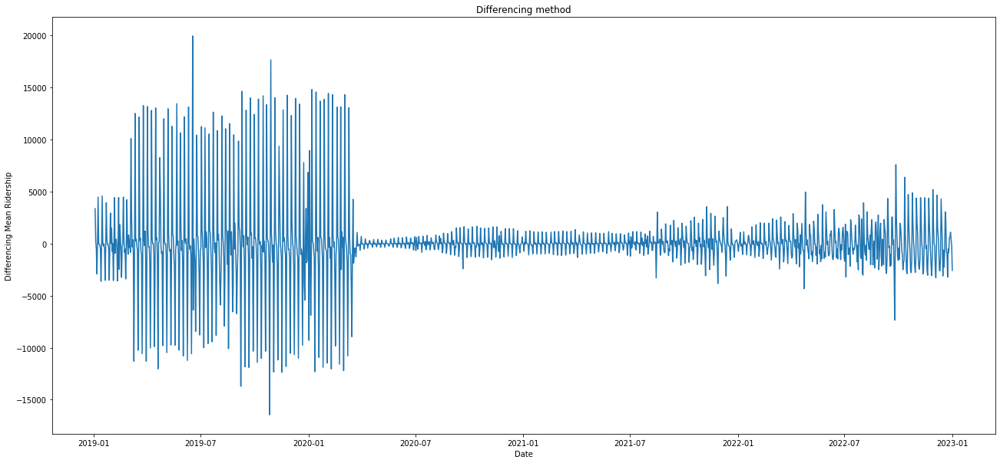

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=21072.210, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=21191.334, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=21174.707, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=20836.335, Time=0.56 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=21189.334, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=21177.526, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=20838.273, Time=0.93 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=20962.040, Time=0.40 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=21174.544, Time=0.15 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=20733.679, Time=2.14 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=20652.435, Time=1.65 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=20598.169, Time=1.77 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=20737.998, Time=1.56 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=20959.176, Time=0.58 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore East_UNION STATION_Data ARIMA MSE Error: 20869683.08
 Metrolinx_Lakeshore East_UNION STATION_Data ARIMA  RMSE Error: 4568.334825 
 Metrolinx_Lakeshore East_UNION STATION_Data ARIMA  R square: -2.063682612
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (None, 100)               40800     
                                                                 
 dense_6 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1066/1066 [==============================] - 5s 4ms/step - loss: 0.0315
Epoch 2/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0275
Epoch 3/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0253
Epoch 4/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0202
Epoch 5/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0141
Epoch 6/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0123
Epoch 7/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0114
Epoch 8/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0099
Epoch 9/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0082
Epoch 10/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0065
Epoch 11/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0065
Epoch 12/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0060
E

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore East_UNION STATION_Data LSTM MSE Error: 35106920.73
 Metrolinx_Lakeshore East_UNION STATION_Data LSTM  RMSE Error: 5925.109344 
 Metrolinx_Lakeshore East_UNION STATION_Data LSTM  R square: -4.153718061
          ds     y  trips
0 2019-01-02    26      1
1 2019-01-03  3397     14
2 2019-01-04  3615     14
3 2019-01-05  3130     14
4 2019-01-06   226      1
 
  ########## Cross validation for Metrolinx_Lakeshore East_UNION STATION_Data ######### 
 


17:08:31 - cmdstanpy - INFO - Chain [1] start processing
17:08:32 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:08:33 - cmdstanpy - INFO - Chain [1] start processing
17:08:33 - cmdstanpy - INFO - Chain [1] done processing
17:08:34 - cmdstanpy - INFO - Chain [1] start processing
17:08:34 - cmdstanpy - INFO - Chain [1] done processing
17:08:35 - cmdstanpy - INFO - Chain [1] start processing
17:08:36 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.740547200000037


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Lakeshore East_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            37625790.99809
rmse              6048.105489
mae               5156.497156
mdape                1.220829
smape                1.334697
coverage             0.263229
dtype: object
             ds  trips
0    2019-01-02      1
1    2019-01-03     14
2    2019-01-04     14
3    2019-01-05     14
4    2019-01-06      1
...         ...    ...
1456 2022-12-28     37
1457 2022-12-29     41
1458 2022-12-30     41
1459 2022-12-31     41
1460 2023-01-01     35

[1461 rows x 2 columns]

 Metrolinx_Lakeshore East_UNION STATION_Data Prophet MSE Error:   3449942.1
 Metrolinx_Lakeshore East_UNION STATION_Data Prophet  RMSE Error: 1857.401976 
 Metrolinx_Lakeshore East_UNION STATION_Data Prophet  R square: 0.4935463283
=================Metrolinx_Lakeshore East_OSHAWA GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Lakeshore East_OSHAWA GO_Data.c

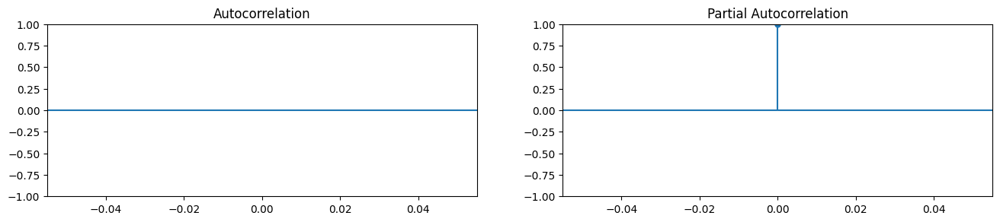

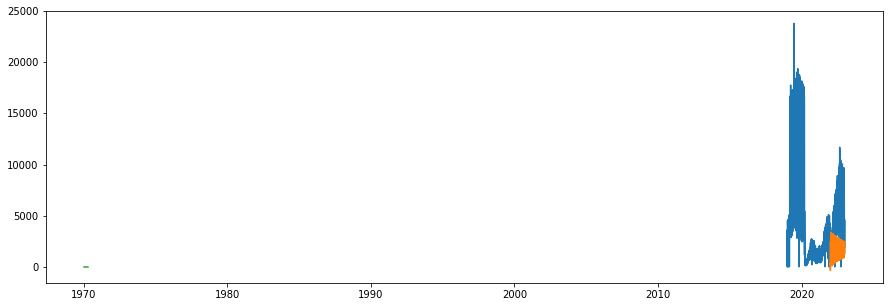

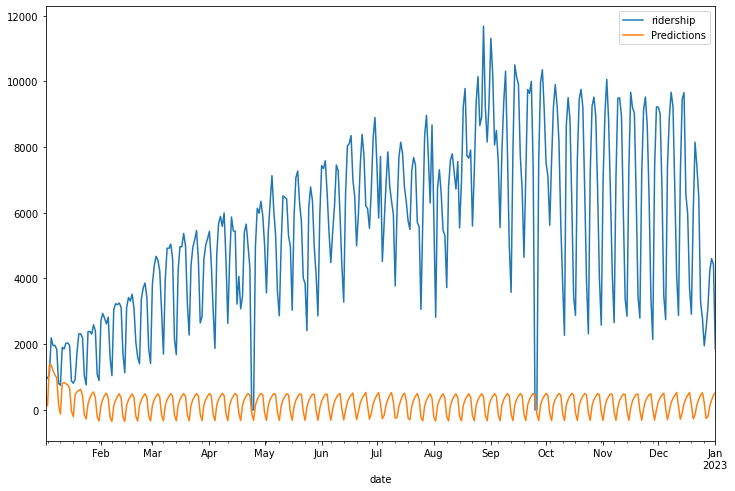

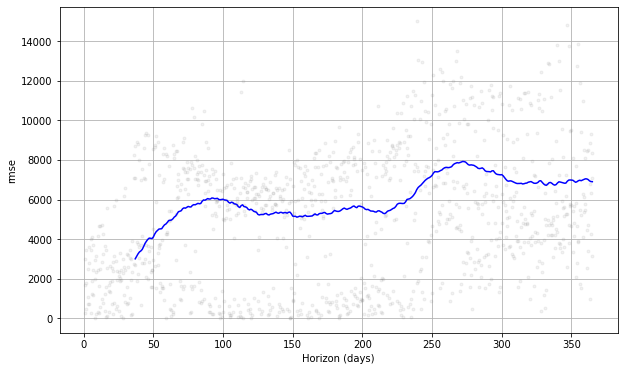

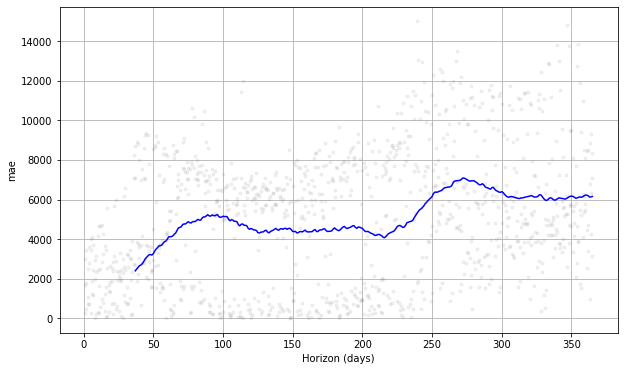

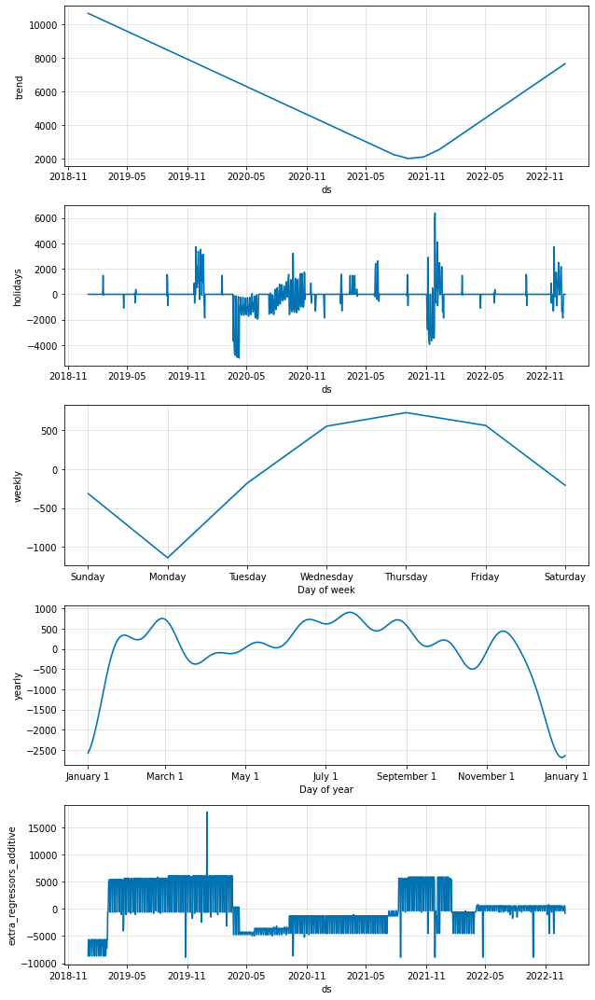

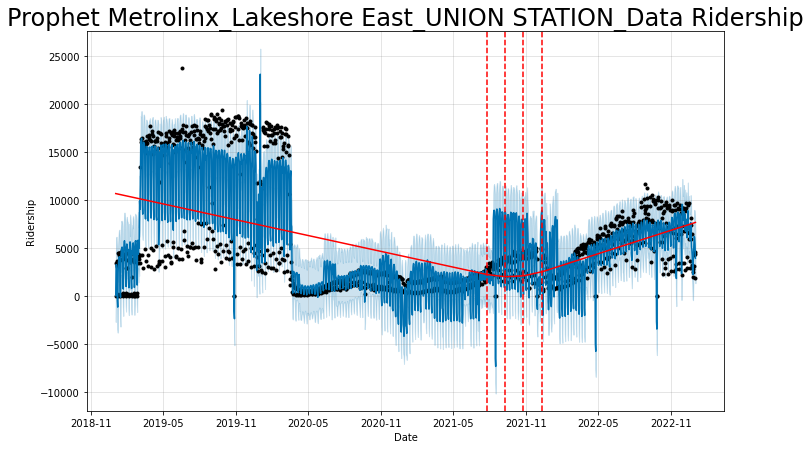

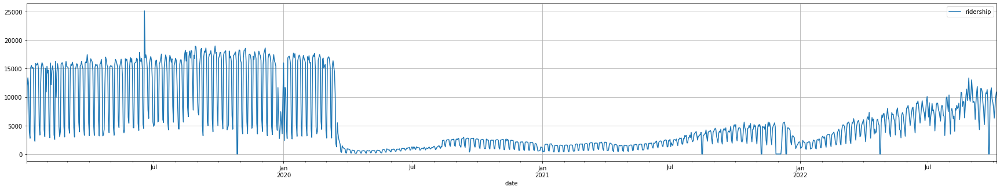

--------------
Test statistic:  -1.6803473394652717
p-value:  0.4412654998346133
Critical Values: {'1%': -3.4351995694971165, '5%': -2.8636817142206836, '10%': -2.5679102510737173}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

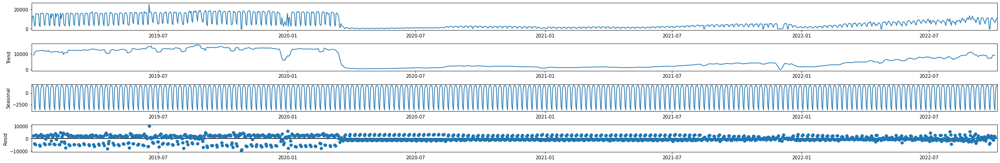

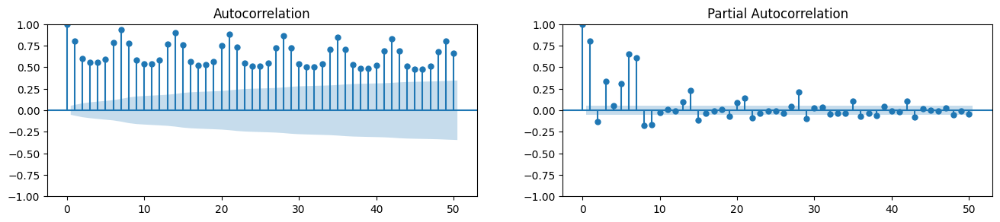

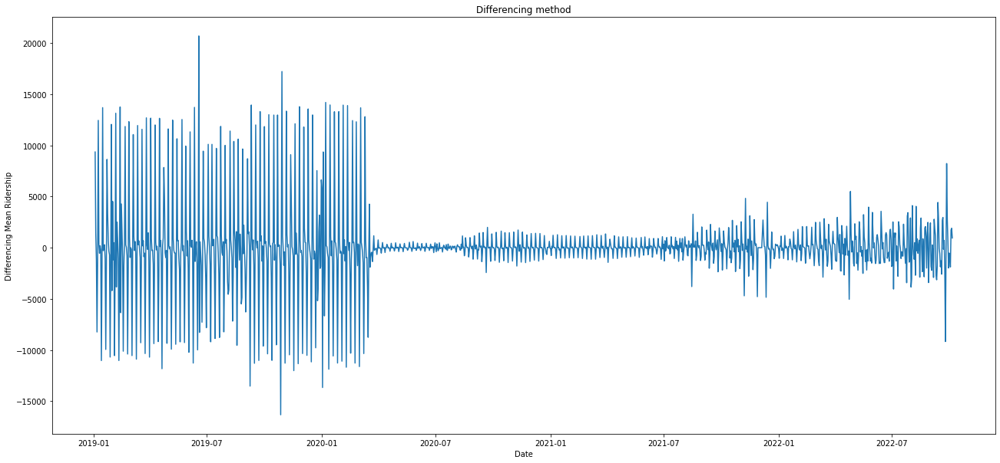

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19547.848, Time=0.11 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19645.144, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19635.048, Time=0.11 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19264.360, Time=0.59 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19643.144, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19644.116, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19265.850, Time=0.94 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=19267.324, Time=1.89 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19399.414, Time=0.51 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=19174.718, Time=2.27 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=19115.700, Time=2.27 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=19067.399, Time=1.56 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=19187.424, Time=1.23 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=19469.376, Time=0.76 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore East_OSHAWA GO_Data ARIMA MSE Error: 10600199.99
 Metrolinx_Lakeshore East_OSHAWA GO_Data ARIMA  RMSE Error: 3255.794832 
 Metrolinx_Lakeshore East_OSHAWA GO_Data ARIMA  R square: -0.2612499254
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_7 (LSTM)               (None, 100)               40800     
                                                                 
 dense_7 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


979/979 [==============================] - 4s 4ms/step - loss: 0.0301
Epoch 2/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0253
Epoch 3/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0238
Epoch 4/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0234
Epoch 5/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0177
Epoch 6/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0142
Epoch 7/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0101
Epoch 8/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0115
Epoch 9/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0149
Epoch 10/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0111
Epoch 11/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0095
Epoch 12/100
979/979 [==============================] - 4s 4ms/step - loss: 0.0079
Epoch 13/100
979/979 [===

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore East_OSHAWA GO_Data LSTM MSE Error: 46493415.28
 Metrolinx_Lakeshore East_OSHAWA GO_Data LSTM  RMSE Error: 6818.608016 
 Metrolinx_Lakeshore East_OSHAWA GO_Data LSTM  R square: -4.531953794
          ds      y  trips
0 2019-01-02   2623     36
1 2019-01-03  11969     56
2 2019-01-04  13387     57
3 2019-01-05  12218     52
4 2019-01-06   3981     35
 
  ########## Cross validation for Metrolinx_Lakeshore East_OSHAWA GO_Data ######### 
 


17:16:03 - cmdstanpy - INFO - Chain [1] start processing
17:16:04 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/2 [00:00<?, ?it/s]

17:16:05 - cmdstanpy - INFO - Chain [1] start processing
17:16:05 - cmdstanpy - INFO - Chain [1] done processing
17:16:06 - cmdstanpy - INFO - Chain [1] start processing
17:16:07 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  4.521884699999646


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Lakeshore East_OSHAWA GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse           39587073.985383
rmse              6054.992311
mae               5315.182371
mdape                1.110105
smape                1.274817
coverage             0.277866
dtype: object
             ds  trips
0    2019-01-02     36
1    2019-01-03     56
2    2019-01-04     57
3    2019-01-05     52
4    2019-01-06     35
...         ...    ...
1369 2022-10-02     37
1370 2022-10-03     37
1371 2022-10-04     41
1372 2022-10-05     41
1373 2022-10-06     41

[1374 rows x 2 columns]

 Metrolinx_Lakeshore East_OSHAWA GO_Data Prophet MSE Error: 3716981.075
 Metrolinx_Lakeshore East_OSHAWA GO_Data Prophet  RMSE Error: 1927.947374 
 Metrolinx_Lakeshore East_OSHAWA GO_Data Prophet  R square: 0.5577402211
=================Metrolinx_Lakeshore West_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Lakeshore West_UNION STATION_Data.csv
time 

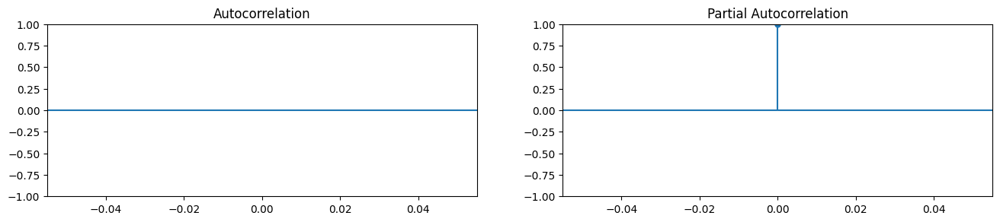

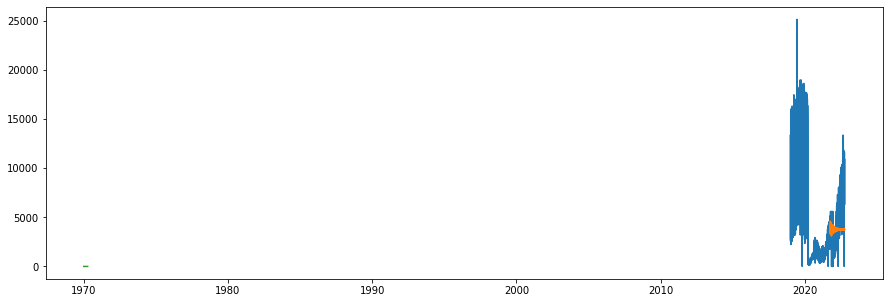

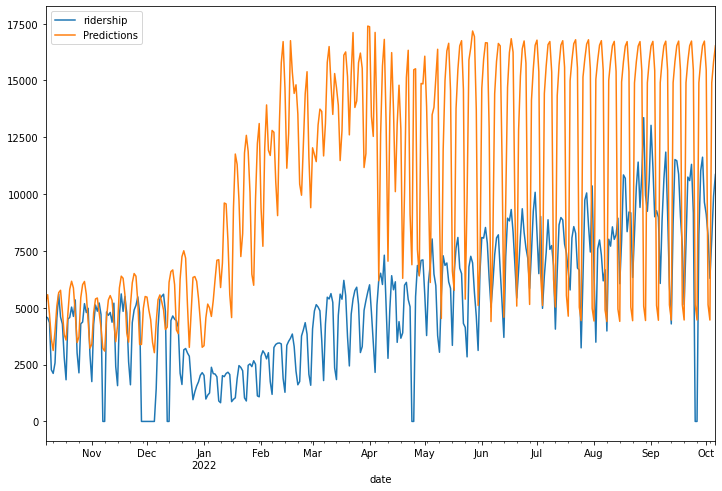

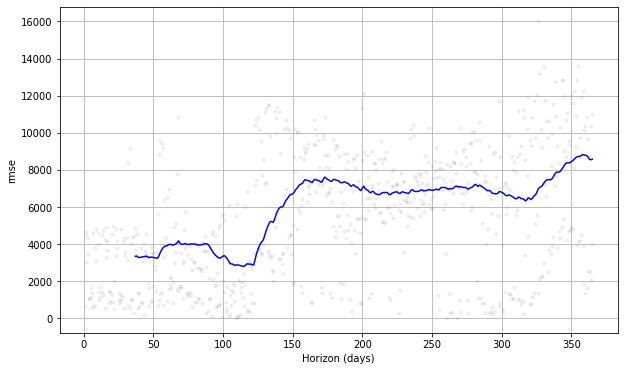

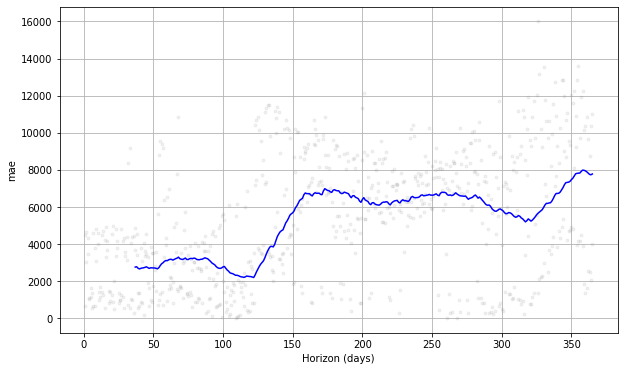

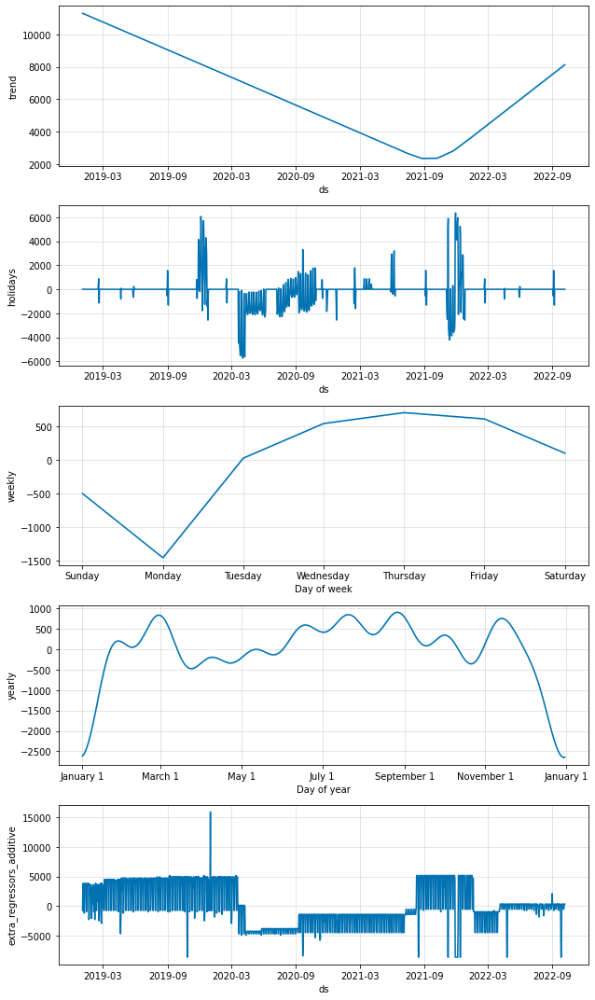

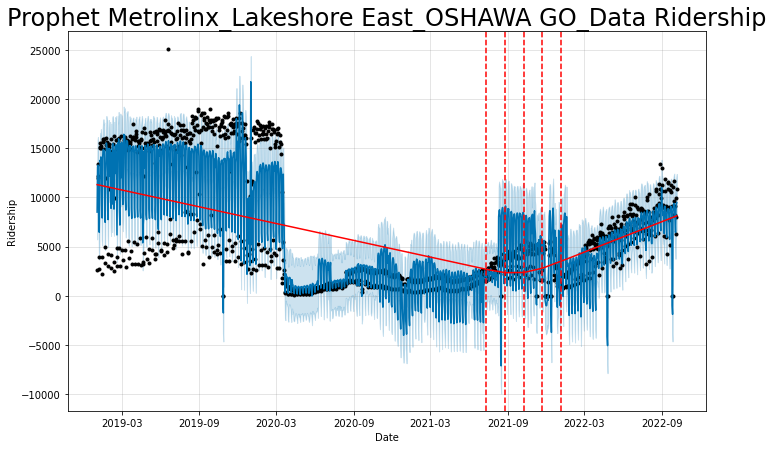

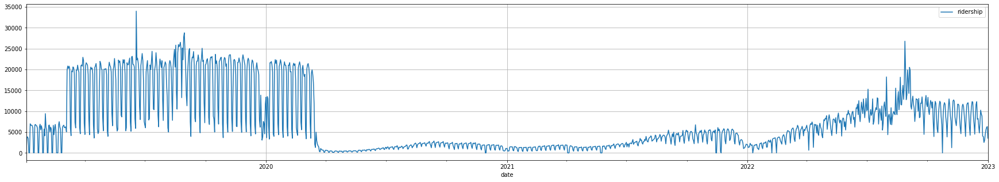

--------------
Test statistic:  -1.8741521512186194
p-value:  0.34431672307352146
Critical Values: {'1%': -3.4349024693573584, '5%': -2.8635506057382325, '10%': -2.5678404322793846}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

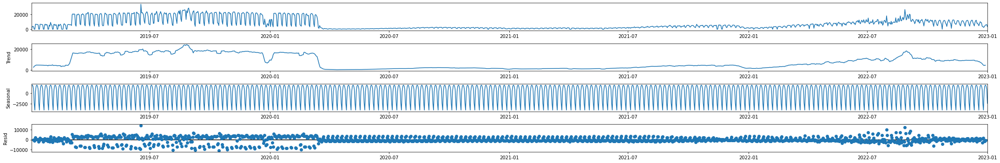

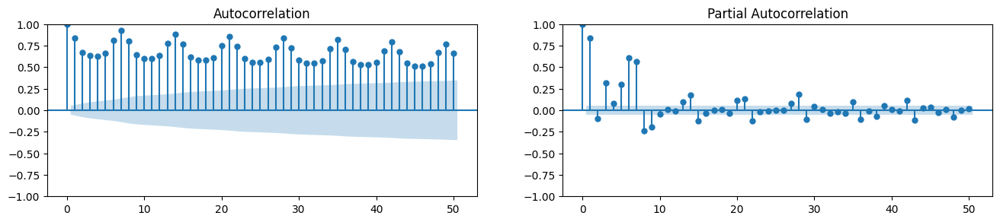

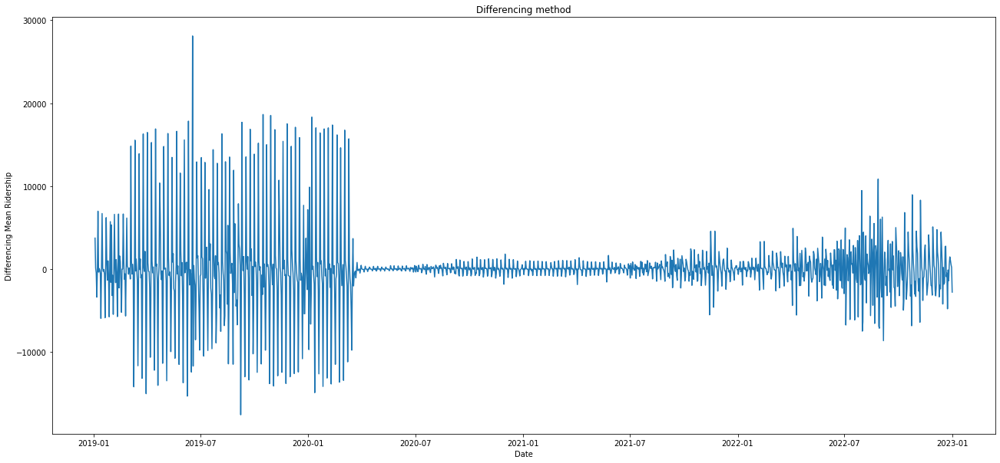

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=21476.977, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=21571.104, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=21559.010, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=21246.325, Time=0.58 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=21569.105, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=21571.036, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=21247.507, Time=0.86 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=21248.985, Time=1.99 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=21390.660, Time=0.22 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=21149.440, Time=2.12 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=20876.027, Time=2.68 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=21152.405, Time=0.65 sec
 ARIMA(0,1,0)(2,0,2)[6] intercept   : AIC=21371.690, Time=0.93 sec
 ARIMA(1,1,1)(2,0,2)[6] intercept   : AIC=21050.090, Time=2.37 sec
 ARIMA(0,1,2)(2,0,2

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore West_UNION STATION_Data ARIMA MSE Error: 43211666.99
 Metrolinx_Lakeshore West_UNION STATION_Data ARIMA  RMSE Error: 6573.558168 
 Metrolinx_Lakeshore West_UNION STATION_Data ARIMA  R square: -1.646225134
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 100)               40800     
                                                                 
 dense_8 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1066/1066 [==============================] - 5s 4ms/step - loss: 0.0217
Epoch 2/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0181
Epoch 3/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0172
Epoch 4/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0145
Epoch 5/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0113
Epoch 6/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0086
Epoch 7/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0064
Epoch 8/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0055
Epoch 9/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0056
Epoch 10/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0053
Epoch 11/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0052
Epoch 12/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0052
E

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore West_UNION STATION_Data LSTM MSE Error: 48525165.44
 Metrolinx_Lakeshore West_UNION STATION_Data LSTM  RMSE Error: 6966.000678 
 Metrolinx_Lakeshore West_UNION STATION_Data LSTM  R square: -1.971616727
          ds     y  trips
0 2019-01-02    14      1
1 2019-01-03  3742     10
2 2019-01-04  3874     10
3 2019-01-05  3410     10
4 2019-01-06    21      1
 
  ########## Cross validation for Metrolinx_Lakeshore West_UNION STATION_Data ######### 
 


17:24:05 - cmdstanpy - INFO - Chain [1] start processing
17:24:05 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:24:06 - cmdstanpy - INFO - Chain [1] start processing
17:24:06 - cmdstanpy - INFO - Chain [1] done processing
17:24:07 - cmdstanpy - INFO - Chain [1] start processing
17:24:07 - cmdstanpy - INFO - Chain [1] done processing
17:24:08 - cmdstanpy - INFO - Chain [1] start processing
17:24:08 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.123114099999839


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Lakeshore West_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse           83539219.605652
rmse              8986.225595
mae                7728.97817
mdape                1.389626
smape                1.505438
coverage             0.228977
dtype: object
             ds  trips
0    2019-01-02      1
1    2019-01-03     10
2    2019-01-04     10
3    2019-01-05     10
4    2019-01-06      1
...         ...    ...
1456 2022-12-28     39
1457 2022-12-29     46
1458 2022-12-30     45
1459 2022-12-31     45
1460 2023-01-01     40

[1461 rows x 2 columns]

 Metrolinx_Lakeshore West_UNION STATION_Data Prophet MSE Error: 8146776.444
 Metrolinx_Lakeshore West_UNION STATION_Data Prophet  RMSE Error: 2854.255848 
 Metrolinx_Lakeshore West_UNION STATION_Data Prophet  R square: 0.5011022232
=================Metrolinx_Lakeshore West_ALDERSHOT GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Lakeshore West_ALDERSHOT GO_

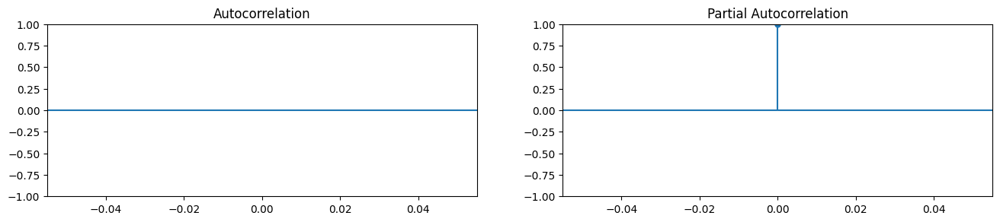

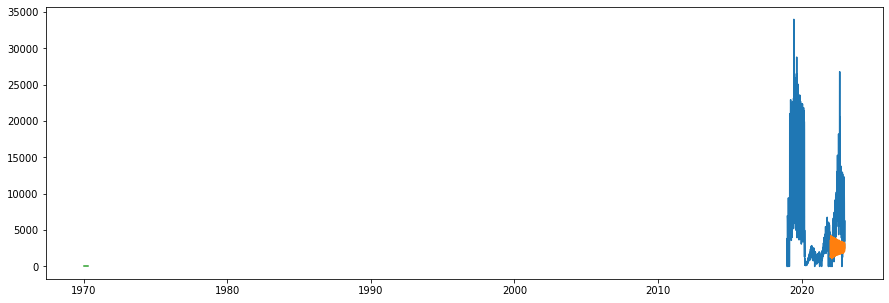

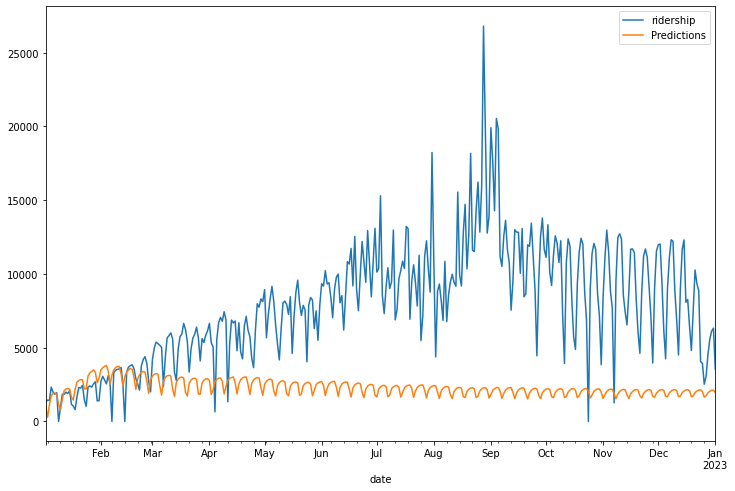

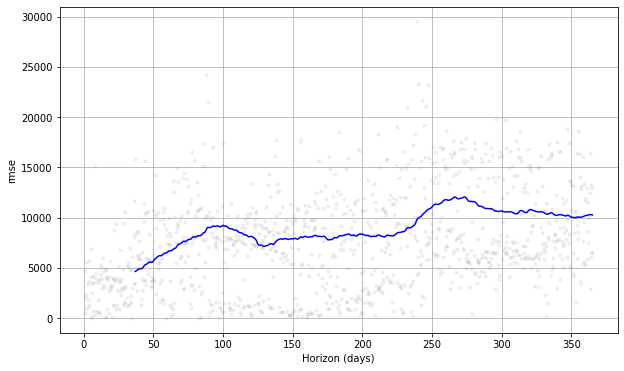

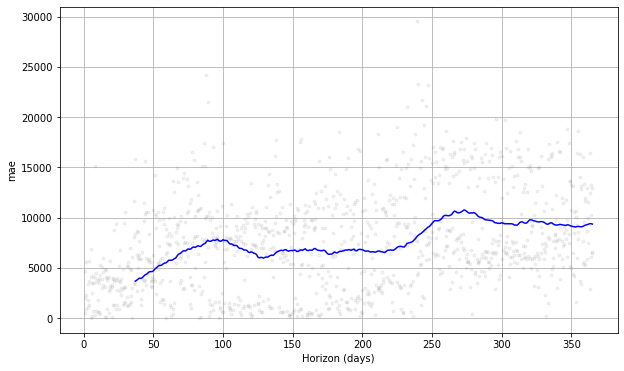

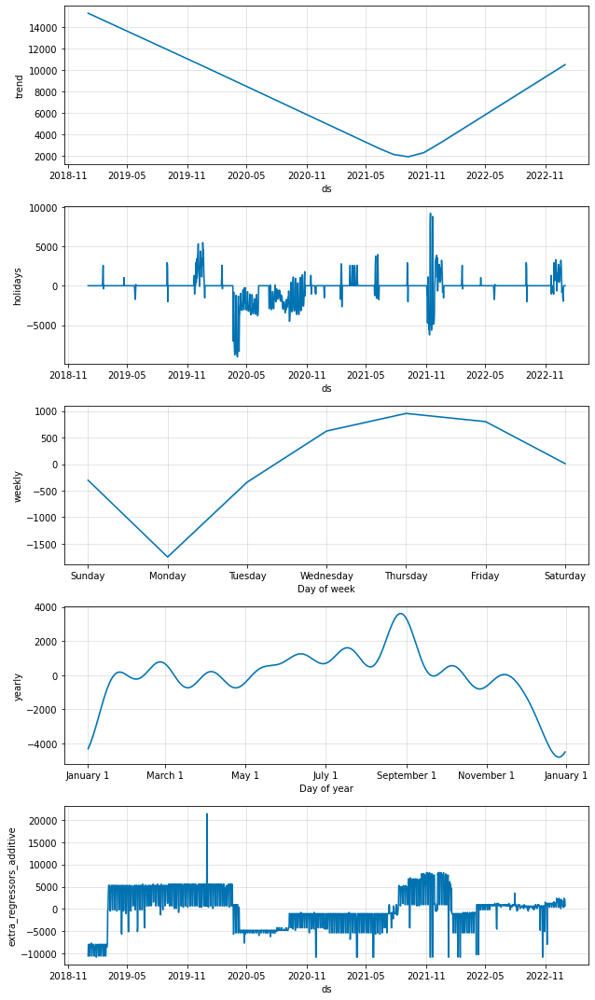

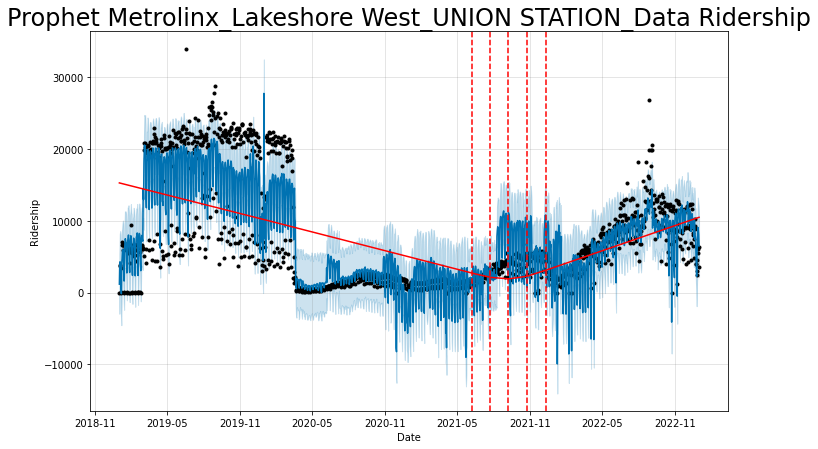

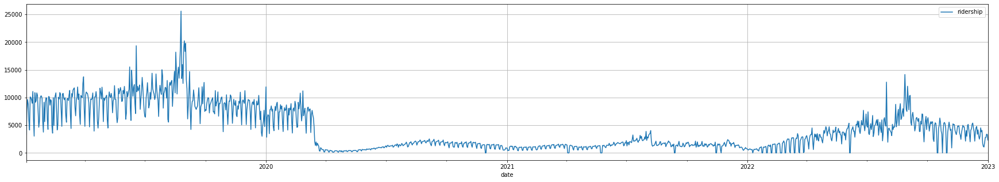

--------------
Test statistic:  -1.9055353332243
p-value:  0.329461612773491
Critical Values: {'1%': -3.4349024693573584, '5%': -2.8635506057382325, '10%': -2.5678404322793846}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

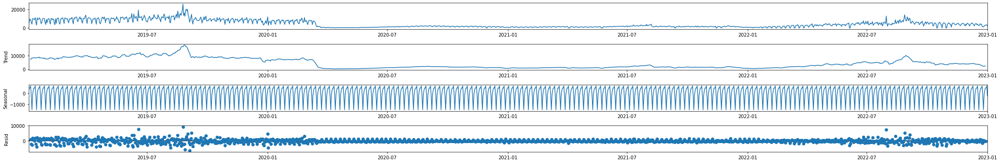

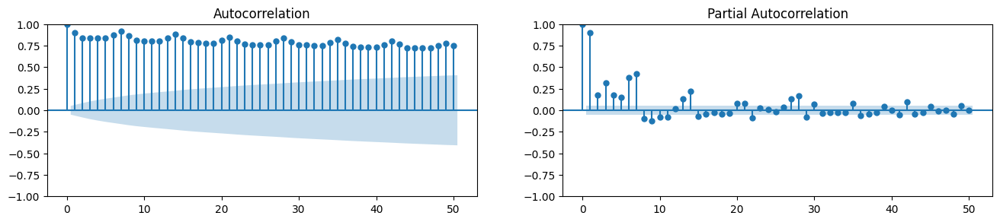

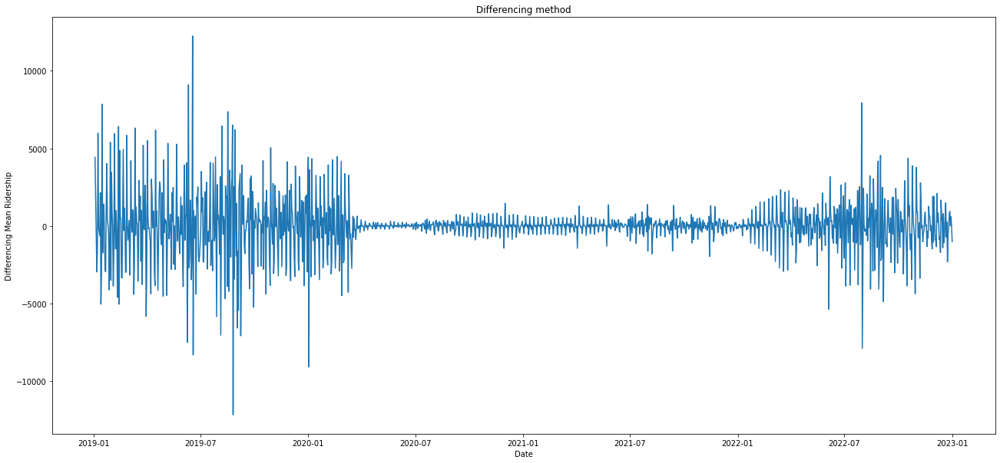

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19503.272, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19516.585, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19462.951, Time=0.10 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19239.773, Time=0.49 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19514.588, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19272.022, Time=0.27 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19234.736, Time=0.58 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19250.285, Time=0.51 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=19161.535, Time=1.64 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=19211.475, Time=1.15 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=19098.727, Time=2.82 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=19184.885, Time=2.17 sec
 ARIMA(0,1,0)(2,0,2)[6] intercept   : AIC=inf, Time=1.17 sec
 ARIMA(1,1,1)(2,0,2)[6] intercept   : AIC=inf, Time=2.32 sec
 ARIMA(0,1,2)(2,0,2)[6] interce

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore West_ALDERSHOT GO_Data ARIMA MSE Error: 12651263.94
 Metrolinx_Lakeshore West_ALDERSHOT GO_Data ARIMA  RMSE Error:  3556.86153 
 Metrolinx_Lakeshore West_ALDERSHOT GO_Data ARIMA  R square: -1.472951517
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_9 (LSTM)               (None, 100)               40800     
                                                                 
 dense_9 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1066/1066 [==============================] - 5s 4ms/step - loss: 0.0050
Epoch 2/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0044
Epoch 3/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0043
Epoch 4/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0043
Epoch 5/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0042
Epoch 6/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0039
Epoch 7/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0040
Epoch 8/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0039
Epoch 9/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0038
Epoch 10/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0039
Epoch 11/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0037
Epoch 12/100
1066/1066 [==============================] - 4s 4ms/step - loss: 0.0036
E

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore West_ALDERSHOT GO_Data LSTM MSE Error: 13807145.21
 Metrolinx_Lakeshore West_ALDERSHOT GO_Data LSTM  RMSE Error: 3715.796713 
 Metrolinx_Lakeshore West_ALDERSHOT GO_Data LSTM  R square: -1.698892447
          ds     y  trips
0 2019-01-02  3321     35
1 2019-01-03  7745     34
2 2019-01-04  9647     34
3 2019-01-05  8787     33
4 2019-01-06  5827     33
 
  ########## Cross validation for Metrolinx_Lakeshore West_ALDERSHOT GO_Data ######### 
 


17:32:29 - cmdstanpy - INFO - Chain [1] start processing
17:32:30 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:32:31 - cmdstanpy - INFO - Chain [1] start processing
17:32:31 - cmdstanpy - INFO - Chain [1] done processing
17:32:32 - cmdstanpy - INFO - Chain [1] start processing
17:32:32 - cmdstanpy - INFO - Chain [1] done processing
17:32:33 - cmdstanpy - INFO - Chain [1] start processing
17:32:34 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.650375100000019


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Lakeshore West_ALDERSHOT GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse           18930892.298948
rmse              4175.067308
mae               3819.049693
mdape                1.448795
smape                1.735109
coverage             0.172927
dtype: object
             ds  trips
0    2019-01-02     35
1    2019-01-03     34
2    2019-01-04     34
3    2019-01-05     33
4    2019-01-06     33
...         ...    ...
1456 2022-12-28     18
1457 2022-12-29     16
1458 2022-12-30     16
1459 2022-12-31     16
1460 2023-01-01     18

[1461 rows x 2 columns]

 Metrolinx_Lakeshore West_ALDERSHOT GO_Data Prophet MSE Error: 1391344.821
 Metrolinx_Lakeshore West_ALDERSHOT GO_Data Prophet  RMSE Error: 1179.552805 
 Metrolinx_Lakeshore West_ALDERSHOT GO_Data Prophet  R square: 0.7280328432
=================Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Lakeshore West_HAMILTON GO

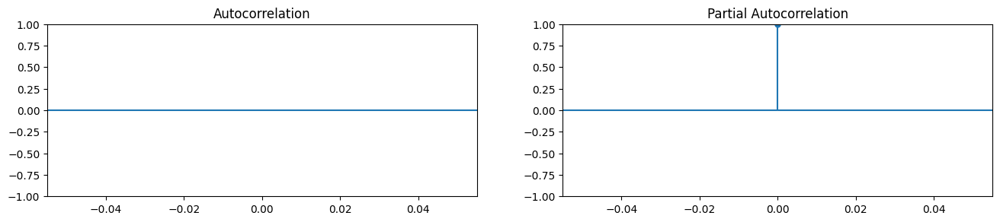

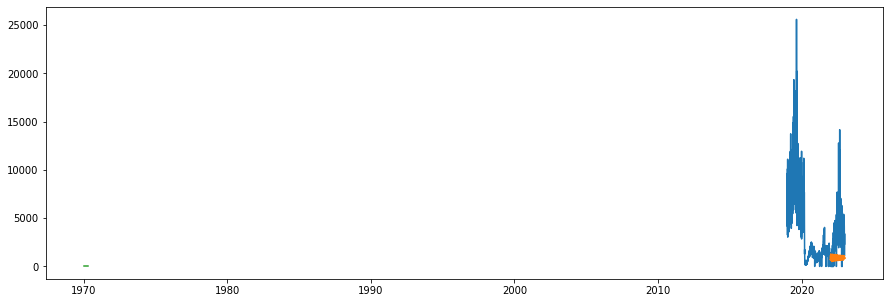

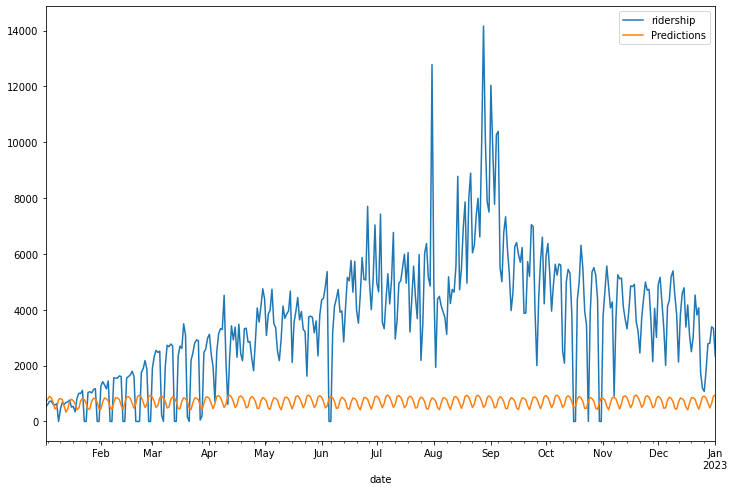

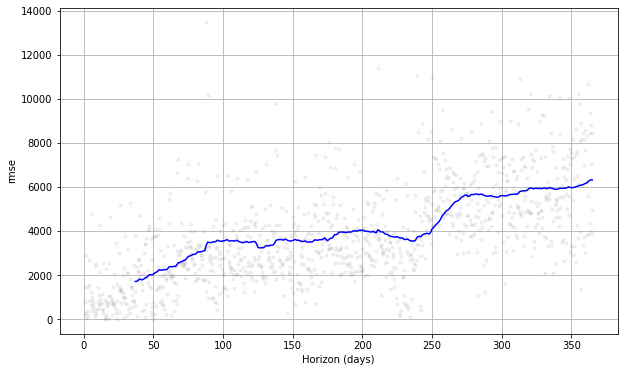

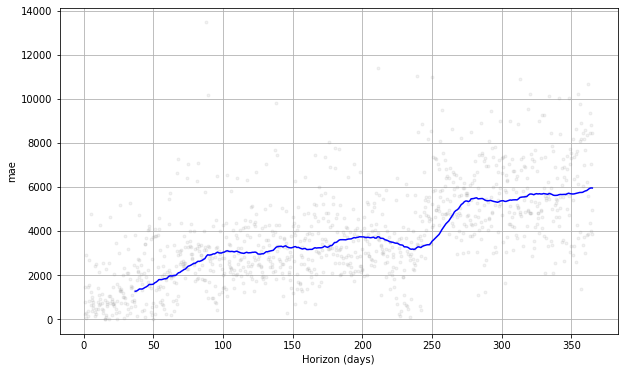

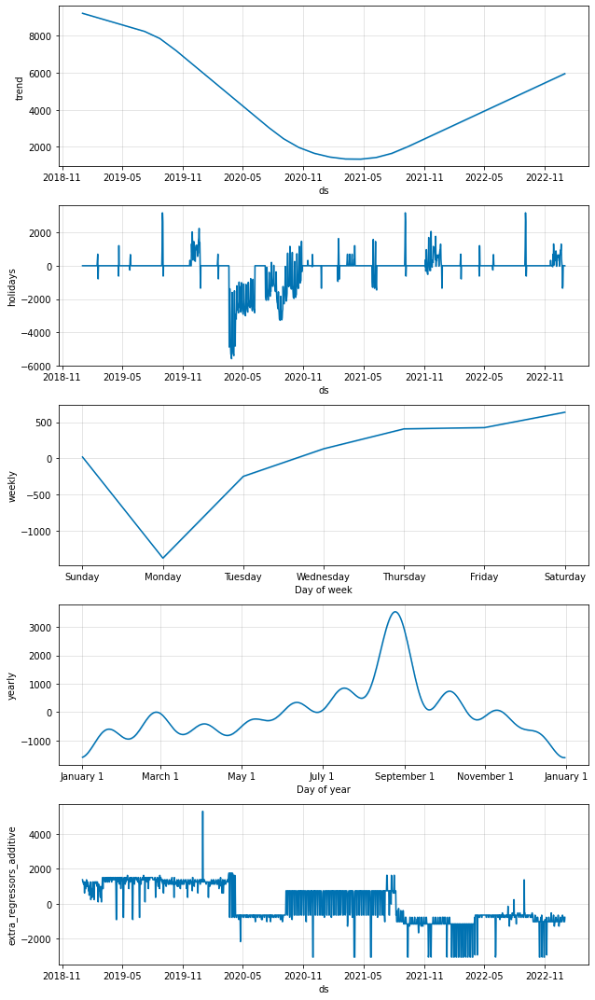

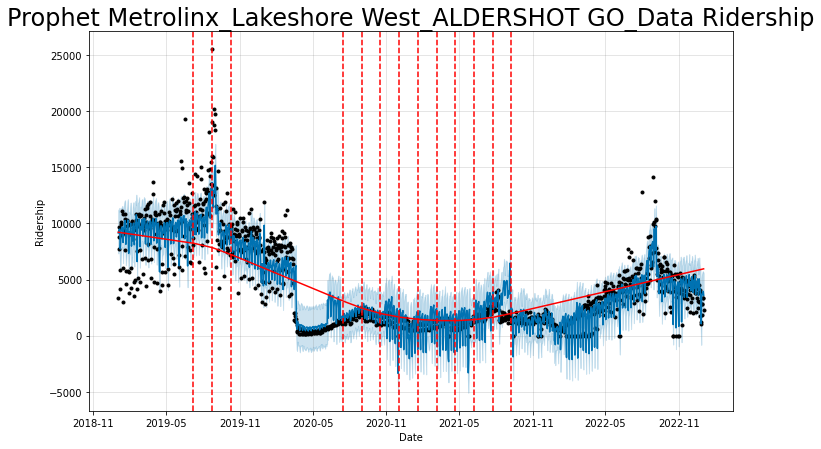

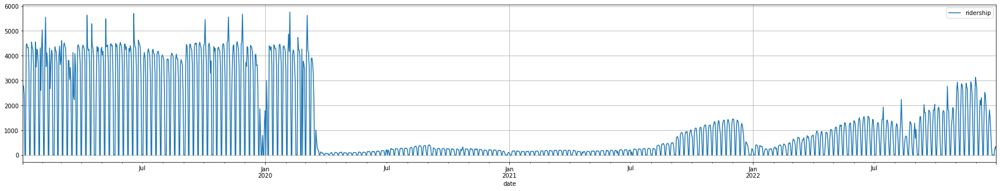

--------------
Test statistic:  -1.9075704502786883
p-value:  0.3285081559970963
Critical Values: {'1%': -3.434911997169608, '5%': -2.863554810504947, '10%': -2.567842671398422}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

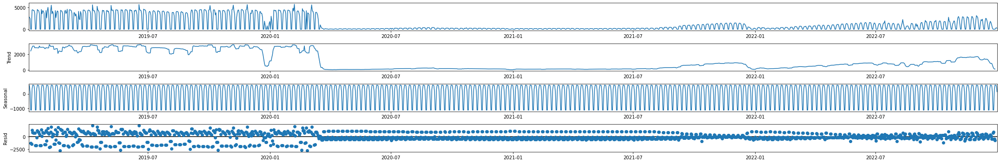

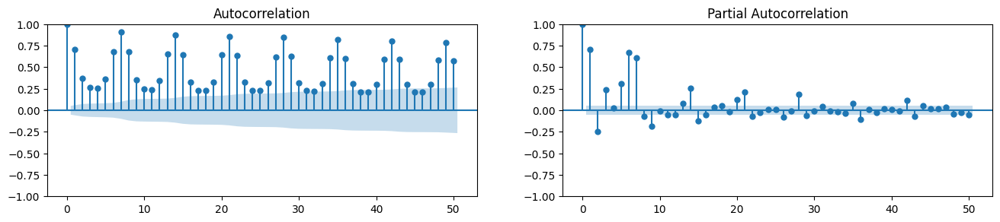

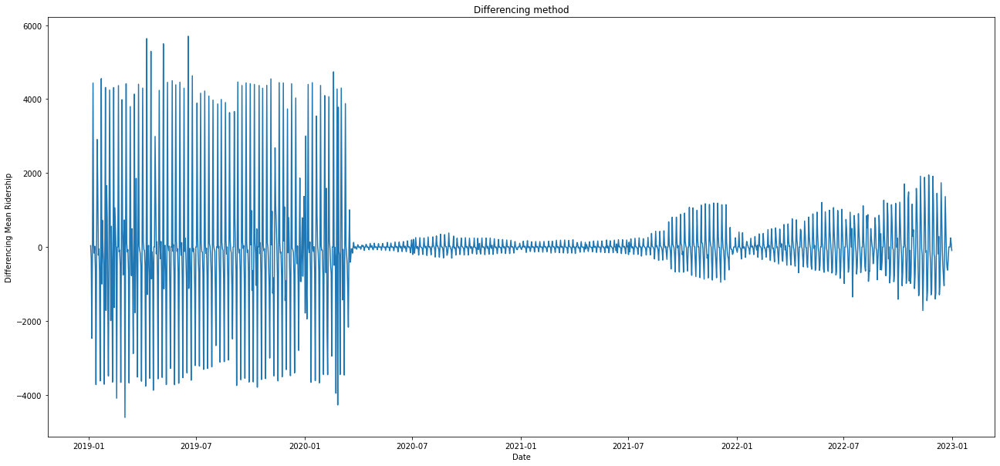

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=18759.912, Time=0.35 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=18881.646, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=18862.133, Time=0.11 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=18427.008, Time=0.48 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=18879.650, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=18876.497, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=18429.008, Time=0.85 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=18429.008, Time=1.98 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=18591.104, Time=0.53 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=18315.027, Time=2.38 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=18250.236, Time=3.29 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=18160.973, Time=1.66 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=18314.737, Time=1.47 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=18631.598, Time=0.94 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data ARIMA MSE Error: 1378594.423
 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data ARIMA  RMSE Error: 1174.135607 
 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data ARIMA  R square: -1.394277378
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 100)               40800     
                                                                 
 dense_10 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1064/1064 [==============================] - 5s 4ms/step - loss: 0.0548
Epoch 2/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0422
Epoch 3/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0284
Epoch 4/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0216
Epoch 5/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0180
Epoch 6/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0134
Epoch 7/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0114
Epoch 8/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0106
Epoch 9/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0106
Epoch 10/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0096
Epoch 11/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0094
Epoch 12/100
1064/1064 [==============================] - 4s 4ms/step - loss: 0.0093
E

<IPython.core.display.Javascript object>


 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data LSTM MSE Error: 1088855.131
 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data LSTM  RMSE Error: 1043.482214 
 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data LSTM  R square: -0.8910719241
          ds     y  trips
0 2019-01-03  2751      4
1 2019-01-04  2786      4
2 2019-01-05  2469      4
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data ######### 
 


17:40:54 - cmdstanpy - INFO - Chain [1] start processing
17:40:54 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:40:54 - cmdstanpy - INFO - Chain [1] start processing
17:40:55 - cmdstanpy - INFO - Chain [1] done processing
17:40:56 - cmdstanpy - INFO - Chain [1] start processing
17:40:56 - cmdstanpy - INFO - Chain [1] done processing
17:40:57 - cmdstanpy - INFO - Chain [1] start processing
17:40:57 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.197333500000241


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            2111286.834597
rmse              1439.409986
mae               1270.639686
mdape                2.505621
smape                1.566958
coverage             0.243877
dtype: object
             ds  trips
0    2019-01-03      4
1    2019-01-04      4
2    2019-01-05      4
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1454 2022-12-27      0
1455 2022-12-28      0
1456 2022-12-29      4
1457 2022-12-30      4
1458 2022-12-31      4

[1459 rows x 2 columns]

 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data Prophet MSE Error: 309583.2597
 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data Prophet  RMSE Error: 556.4020666 
 Metrolinx_Lakeshore West_HAMILTON GO CENTRE_Data Prophet  R square: 0.4623304849
=================Metrolinx_Kitchener_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Kitchener_UN

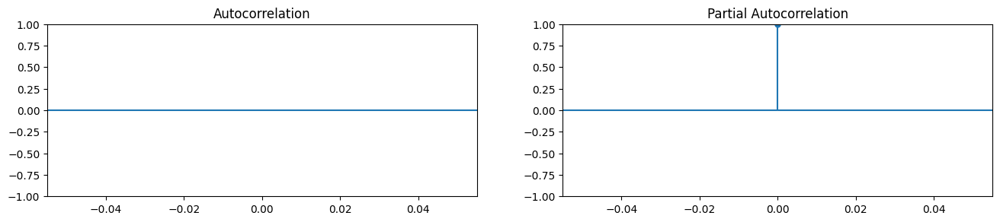

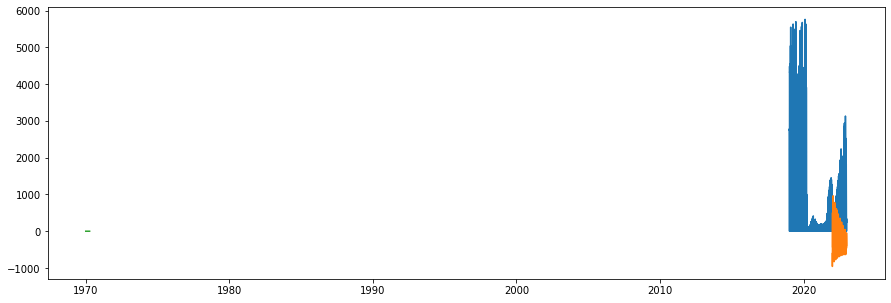

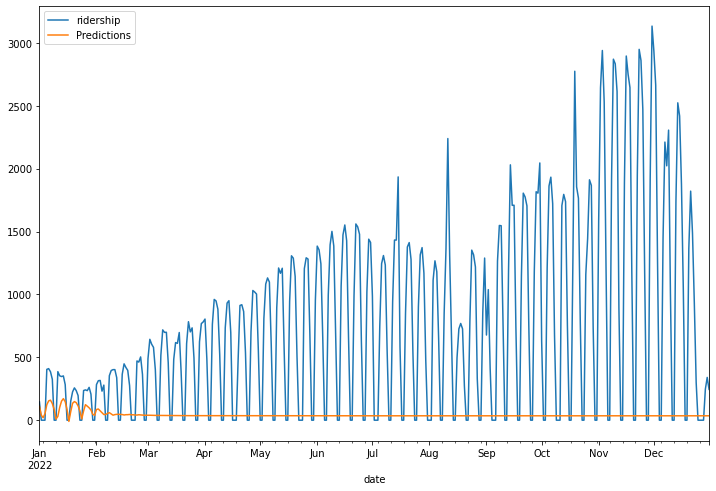

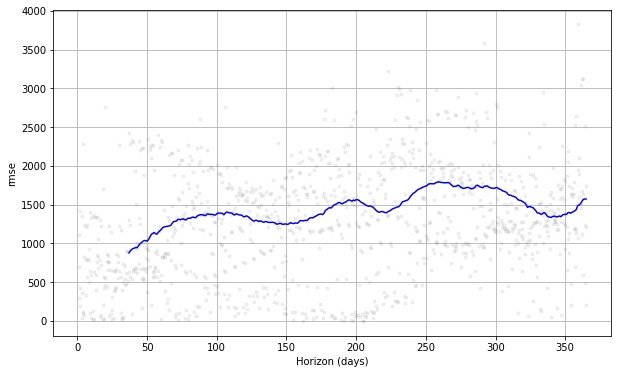

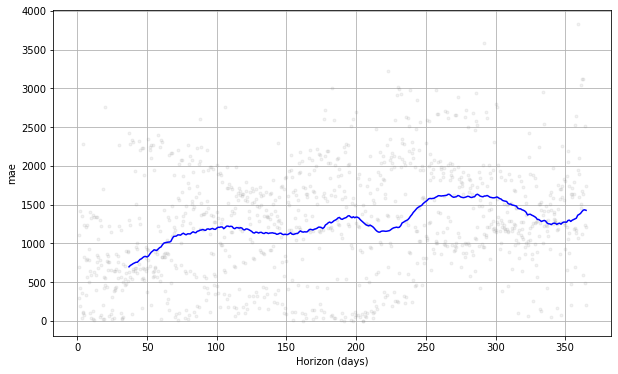

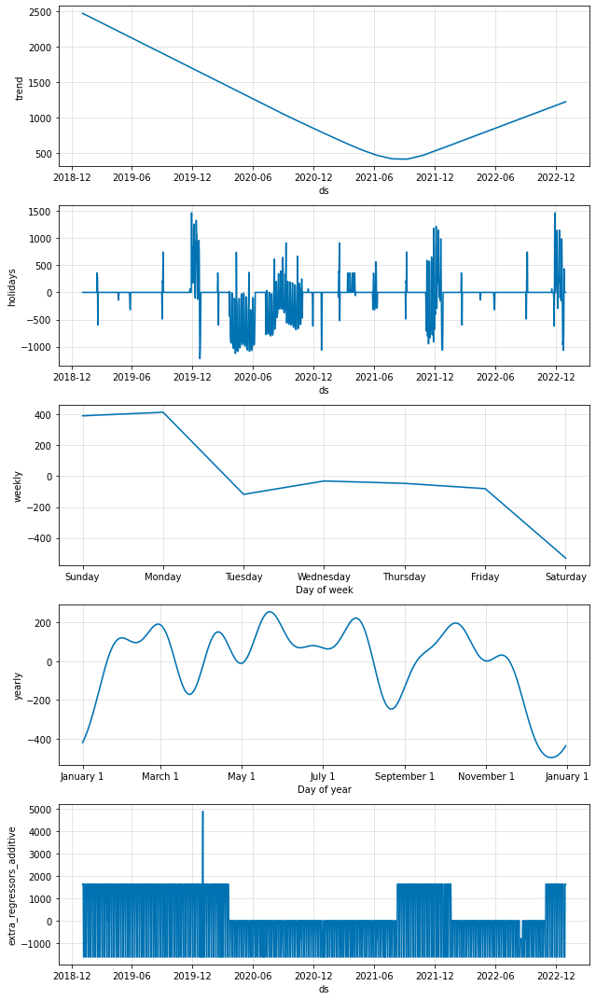

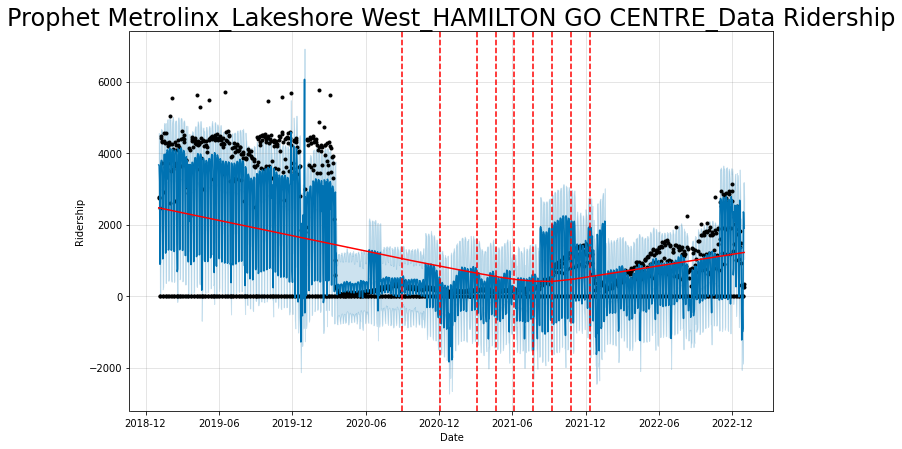

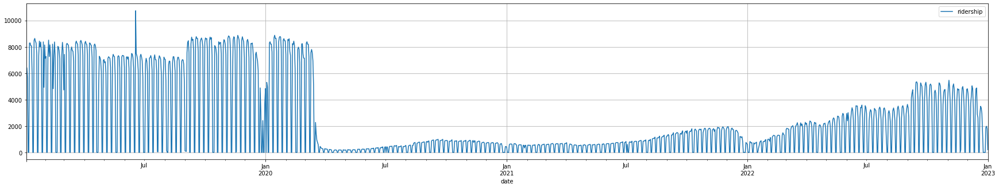

--------------
Test statistic:  -2.071415744673781
p-value:  0.2561626879461736
Critical Values: {'1%': -3.434908816804013, '5%': -2.863553406963303, '10%': -2.5678419239852994}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

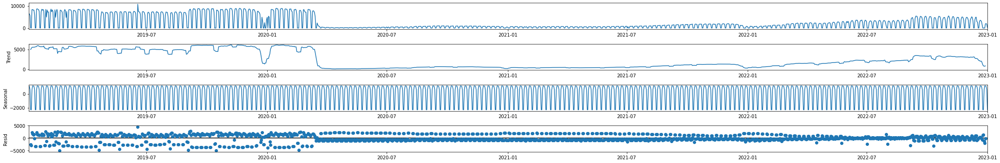

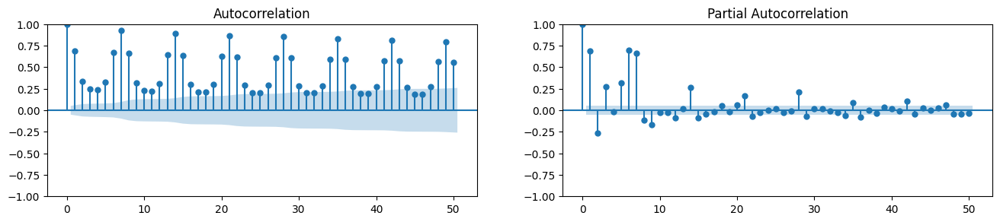

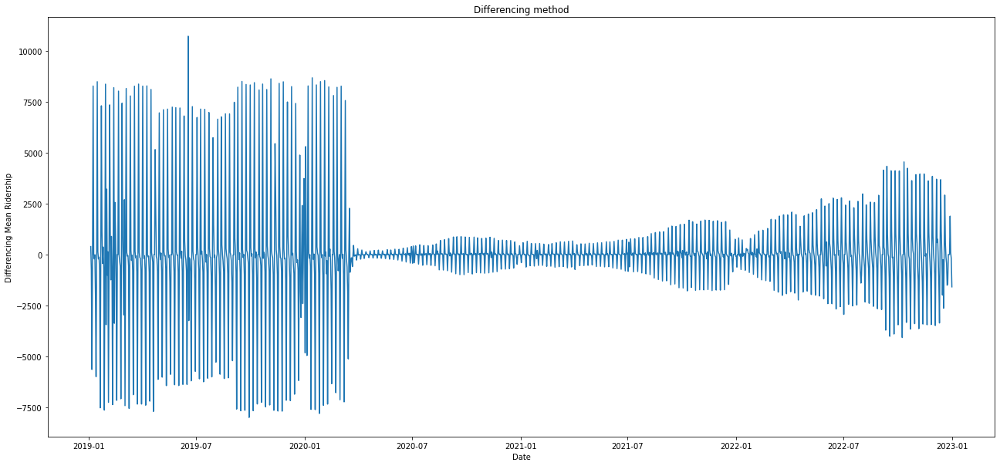

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=20106.896, Time=0.35 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=20257.064, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=20241.893, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19747.143, Time=0.68 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=20255.068, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=20246.129, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19748.683, Time=0.99 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=19748.292, Time=2.36 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19954.378, Time=0.60 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=19627.226, Time=2.65 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=19638.777, Time=2.95 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=19511.361, Time=1.81 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=19653.013, Time=1.46 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=20020.467, Time=0.79 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Kitchener_UNION STATION_Data ARIMA MSE Error: 3597639.754
 Metrolinx_Kitchener_UNION STATION_Data ARIMA  RMSE Error: 1896.744515 
 Metrolinx_Kitchener_UNION STATION_Data ARIMA  R square: -0.2473888758
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_11 (LSTM)              (None, 100)               40800     
                                                                 
 dense_11 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1065/1065 [==============================] - 5s 4ms/step - loss: 0.0543
Epoch 2/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0483
Epoch 3/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0440
Epoch 4/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0320
Epoch 5/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0190
Epoch 6/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0137
Epoch 7/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0108
Epoch 8/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0097
Epoch 9/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0084
Epoch 10/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0081
Epoch 11/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0084
Epoch 12/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0080
E

<IPython.core.display.Javascript object>


 Metrolinx_Kitchener_UNION STATION_Data LSTM MSE Error: 6772796.138
 Metrolinx_Kitchener_UNION STATION_Data LSTM  RMSE Error: 2602.459632 
 Metrolinx_Kitchener_UNION STATION_Data LSTM  R square: -1.34829253
          ds     y  trips
0 2019-01-03  6020     14
1 2019-01-04  6412     14
2 2019-01-05  5651     14
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Kitchener_UNION STATION_Data ######### 
 


17:49:27 - cmdstanpy - INFO - Chain [1] start processing
17:49:27 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:49:28 - cmdstanpy - INFO - Chain [1] start processing
17:49:28 - cmdstanpy - INFO - Chain [1] done processing
17:49:29 - cmdstanpy - INFO - Chain [1] start processing
17:49:30 - cmdstanpy - INFO - Chain [1] done processing
17:49:31 - cmdstanpy - INFO - Chain [1] start processing
17:49:31 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.415826200000083


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Kitchener_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            13822633.23599
rmse              3645.949825
mae               3210.018857
mdape                1.797264
smape                1.667121
coverage             0.338827
dtype: object
             ds  trips
0    2019-01-03     14
1    2019-01-04     14
2    2019-01-05     14
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1455 2022-12-28      0
1456 2022-12-29     24
1457 2022-12-30     24
1458 2022-12-31     24
1459 2023-01-01      2

[1460 rows x 2 columns]

 Metrolinx_Kitchener_UNION STATION_Data Prophet MSE Error: 861284.5365
 Metrolinx_Kitchener_UNION STATION_Data Prophet  RMSE Error: 928.0541668 
 Metrolinx_Kitchener_UNION STATION_Data Prophet  R square: 0.7013717817
=================Metrolinx_Kitchener_KITCHENER GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Kitchener_KITCHENER GO_Data.csv
time series loaded!
D

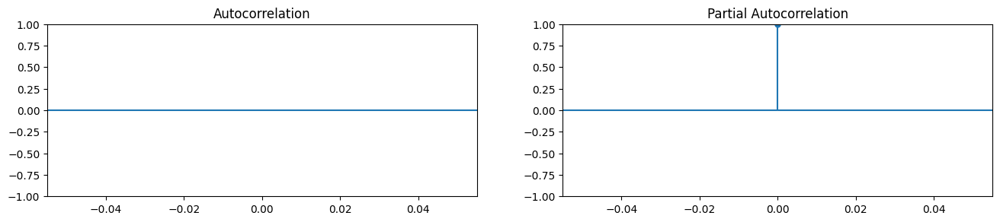

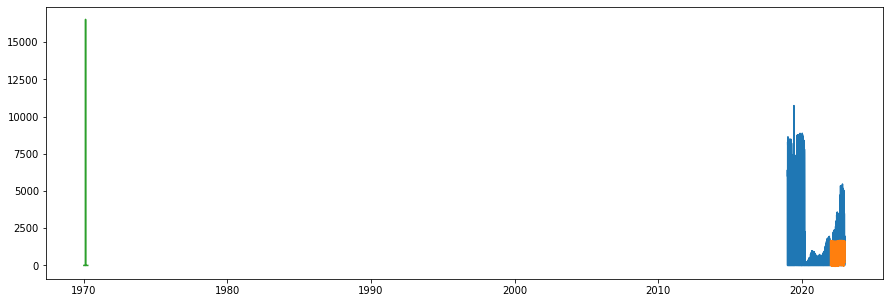

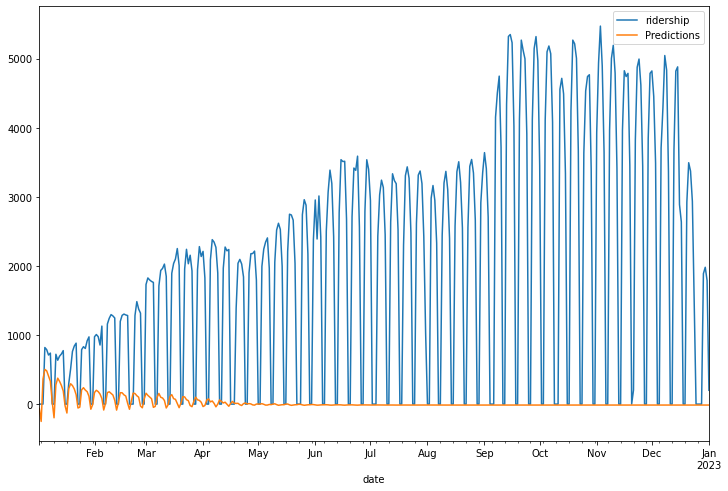

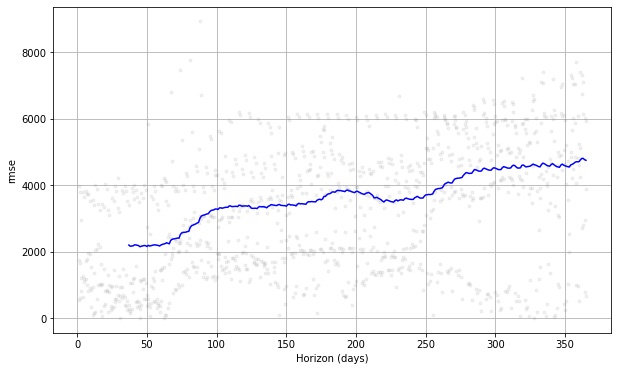

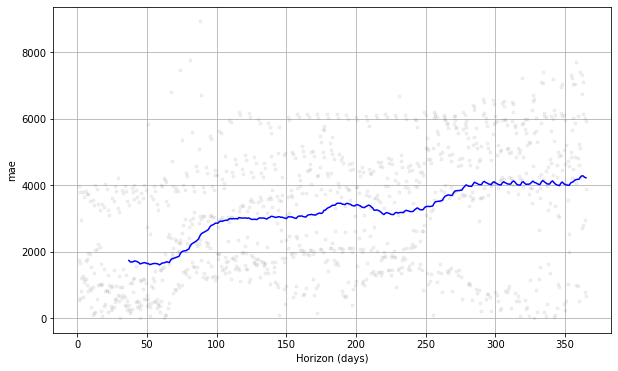

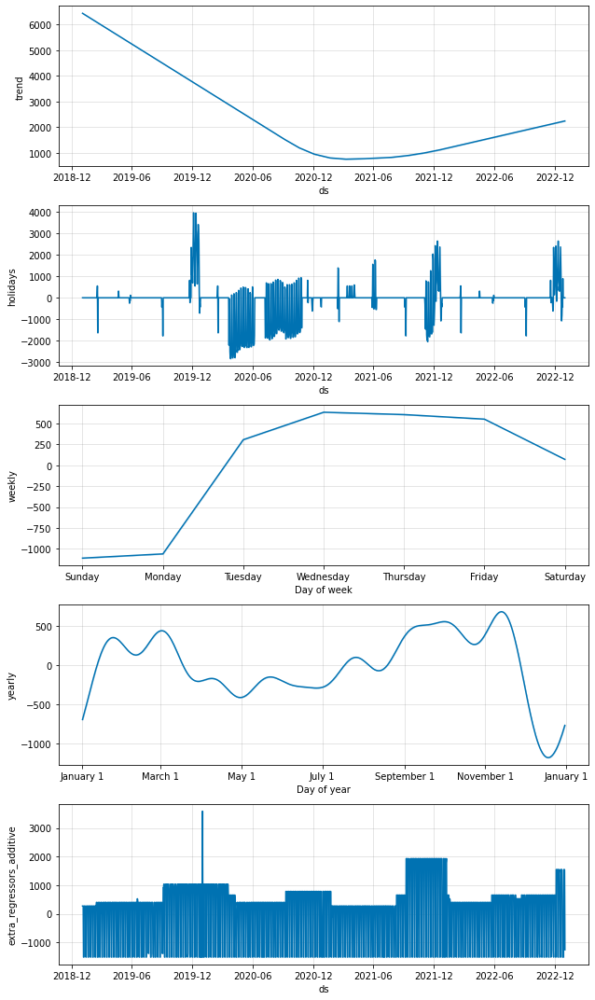

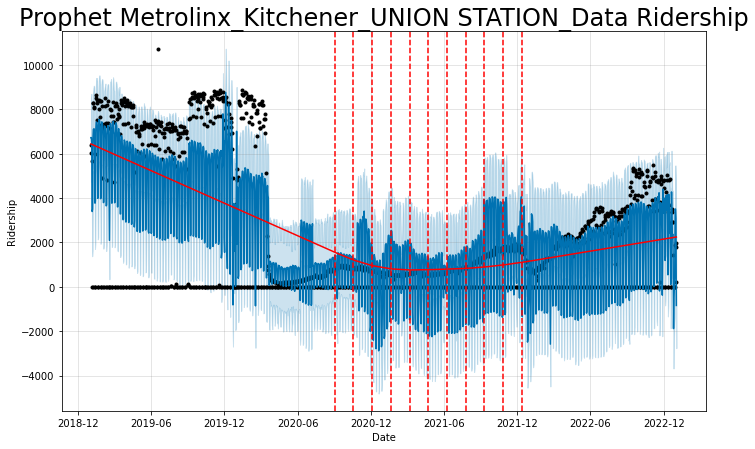

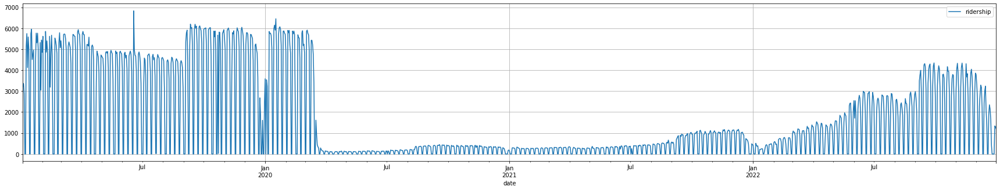

--------------
Test statistic:  -2.0596400998693563
p-value:  0.2610499839268926
Critical Values: {'1%': -3.434908816804013, '5%': -2.863553406963303, '10%': -2.5678419239852994}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

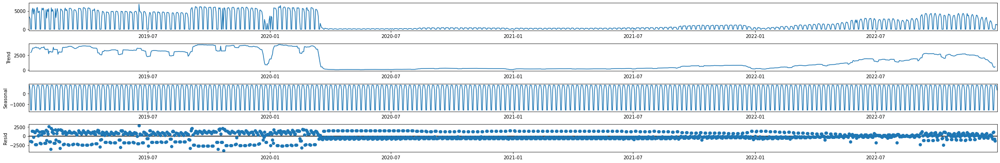

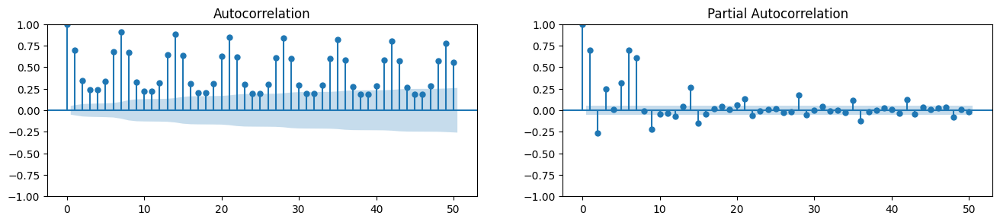

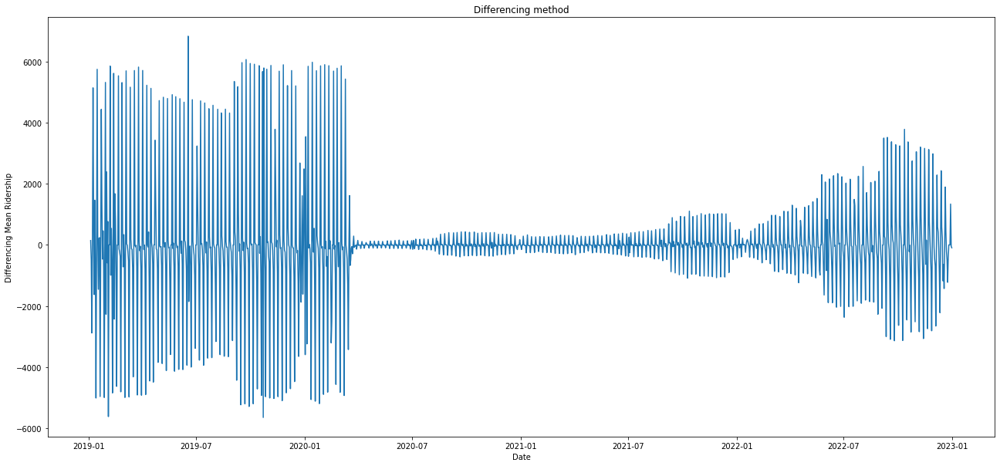

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19223.915, Time=0.31 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19377.621, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19354.143, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=18885.785, Time=0.65 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19375.624, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19372.284, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=18887.662, Time=0.96 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=18887.482, Time=2.05 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19077.945, Time=0.56 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=18768.796, Time=1.92 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=18753.961, Time=2.82 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=18669.040, Time=1.66 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=18783.691, Time=1.32 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=19151.148, Time=0.83 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Kitchener_KITCHENER GO_Data ARIMA MSE Error: 5939522.787
 Metrolinx_Kitchener_KITCHENER GO_Data ARIMA  RMSE Error: 2437.113618 
 Metrolinx_Kitchener_KITCHENER GO_Data ARIMA  R square: -2.148101187
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (None, 100)               40800     
                                                                 
 dense_12 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1064/1064 [==============================] - 6s 5ms/step - loss: 0.0625
Epoch 2/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0521
Epoch 3/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0323
Epoch 4/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0217
Epoch 5/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0186
Epoch 6/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0155
Epoch 7/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0127
Epoch 8/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0124
Epoch 9/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0110
Epoch 10/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0107
Epoch 11/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0109
Epoch 12/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0104
E

<IPython.core.display.Javascript object>


 Metrolinx_Kitchener_KITCHENER GO_Data LSTM MSE Error: 3341113.245
 Metrolinx_Kitchener_KITCHENER GO_Data LSTM  RMSE Error: 1827.871233 
 Metrolinx_Kitchener_KITCHENER GO_Data LSTM  R square: -0.7708767104
          ds     y  trips
0 2019-01-03  3221      4
1 2019-01-04  3365      4
2 2019-01-05  2879      4
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Kitchener_KITCHENER GO_Data ######### 
 


17:58:37 - cmdstanpy - INFO - Chain [1] start processing
17:58:38 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

17:58:39 - cmdstanpy - INFO - Chain [1] start processing
17:58:39 - cmdstanpy - INFO - Chain [1] done processing
17:58:40 - cmdstanpy - INFO - Chain [1] start processing
17:58:41 - cmdstanpy - INFO - Chain [1] done processing
17:58:42 - cmdstanpy - INFO - Chain [1] start processing
17:58:42 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  6.405299000000014


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Kitchener_KITCHENER GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            4672639.552511
rmse              2115.681621
mae               1859.079386
mdape                2.193989
smape                1.519568
coverage             0.304407
dtype: object
             ds  trips
0    2019-01-03      4
1    2019-01-04      4
2    2019-01-05      4
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1454 2022-12-27      0
1455 2022-12-28      0
1456 2022-12-29      8
1457 2022-12-30      8
1458 2022-12-31      8

[1459 rows x 2 columns]

 Metrolinx_Kitchener_KITCHENER GO_Data Prophet MSE Error: 428634.4902
 Metrolinx_Kitchener_KITCHENER GO_Data Prophet  RMSE Error:  654.701833 
 Metrolinx_Kitchener_KITCHENER GO_Data Prophet  R square: 0.7728125986
=================Metrolinx_Kitchener_MOUNT PLEASANT GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Kitchener_MOUNT PLEASANT GO_Data.csv
time series loa

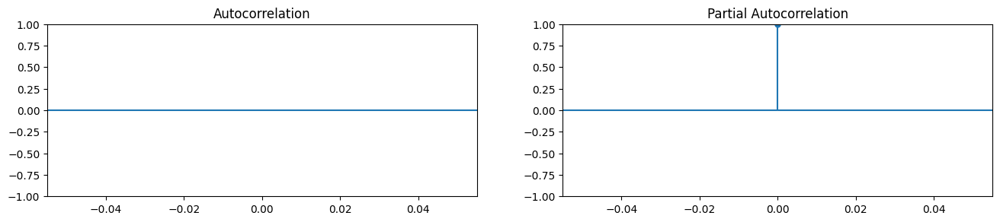

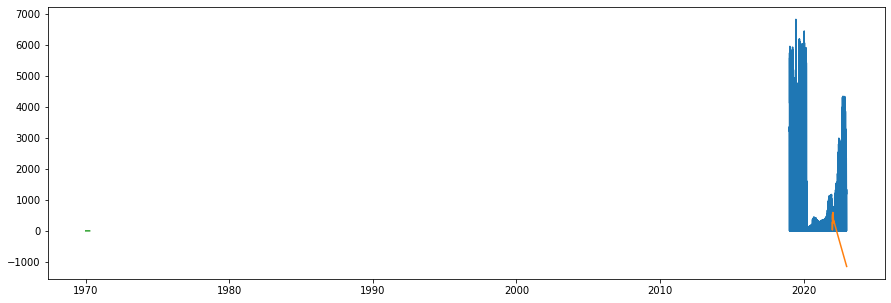

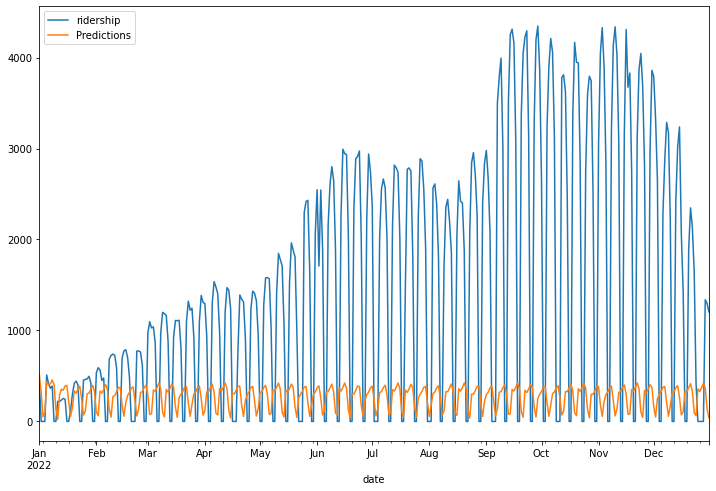

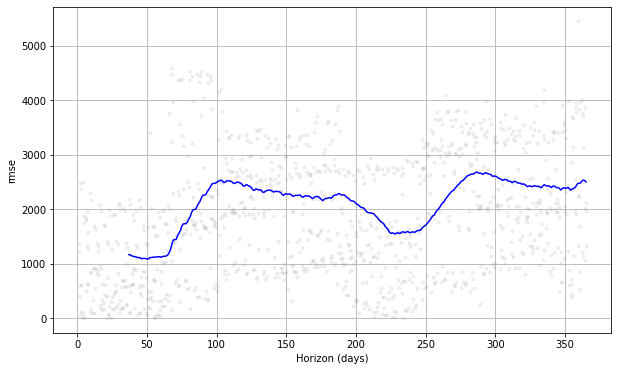

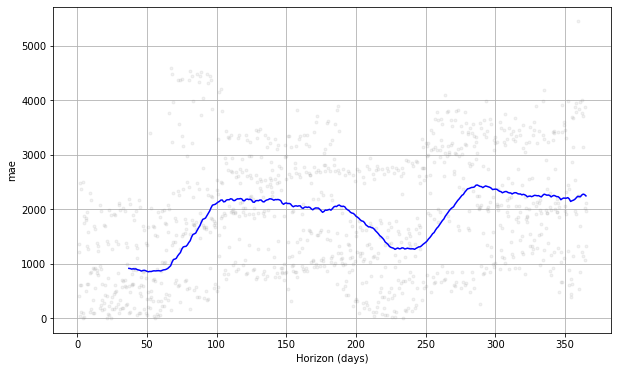

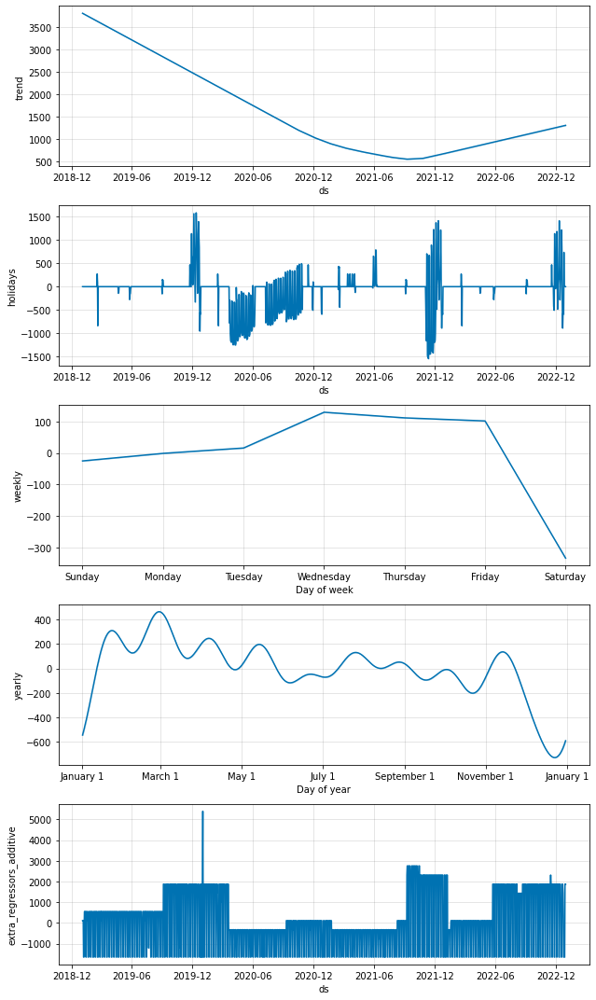

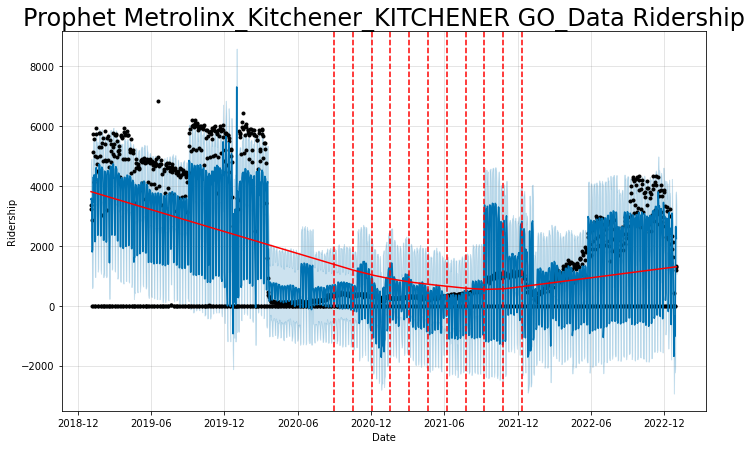

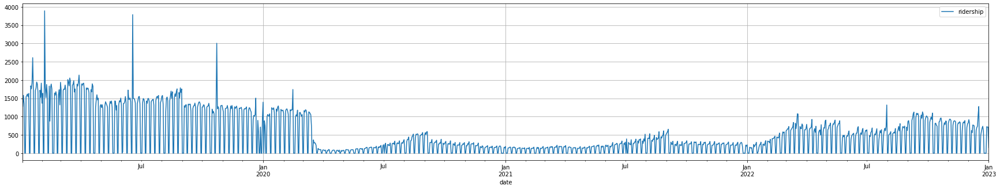

--------------
Test statistic:  -2.333156962959321
p-value:  0.1614970300713811
Critical Values: {'1%': -3.434908816804013, '5%': -2.863553406963303, '10%': -2.5678419239852994}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

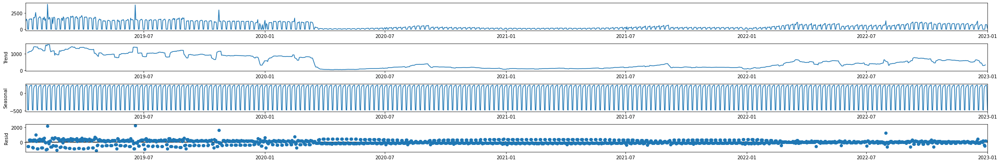

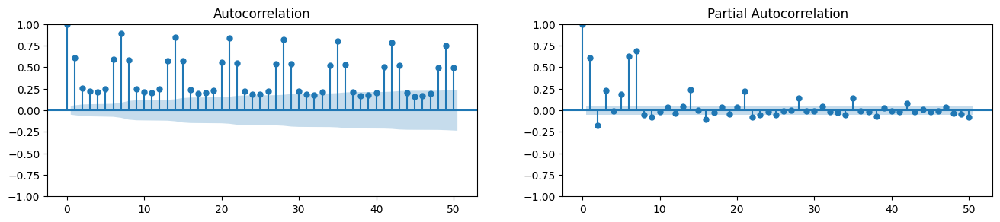

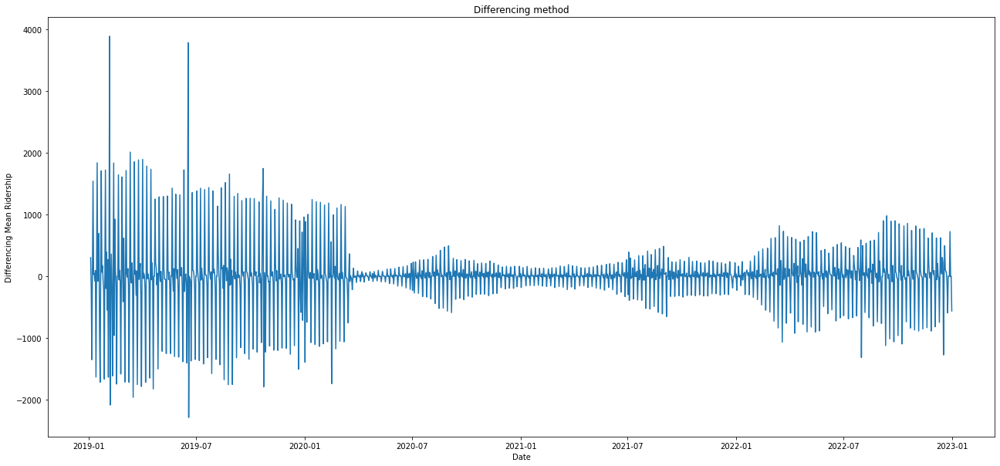

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=16774.329, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=16853.361, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=16844.879, Time=0.28 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=16333.280, Time=0.56 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=16851.365, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=16574.136, Time=0.16 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=16329.150, Time=0.73 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=16460.492, Time=0.50 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=16140.779, Time=1.52 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=16254.763, Time=1.13 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=16339.591, Time=2.92 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=16215.270, Time=1.92 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=16673.260, Time=0.79 sec
 ARIMA(1,1,1)(2,0,1)[6] intercept   : AIC=16141.458, Time=1.83 sec
 ARIMA(0,1,2)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data ARIMA MSE Error: 416834.7958
 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data ARIMA  RMSE Error: 645.6274435 
 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data ARIMA  R square: -2.181842534
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_13 (LSTM)              (None, 100)               40800     
                                                                 
 dense_13 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1065/1065 [==============================] - 5s 4ms/step - loss: 0.0156
Epoch 2/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0136
Epoch 3/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0939
Epoch 4/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0139
Epoch 5/100
1065/1065 [==============================] - 5s 4ms/step - loss: 0.0132
Epoch 6/100
1065/1065 [==============================] - 4s 4ms/step - loss: 0.0169
Epoch 7/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0133
Epoch 8/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0133
Epoch 9/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0131
Epoch 10/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0127
Epoch 11/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0125
Epoch 12/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0115
E

<IPython.core.display.Javascript object>


 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data LSTM MSE Error: 250116.7373
 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data LSTM  RMSE Error: 500.1167237 
 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data LSTM  R square: -0.9092265839
          ds     y  trips
0 2019-01-03  1280      9
1 2019-01-04  1581      9
2 2019-01-05  1353      9
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Kitchener_MOUNT PLEASANT GO_Data ######### 
 


18:08:15 - cmdstanpy - INFO - Chain [1] start processing
18:08:16 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

18:08:17 - cmdstanpy - INFO - Chain [1] start processing
18:08:17 - cmdstanpy - INFO - Chain [1] done processing
18:08:18 - cmdstanpy - INFO - Chain [1] start processing
18:08:18 - cmdstanpy - INFO - Chain [1] done processing
18:08:19 - cmdstanpy - INFO - Chain [1] start processing
18:08:20 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.644526699999915


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Kitchener_MOUNT PLEASANT GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse             386439.658466
rmse               608.391662
mae                519.015282
mdape                1.580368
smape                1.477632
coverage             0.410121
dtype: object
             ds  trips
0    2019-01-03      9
1    2019-01-04      9
2    2019-01-05      9
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1455 2022-12-28      0
1456 2022-12-29      6
1457 2022-12-30      6
1458 2022-12-31      6
1459 2023-01-01      1

[1460 rows x 2 columns]

 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data Prophet MSE Error: 28303.51396
 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data Prophet  RMSE Error: 168.2364823 
 Metrolinx_Kitchener_MOUNT PLEASANT GO_Data Prophet  R square: 0.7839495995
=================Metrolinx_Milton_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Milton_UNION STATION_Data.csv
time seri

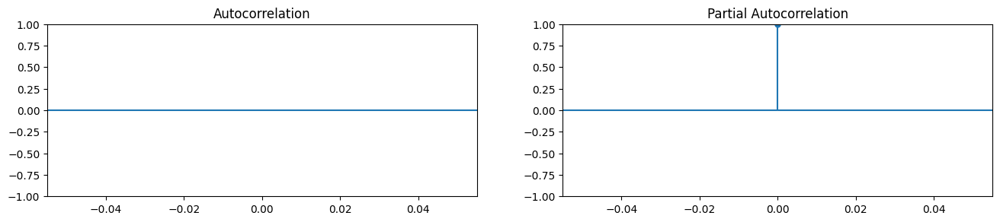

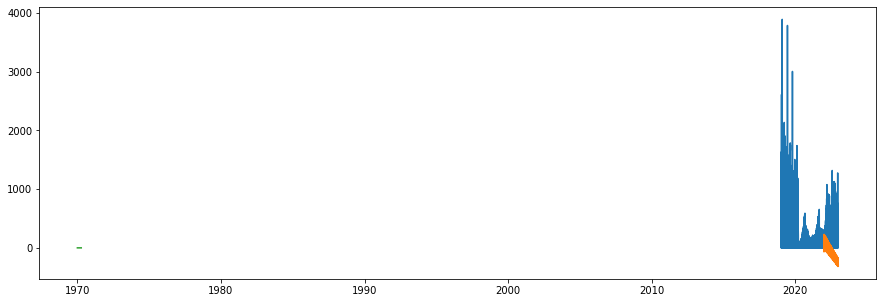

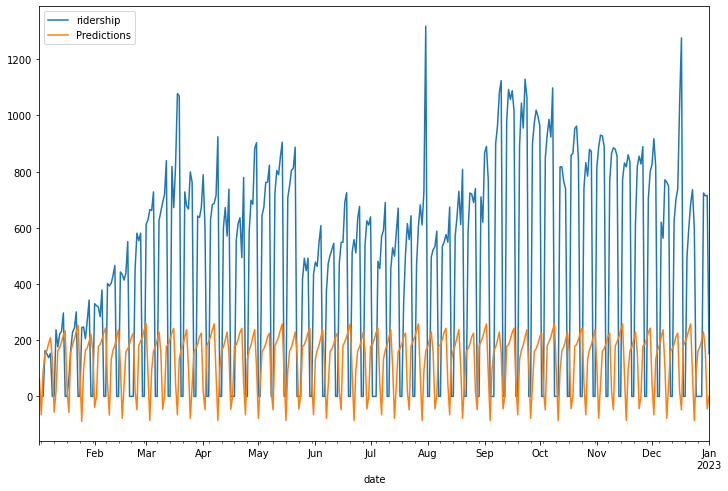

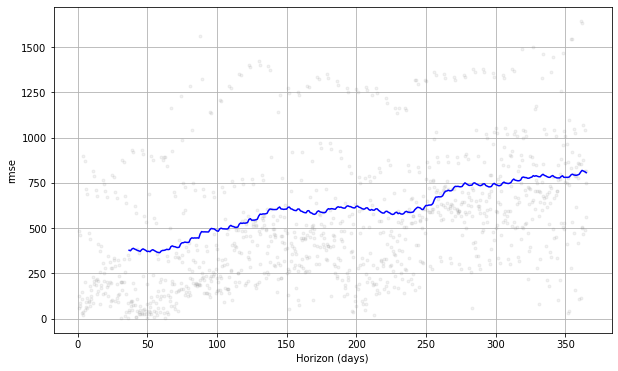

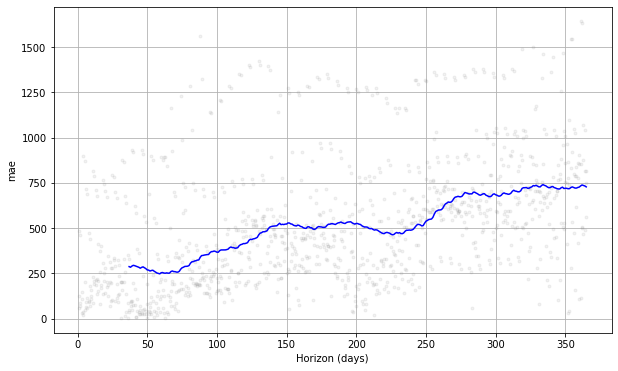

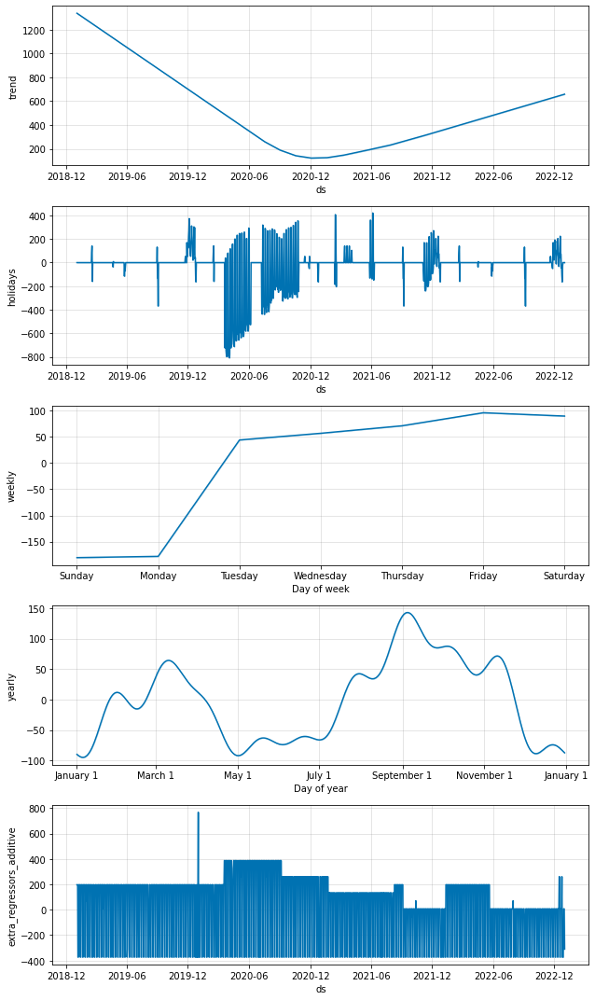

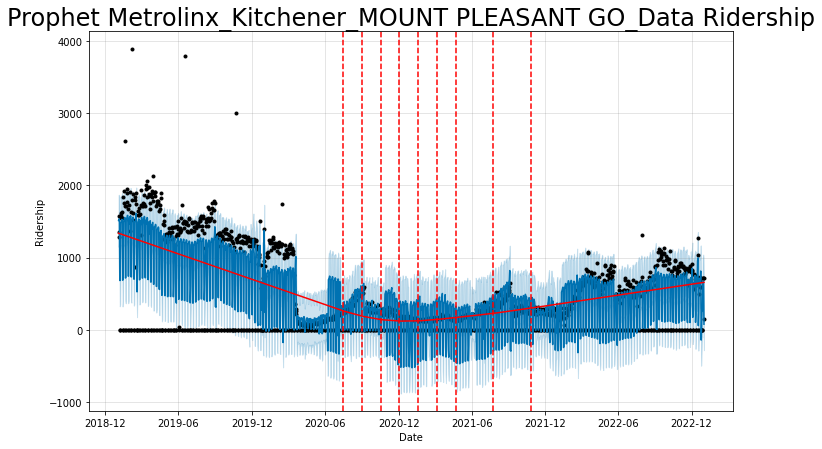

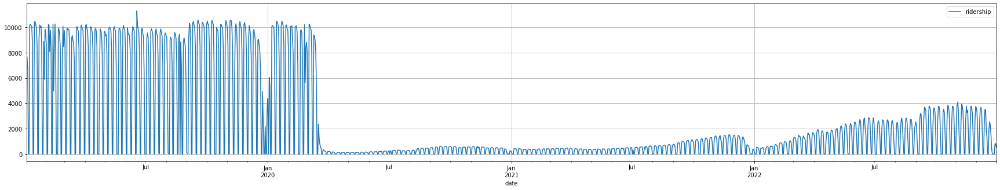

--------------
Test statistic:  -1.9815053773824545
p-value:  0.29474075472443795
Critical Values: {'1%': -3.434911997169608, '5%': -2.863554810504947, '10%': -2.567842671398422}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

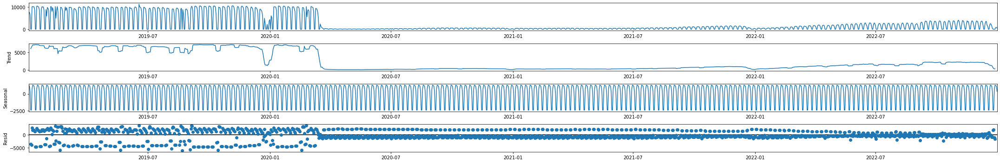

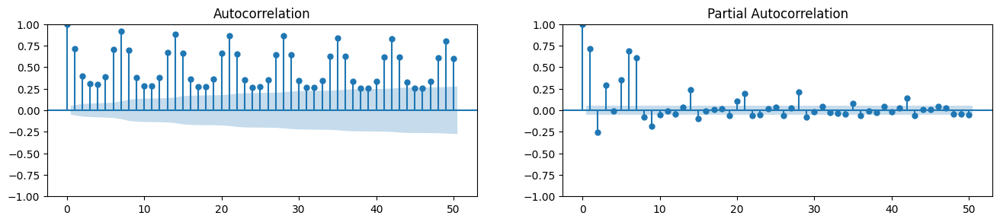

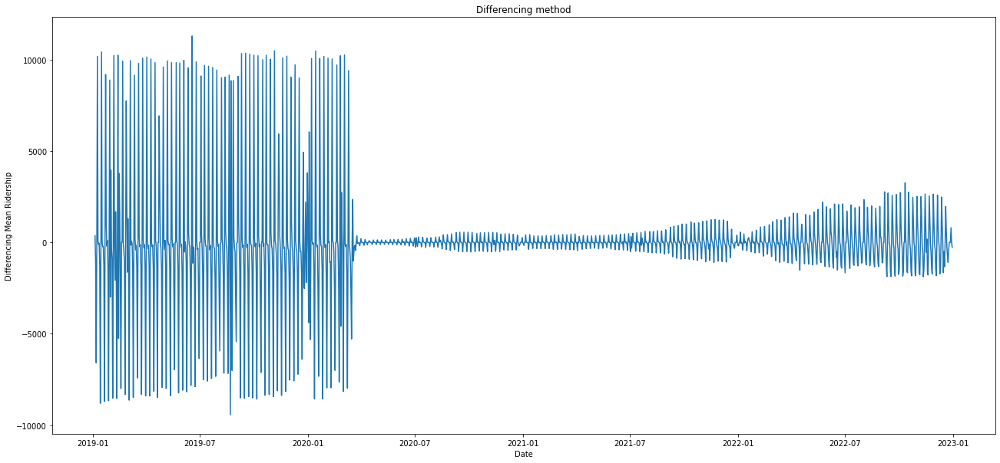

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=20509.031, Time=0.34 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=20645.505, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=20621.554, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=20179.566, Time=0.59 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=20643.510, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=20625.294, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=20181.291, Time=0.98 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=20180.823, Time=2.16 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=20620.200, Time=0.17 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=20076.691, Time=2.27 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=20020.126, Time=2.63 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=19920.920, Time=1.65 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=20065.708, Time=1.31 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=20419.881, Time=0.92 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Milton_UNION STATION_Data ARIMA MSE Error: 1818460.487
 Metrolinx_Milton_UNION STATION_Data ARIMA  RMSE Error: 1348.503054 
 Metrolinx_Milton_UNION STATION_Data ARIMA  R square: -0.2056134299
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_14 (LSTM)              (None, 100)               40800     
                                                                 
 dense_14 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1064/1064 [==============================] - 5s 4ms/step - loss: 0.0727
Epoch 2/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0645
Epoch 3/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0564
Epoch 4/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0344
Epoch 5/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0243
Epoch 6/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0169
Epoch 7/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0157
Epoch 8/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0128
Epoch 9/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0123
Epoch 10/100
1064/1064 [==============================] - 5s 4ms/step - loss: 0.0129
Epoch 11/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0118
Epoch 12/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0117
E

<IPython.core.display.Javascript object>


 Metrolinx_Milton_UNION STATION_Data LSTM MSE Error: 3419330.941
 Metrolinx_Milton_UNION STATION_Data LSTM  RMSE Error: 1849.143299 
 Metrolinx_Milton_UNION STATION_Data LSTM  R square: -1.266967764
          ds     y  trips
0 2019-01-03  7296     10
1 2019-01-04  7662     10
2 2019-01-05  6591     10
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Milton_UNION STATION_Data ######### 
 


18:17:27 - cmdstanpy - INFO - Chain [1] start processing
18:17:28 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

18:17:28 - cmdstanpy - INFO - Chain [1] start processing
18:17:28 - cmdstanpy - INFO - Chain [1] done processing
18:17:29 - cmdstanpy - INFO - Chain [1] start processing
18:17:30 - cmdstanpy - INFO - Chain [1] done processing
18:17:31 - cmdstanpy - INFO - Chain [1] start processing
18:17:31 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.298198300000877


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Milton_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse           10999985.351668
rmse              3233.406031
mae               2830.341322
mdape                3.307929
smape                1.659631
coverage             0.261222
dtype: object
             ds  trips
0    2019-01-03     10
1    2019-01-04     10
2    2019-01-05     10
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1454 2022-12-27      0
1455 2022-12-28      0
1456 2022-12-29      6
1457 2022-12-30      6
1458 2022-12-31      6

[1459 rows x 2 columns]

 Metrolinx_Milton_UNION STATION_Data Prophet MSE Error: 878826.8832
 Metrolinx_Milton_UNION STATION_Data Prophet  RMSE Error: 937.4576701 
 Metrolinx_Milton_UNION STATION_Data Prophet  R square: 0.4173502804
=================Metrolinx_Milton_MILTON GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Milton_MILTON GO_Data.csv
time series loaded!
Data All: 
              

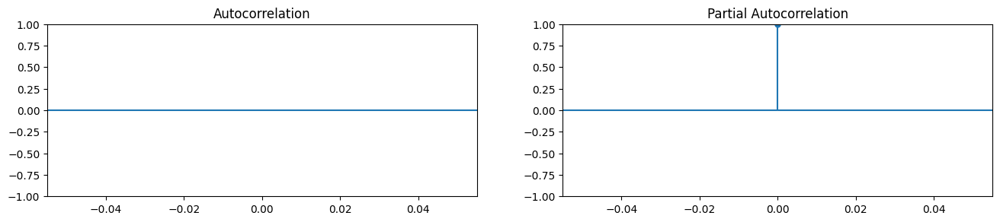

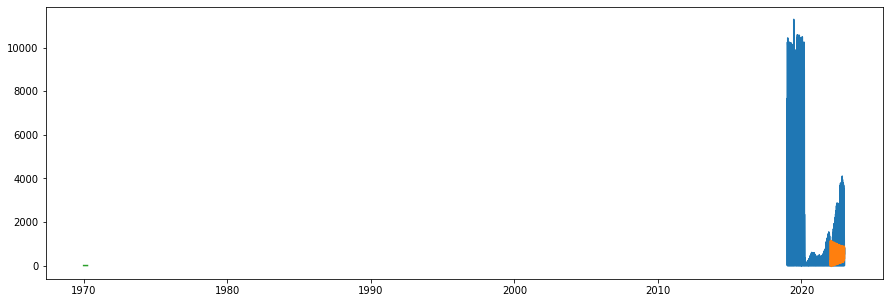

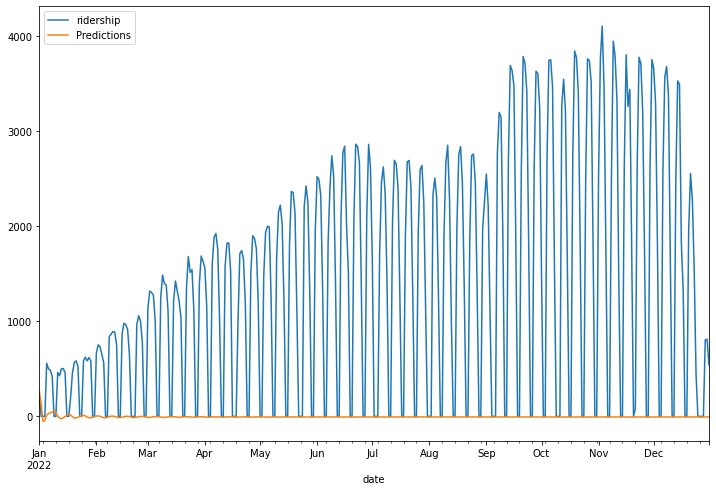

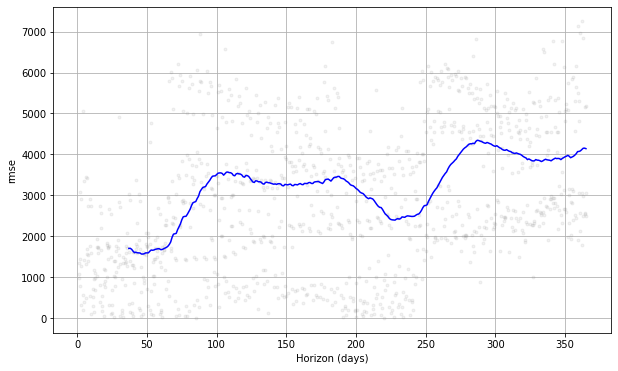

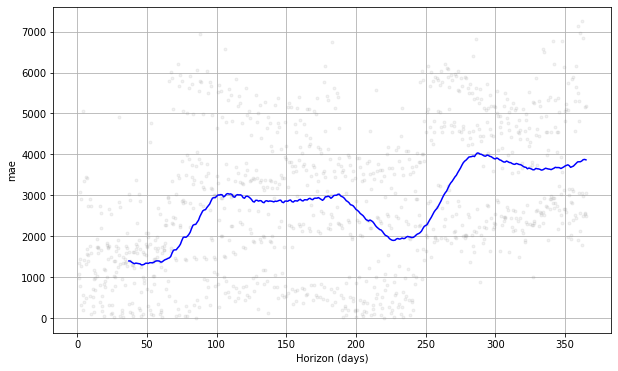

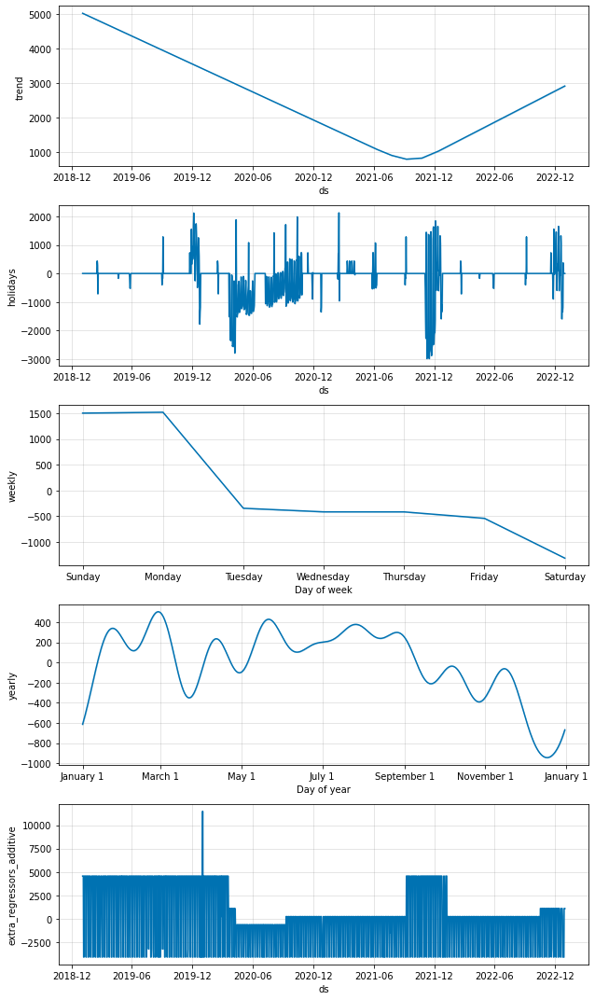

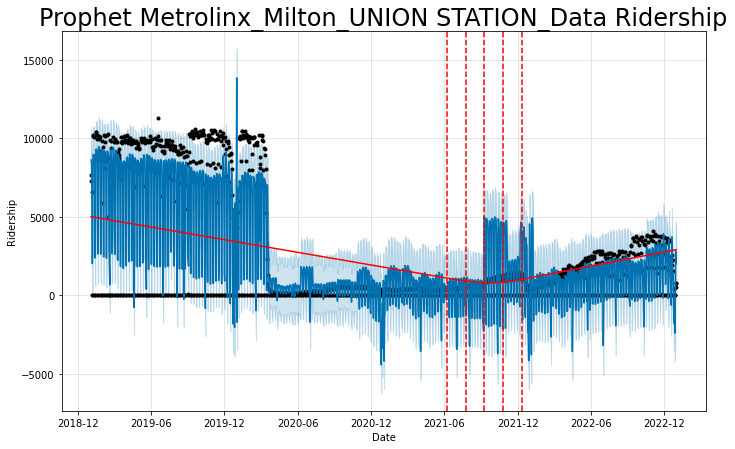

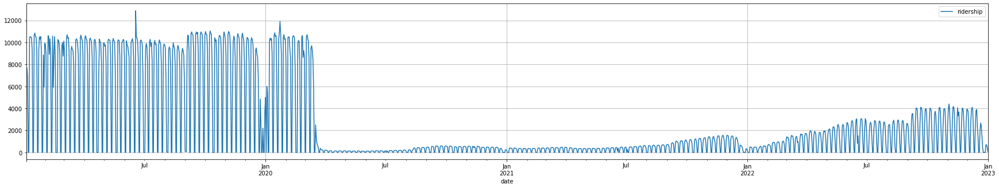

--------------
Test statistic:  -1.9570185029217027
p-value:  0.30573094828542036
Critical Values: {'1%': -3.434908816804013, '5%': -2.863553406963303, '10%': -2.5678419239852994}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

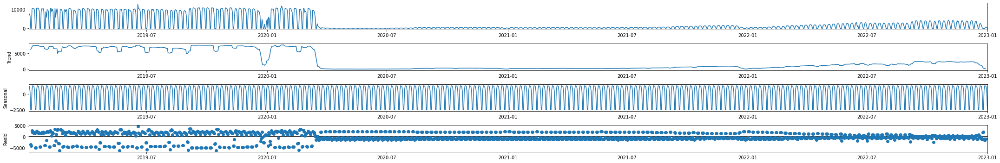

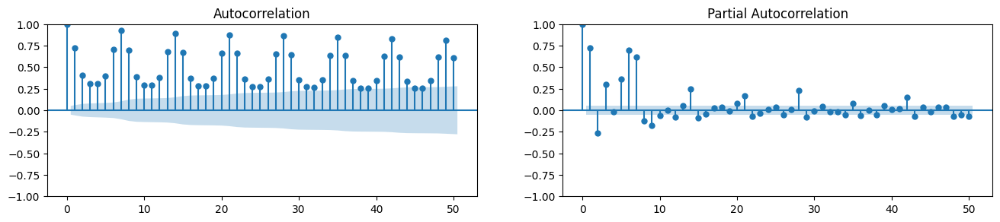

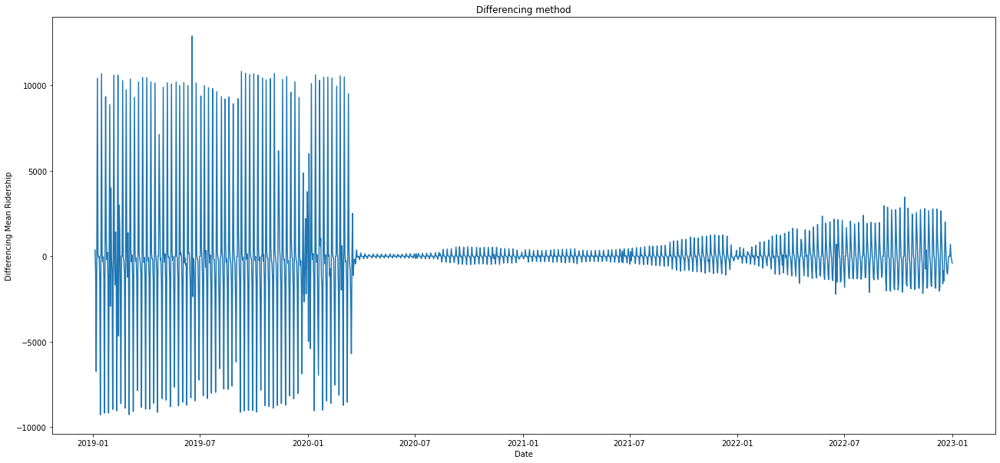

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=20584.352, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=20735.846, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=20710.172, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=20245.648, Time=0.78 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=20733.852, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=20704.428, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=20248.335, Time=1.06 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=20469.932, Time=0.41 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=20702.694, Time=0.17 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=20132.539, Time=2.34 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=20095.540, Time=2.76 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=20010.664, Time=1.69 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=20134.974, Time=1.32 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=20509.342, Time=0.49 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Milton_MILTON GO_Data ARIMA MSE Error:  2189601.27
 Metrolinx_Milton_MILTON GO_Data ARIMA  RMSE Error: 1479.730134 
 Metrolinx_Milton_MILTON GO_Data ARIMA  R square: -0.2503147977
Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_15 (LSTM)              (None, 100)               40800     
                                                                 
 dense_15 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1065/1065 [==============================] - 6s 5ms/step - loss: 0.0576
Epoch 2/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0487
Epoch 3/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0435
Epoch 4/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0267
Epoch 5/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0223
Epoch 6/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0193
Epoch 7/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0168
Epoch 8/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0196
Epoch 9/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0136
Epoch 10/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0114
Epoch 11/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0096
Epoch 12/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0095
E

<IPython.core.display.Javascript object>


 Metrolinx_Milton_MILTON GO_Data LSTM MSE Error: 2983731.432
 Metrolinx_Milton_MILTON GO_Data LSTM  RMSE Error: 1727.348092 
 Metrolinx_Milton_MILTON GO_Data LSTM  R square: -0.7037821513
          ds     y  trips
0 2019-01-03  7304     10
1 2019-01-04  7665     10
2 2019-01-05  6737     10
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Milton_MILTON GO_Data ######### 
 


18:27:11 - cmdstanpy - INFO - Chain [1] start processing
18:27:12 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

18:27:12 - cmdstanpy - INFO - Chain [1] start processing
18:27:13 - cmdstanpy - INFO - Chain [1] done processing
18:27:14 - cmdstanpy - INFO - Chain [1] start processing
18:27:14 - cmdstanpy - INFO - Chain [1] done processing
18:27:15 - cmdstanpy - INFO - Chain [1] start processing
18:27:16 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.616625799999383


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Milton_MILTON GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse           12176781.793722
rmse              3406.622697
mae               2977.250683
mdape                3.338776
smape                1.663943
coverage             0.280463
dtype: object
             ds  trips
0    2019-01-03     10
1    2019-01-04     10
2    2019-01-05     10
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1455 2022-12-28      0
1456 2022-12-29      6
1457 2022-12-30      6
1458 2022-12-31      6
1459 2023-01-01      2

[1460 rows x 2 columns]

 Metrolinx_Milton_MILTON GO_Data Prophet MSE Error: 1040368.943
 Metrolinx_Milton_MILTON GO_Data Prophet  RMSE Error: 1019.984776 
 Metrolinx_Milton_MILTON GO_Data Prophet  R square: 0.4059244019
=================Metrolinx_Richmond Hill_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Richmond Hill_UNION STATION_Data.csv
time series loaded!
Data All: 
        

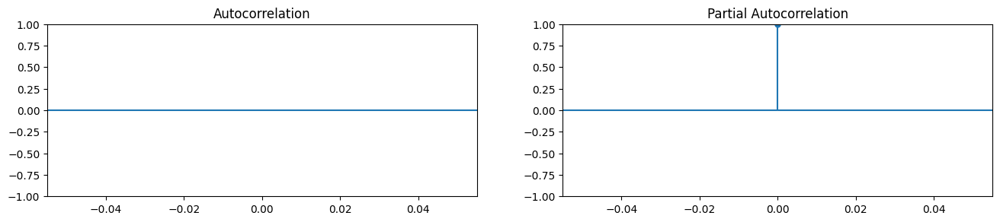

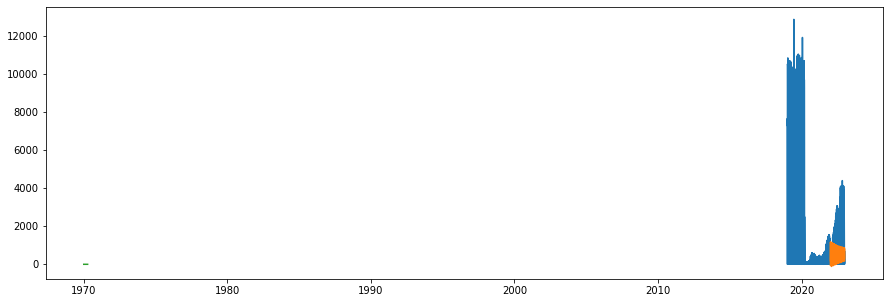

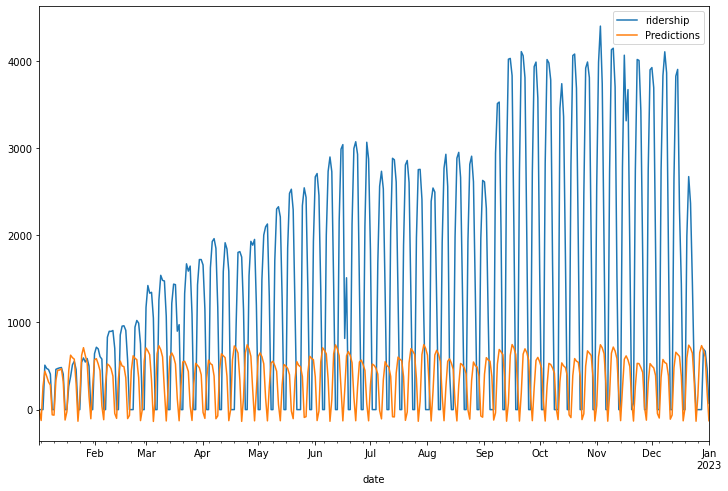

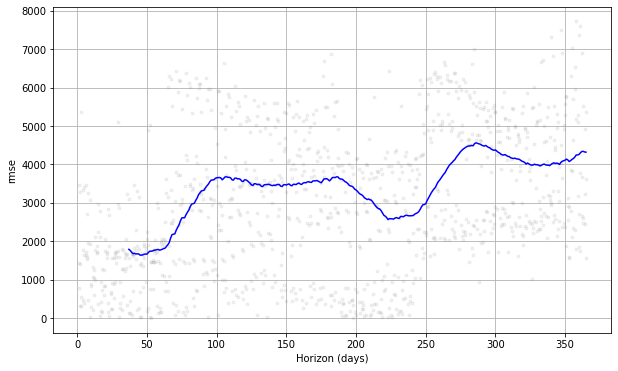

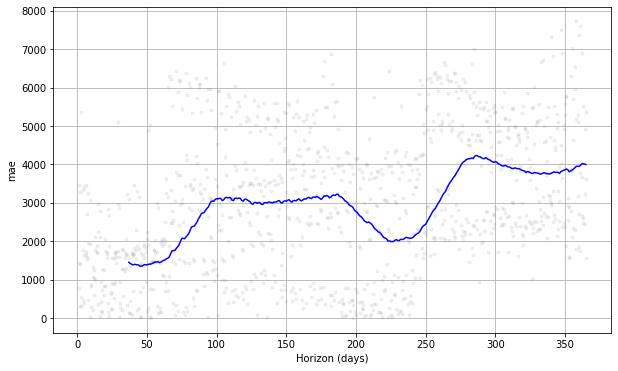

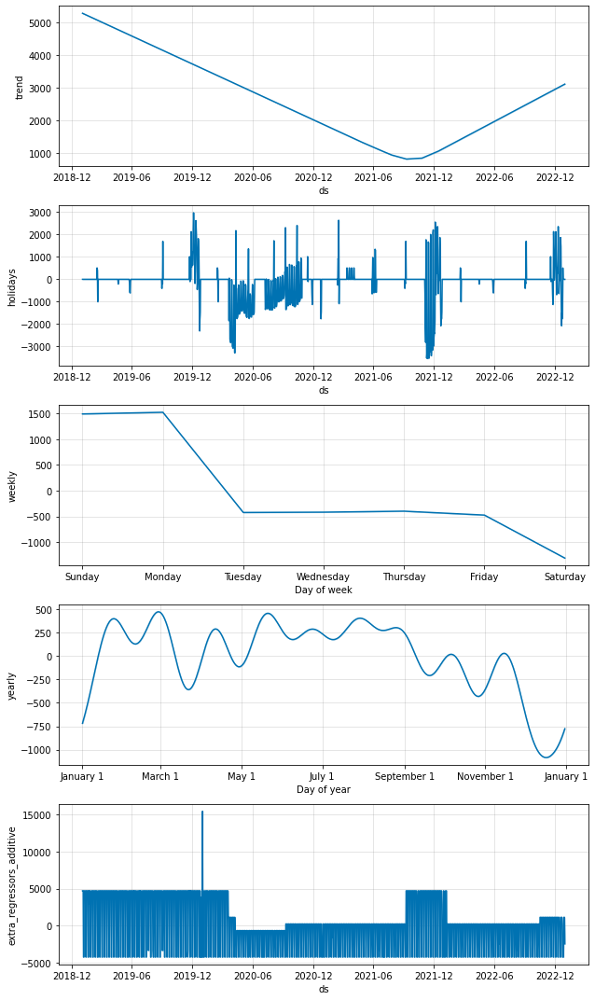

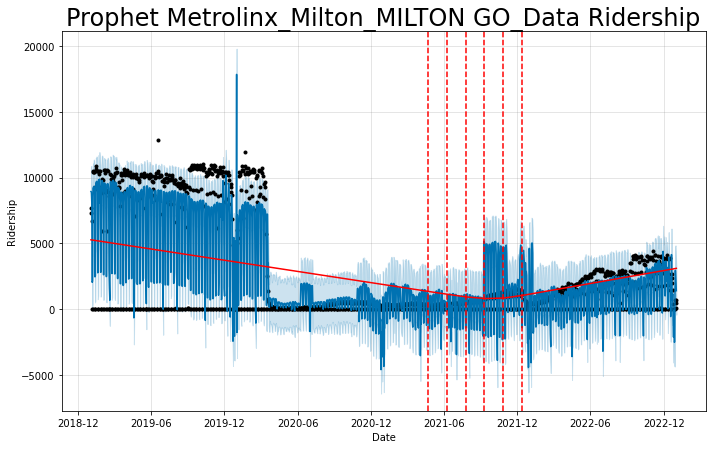

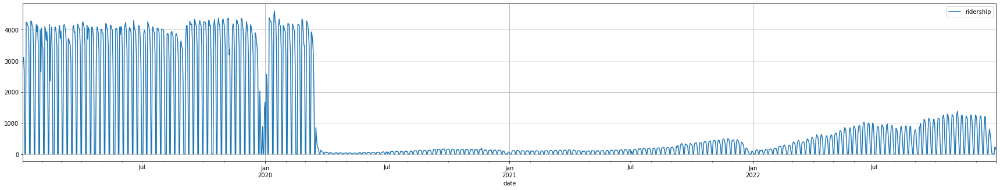

--------------
Test statistic:  -1.8662966167443402
p-value:  0.34807849507625566
Critical Values: {'1%': -3.434911997169608, '5%': -2.863554810504947, '10%': -2.567842671398422}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

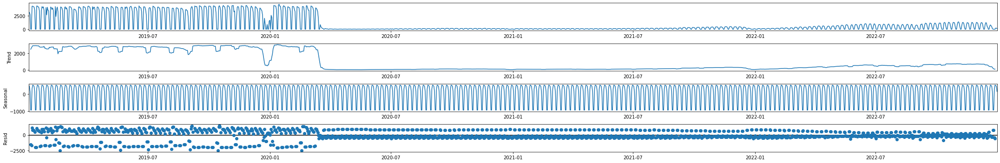

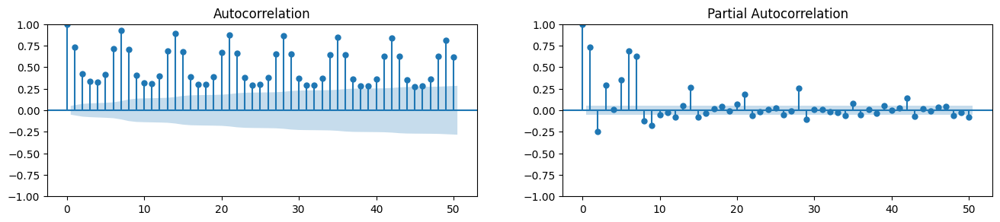

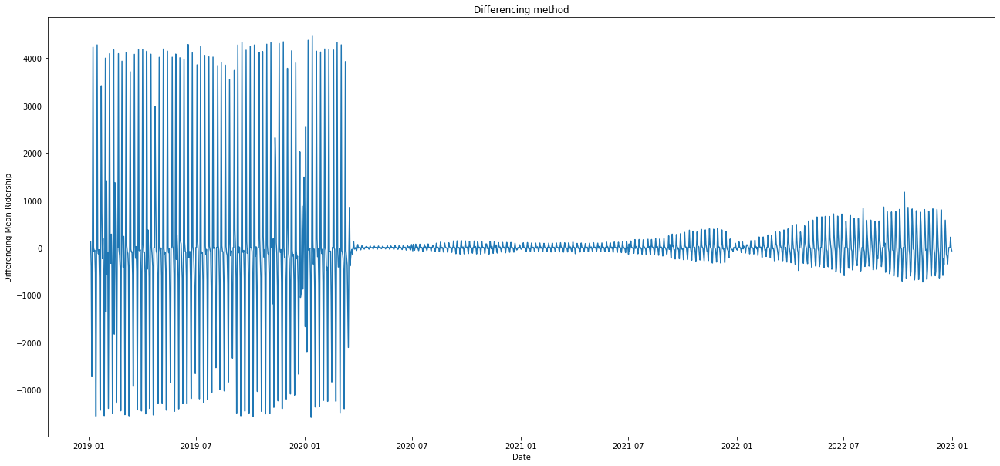

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=18543.385, Time=0.35 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=18700.668, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=18676.389, Time=0.15 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=18213.348, Time=0.63 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=18698.674, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=18678.454, Time=0.08 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=18215.237, Time=1.02 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=18405.102, Time=0.94 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=18674.378, Time=0.17 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=18100.482, Time=1.87 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=18069.825, Time=2.64 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=17938.316, Time=1.79 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=18097.108, Time=1.64 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=18402.209, Time=1.12 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Richmond Hill_UNION STATION_Data ARIMA MSE Error: 207053.4948
 Metrolinx_Richmond Hill_UNION STATION_Data ARIMA  RMSE Error: 455.0313119 
 Metrolinx_Richmond Hill_UNION STATION_Data ARIMA  R square: -0.2621875697
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_16 (LSTM)              (None, 100)               40800     
                                                                 
 dense_16 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1064/1064 [==============================] - 6s 5ms/step - loss: 0.0752
Epoch 2/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0594
Epoch 3/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0335
Epoch 4/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0235
Epoch 5/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0178
Epoch 6/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0145
Epoch 7/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0123
Epoch 8/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0122
Epoch 9/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0109
Epoch 10/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0113
Epoch 11/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0108
Epoch 12/100
1064/1064 [==============================] - 5s 5ms/step - loss: 0.0101
E

<IPython.core.display.Javascript object>


 Metrolinx_Richmond Hill_UNION STATION_Data LSTM MSE Error: 321904.1676
 Metrolinx_Richmond Hill_UNION STATION_Data LSTM  RMSE Error: 567.3659908 
 Metrolinx_Richmond Hill_UNION STATION_Data LSTM  R square: -0.9623114274
          ds     y  trips
0 2019-01-03  2997      7
1 2019-01-04  3114      7
2 2019-01-05  2711      7
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Richmond Hill_UNION STATION_Data ######### 
 


18:37:03 - cmdstanpy - INFO - Chain [1] start processing
18:37:03 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

18:37:04 - cmdstanpy - INFO - Chain [1] start processing
18:37:04 - cmdstanpy - INFO - Chain [1] done processing
18:37:05 - cmdstanpy - INFO - Chain [1] start processing
18:37:06 - cmdstanpy - INFO - Chain [1] done processing
18:37:07 - cmdstanpy - INFO - Chain [1] start processing
18:37:07 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.313034999999218


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Richmond Hill_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            1443266.762784
rmse              1178.484107
mae               1041.797992
mdape                3.544262
smape                 1.68436
coverage             0.283772
dtype: object
             ds  trips
0    2019-01-03      7
1    2019-01-04      7
2    2019-01-05      7
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1454 2022-12-27      0
1455 2022-12-28      0
1456 2022-12-29      4
1457 2022-12-30      4
1458 2022-12-31      4

[1459 rows x 2 columns]

 Metrolinx_Richmond Hill_UNION STATION_Data Prophet MSE Error: 185533.2098
 Metrolinx_Richmond Hill_UNION STATION_Data Prophet  RMSE Error: 430.7356612 
 Metrolinx_Richmond Hill_UNION STATION_Data Prophet  R square: -0.1310010074
=================Metrolinx_Stouffville_UNION STATION_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Stouffville_UNION STATION_Data.cs

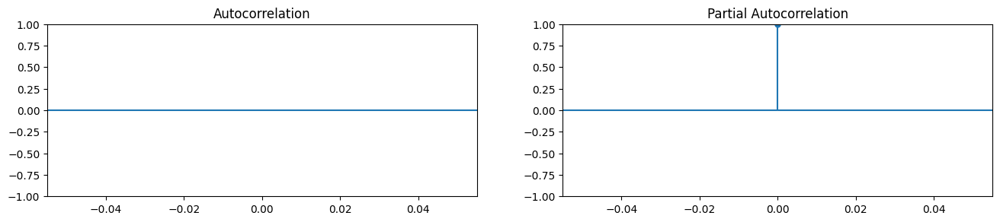

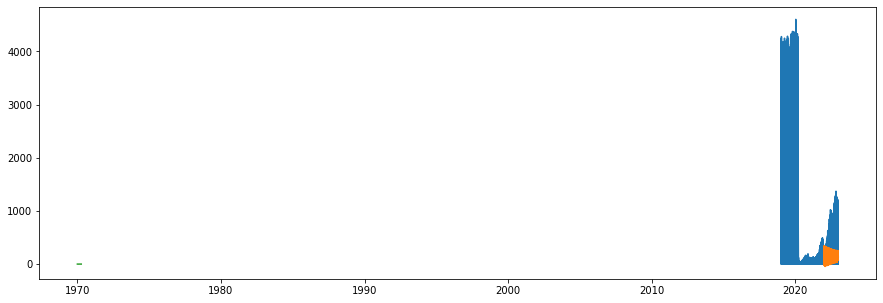

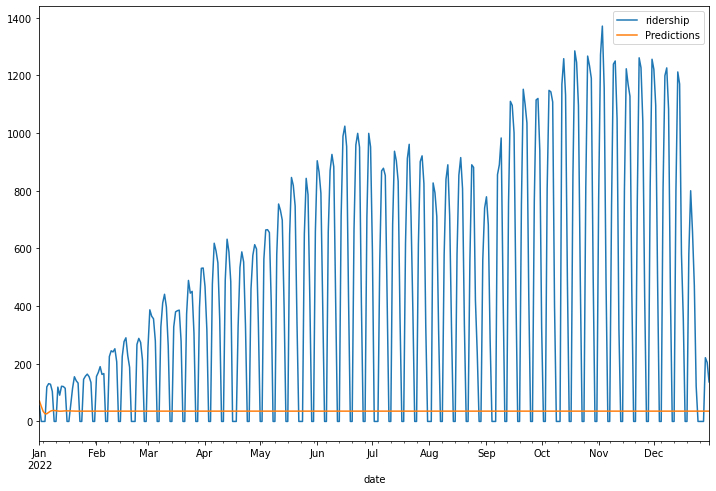

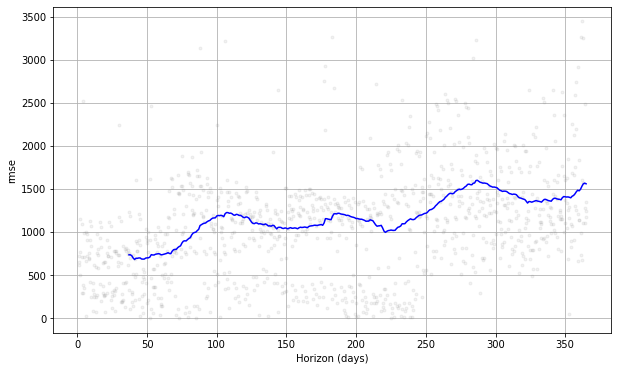

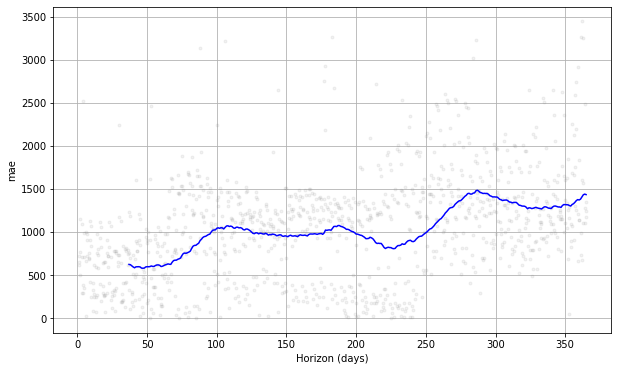

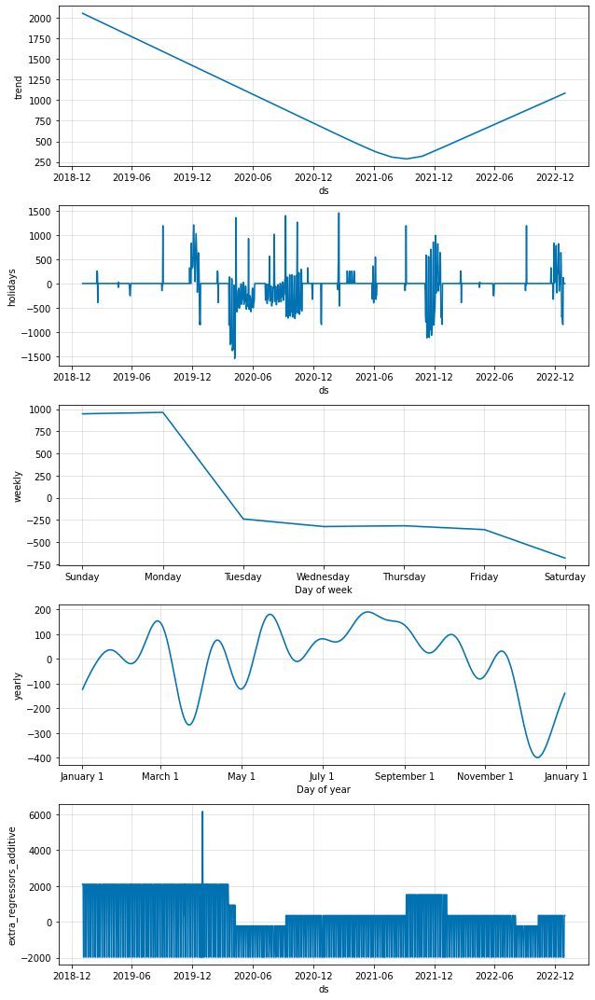

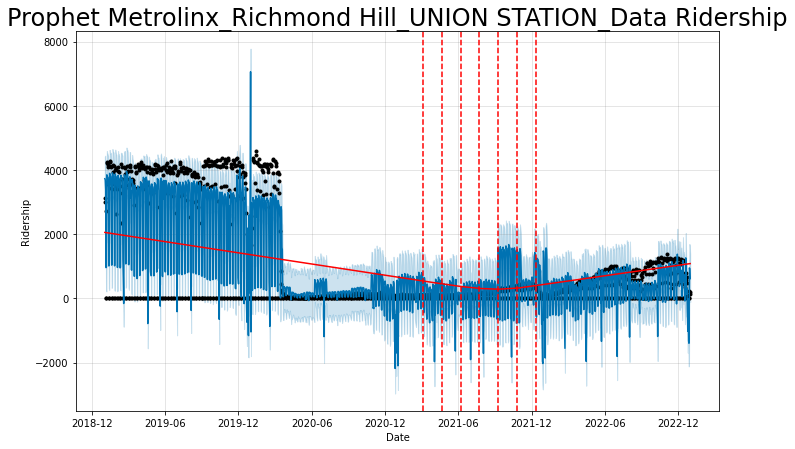

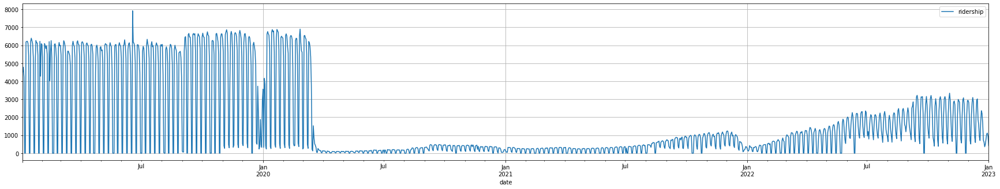

--------------
Test statistic:  -1.9323134056393474
p-value:  0.31701583612146544
Critical Values: {'1%': -3.434908816804013, '5%': -2.863553406963303, '10%': -2.5678419239852994}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

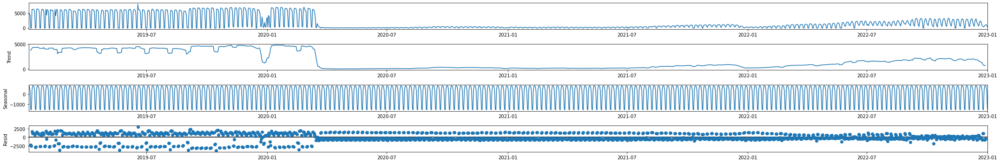

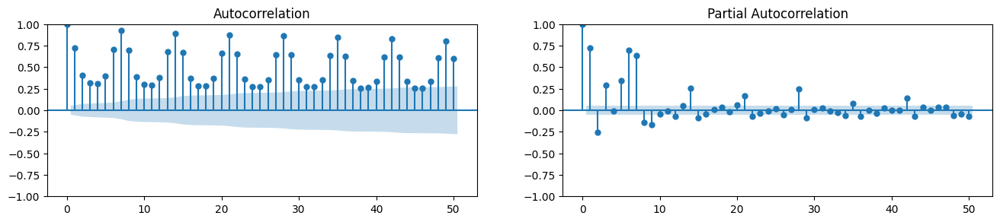

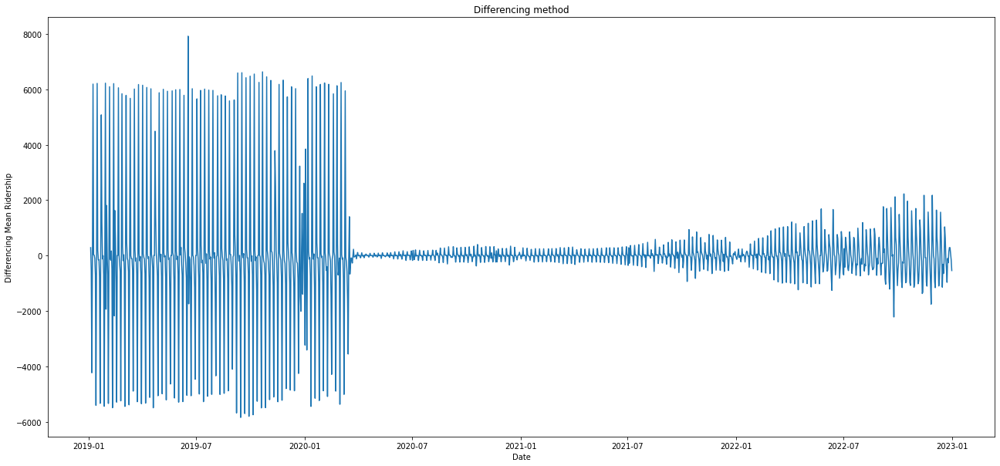

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19477.621, Time=0.32 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19634.295, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19613.524, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19148.783, Time=0.66 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19632.300, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19611.593, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19150.781, Time=1.01 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=19325.037, Time=0.96 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19610.229, Time=0.16 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=19032.139, Time=2.15 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=18984.822, Time=2.90 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=18882.548, Time=1.71 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=19043.037, Time=1.28 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=19329.113, Time=1.11 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Stouffville_UNION STATION_Data ARIMA MSE Error: 1850305.838
 Metrolinx_Stouffville_UNION STATION_Data ARIMA  RMSE Error: 1360.259474 
 Metrolinx_Stouffville_UNION STATION_Data ARIMA  R square: -1.181217675
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_17 (LSTM)              (None, 100)               40800     
                                                                 
 dense_17 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1065/1065 [==============================] - 6s 5ms/step - loss: 0.0567
Epoch 2/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0481
Epoch 3/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0316
Epoch 4/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0231
Epoch 5/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0161
Epoch 6/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0113
Epoch 7/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0092
Epoch 8/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0096
Epoch 9/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0093
Epoch 10/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0086
Epoch 11/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0084
Epoch 12/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0079
E

<IPython.core.display.Javascript object>


 Metrolinx_Stouffville_UNION STATION_Data LSTM MSE Error: 1287641.233
 Metrolinx_Stouffville_UNION STATION_Data LSTM  RMSE Error: 1134.742805 
 Metrolinx_Stouffville_UNION STATION_Data LSTM  R square: -0.5179251769
          ds     y  trips
0 2019-01-03  4499     14
1 2019-01-04  4783     15
2 2019-01-05  4234     15
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Stouffville_UNION STATION_Data ######### 
 


18:47:06 - cmdstanpy - INFO - Chain [1] start processing
18:47:07 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

18:47:08 - cmdstanpy - INFO - Chain [1] start processing
18:47:08 - cmdstanpy - INFO - Chain [1] done processing
18:47:09 - cmdstanpy - INFO - Chain [1] start processing
18:47:09 - cmdstanpy - INFO - Chain [1] done processing
18:47:10 - cmdstanpy - INFO - Chain [1] start processing
18:47:11 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.688366099999257


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Stouffville_UNION STATION_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            7756137.304637
rmse              2759.475303
mae               2313.439855
mdape                2.704091
smape                 1.80455
coverage             0.342127
dtype: object
             ds  trips
0    2019-01-03     14
1    2019-01-04     15
2    2019-01-05     15
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1455 2022-12-28     15
1456 2022-12-29     17
1457 2022-12-30     17
1458 2022-12-31     17
1459 2023-01-01     15

[1460 rows x 2 columns]

 Metrolinx_Stouffville_UNION STATION_Data Prophet MSE Error: 609233.2062
 Metrolinx_Stouffville_UNION STATION_Data Prophet  RMSE Error: 780.5339238 
 Metrolinx_Stouffville_UNION STATION_Data Prophet  R square: 0.281810493
=================Metrolinx_Stouffville_OLD ELM GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Stouffville_OLD ELM GO_Data.csv
time series lo

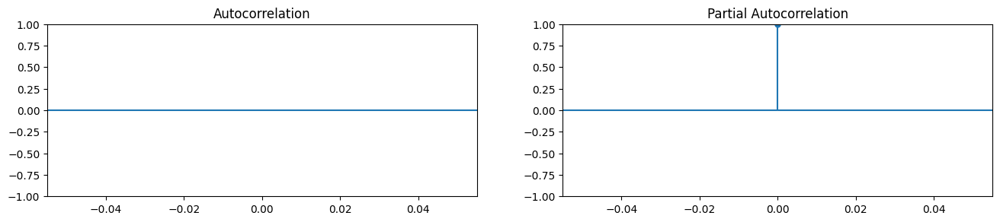

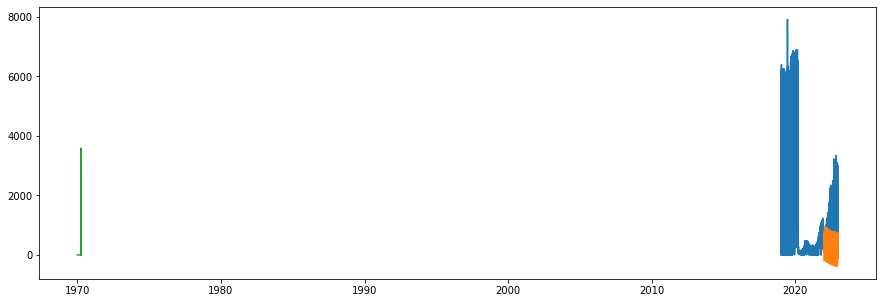

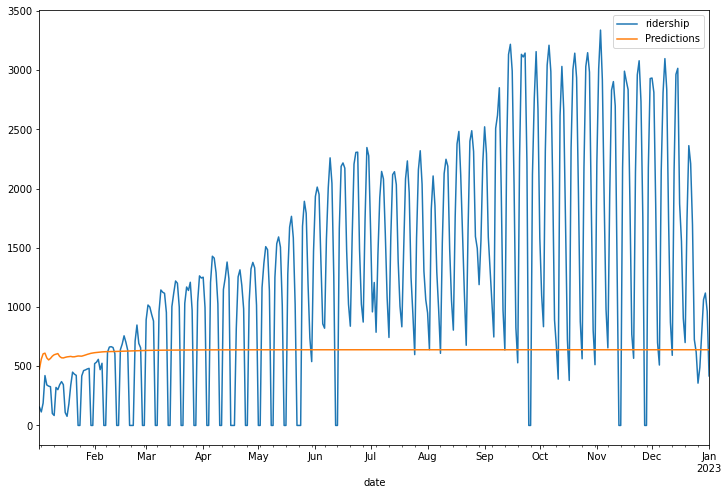

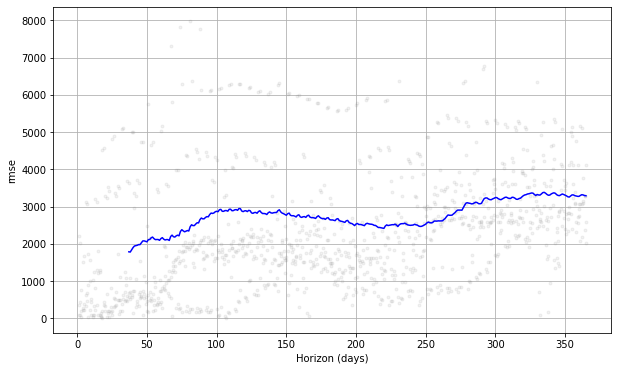

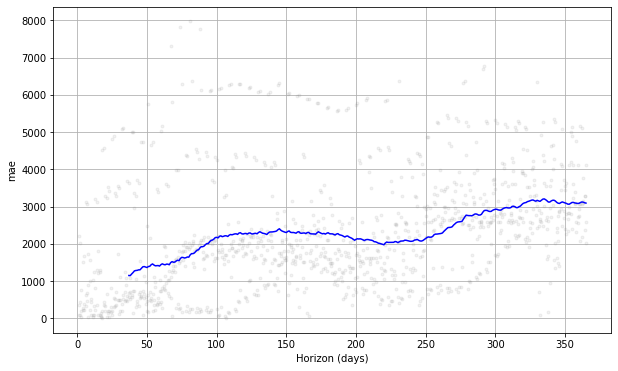

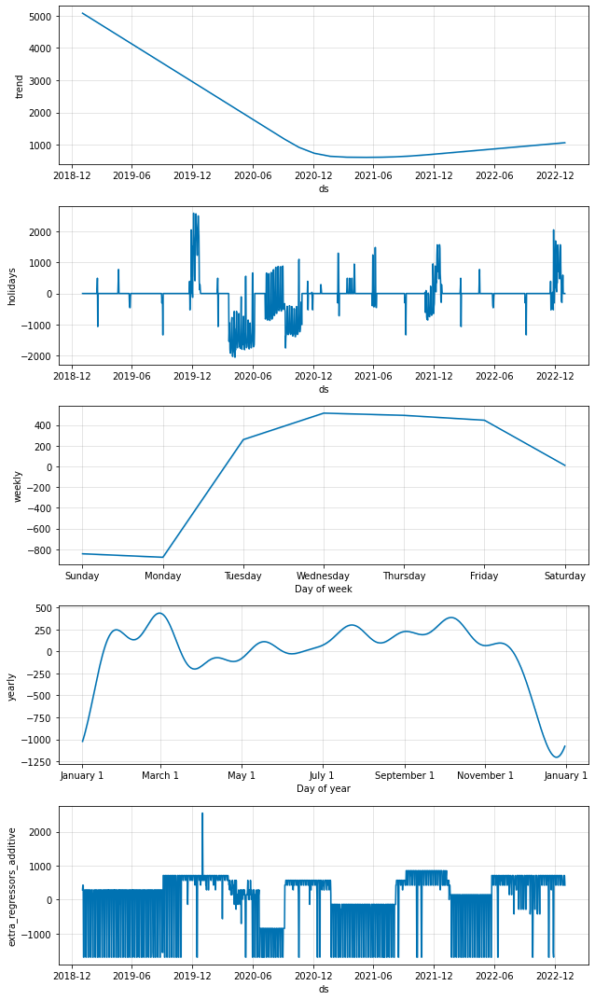

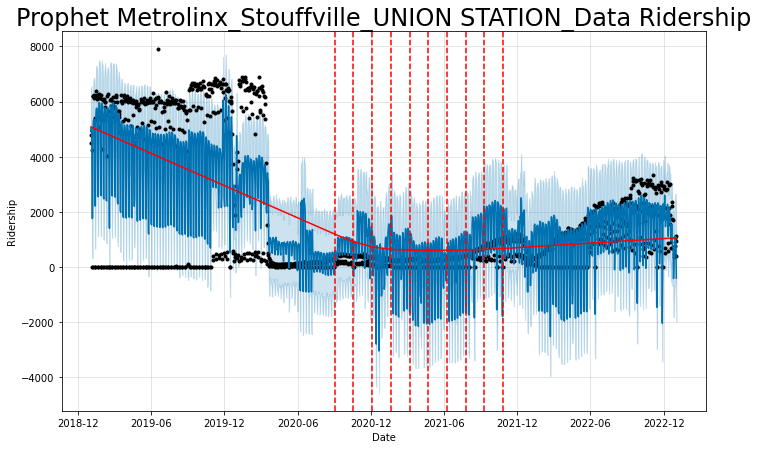

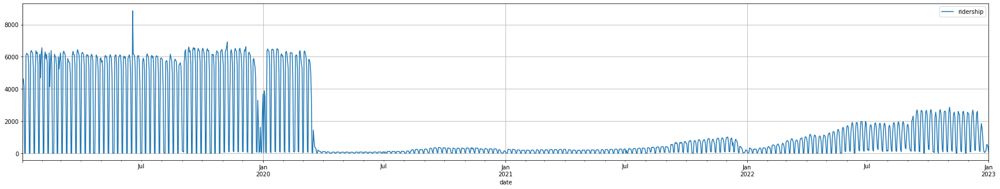

--------------
Test statistic:  -1.890480511309563
p-value:  0.33655254526936074
Critical Values: {'1%': -3.434908816804013, '5%': -2.863553406963303, '10%': -2.5678419239852994}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

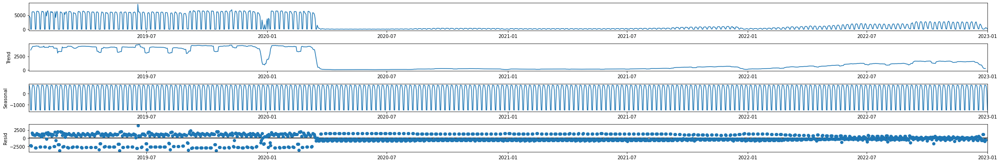

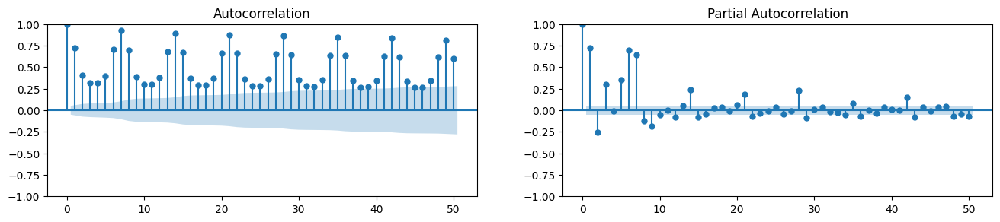

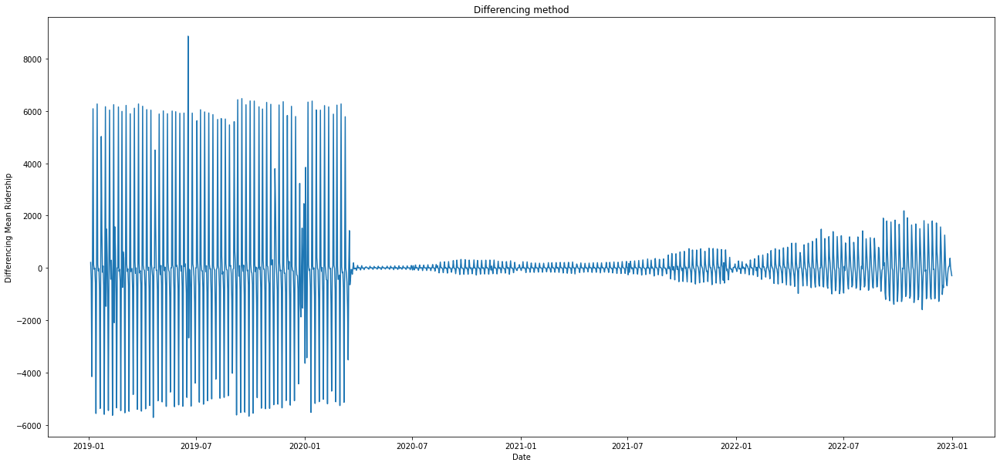

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=19489.819, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=19640.066, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=19619.291, Time=0.14 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=19136.993, Time=0.66 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=19638.071, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=19617.877, Time=0.06 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=19139.062, Time=1.02 sec
 ARIMA(0,1,1)(0,0,2)[6] intercept   : AIC=19318.585, Time=1.11 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=19616.251, Time=0.16 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=19016.257, Time=2.51 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=19001.028, Time=2.84 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=18874.778, Time=1.73 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=19031.629, Time=1.33 sec
 ARIMA(0,1,0)(2,0,1)[6] intercept   : AIC=19383.582, Time=0.83 sec
 ARIMA(1,1,1)(2,0,1

<IPython.core.display.Javascript object>


 Metrolinx_Stouffville_OLD ELM GO_Data ARIMA MSE Error: 976278.2566
 Metrolinx_Stouffville_OLD ELM GO_Data ARIMA  RMSE Error: 988.0679413 
 Metrolinx_Stouffville_OLD ELM GO_Data ARIMA  R square: -0.3773461258
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_18 (LSTM)              (None, 100)               40800     
                                                                 
 dense_18 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


1065/1065 [==============================] - 6s 5ms/step - loss: 0.0447
Epoch 2/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0275
Epoch 3/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0160
Epoch 4/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0132
Epoch 5/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0106
Epoch 6/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0084
Epoch 7/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0076
Epoch 8/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0069
Epoch 9/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0068
Epoch 10/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0065
Epoch 11/100
1065/1065 [==============================] - 5s 5ms/step - loss: 0.0068
Epoch 12/100
1065/1065 [==============================] - 6s 5ms/step - loss: 0.0062
E

<IPython.core.display.Javascript object>


 Metrolinx_Stouffville_OLD ELM GO_Data LSTM MSE Error: 1395320.625
 Metrolinx_Stouffville_OLD ELM GO_Data LSTM  RMSE Error: 1181.236905 
 Metrolinx_Stouffville_OLD ELM GO_Data LSTM  R square: -0.9685365764
          ds     y  trips
0 2019-01-03  4414      9
1 2019-01-04  4622      9
2 2019-01-05  4156      9
3 2019-01-06     0      0
4 2019-01-07     0      0
 
  ########## Cross validation for Metrolinx_Stouffville_OLD ELM GO_Data ######### 
 


18:57:25 - cmdstanpy - INFO - Chain [1] start processing
18:57:25 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/3 [00:00<?, ?it/s]

18:57:26 - cmdstanpy - INFO - Chain [1] start processing
18:57:26 - cmdstanpy - INFO - Chain [1] done processing
18:57:27 - cmdstanpy - INFO - Chain [1] start processing
18:57:28 - cmdstanpy - INFO - Chain [1] done processing
18:57:29 - cmdstanpy - INFO - Chain [1] start processing
18:57:29 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  5.562276900000143


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Stouffville_OLD ELM GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse            2734833.909382
rmse              1625.729715
mae               1327.079163
mdape                2.043445
smape                1.487796
coverage             0.451112
dtype: object
             ds  trips
0    2019-01-03      9
1    2019-01-04      9
2    2019-01-05      9
3    2019-01-06      0
4    2019-01-07      0
...         ...    ...
1455 2022-12-28      3
1456 2022-12-29      6
1457 2022-12-30      6
1458 2022-12-31      6
1459 2023-01-01      3

[1460 rows x 2 columns]

 Metrolinx_Stouffville_OLD ELM GO_Data Prophet MSE Error: 484734.4359
 Metrolinx_Stouffville_OLD ELM GO_Data Prophet  RMSE Error: 696.2287238 
 Metrolinx_Stouffville_OLD ELM GO_Data Prophet  R square: 0.3161303217
=================Metrolinx_Stouffville_MOUNT JOY GO_Data==================
C:\Users\DKici\Desktop\Metrolinx\notebook\ts_data\Metrolinx_Stouffville_MOUNT JOY GO_Data.csv
time series loaded!
D

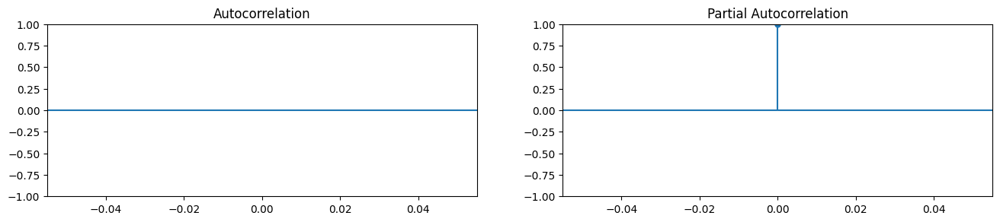

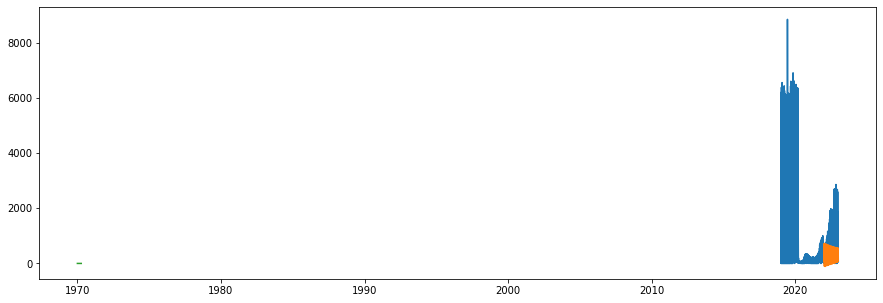

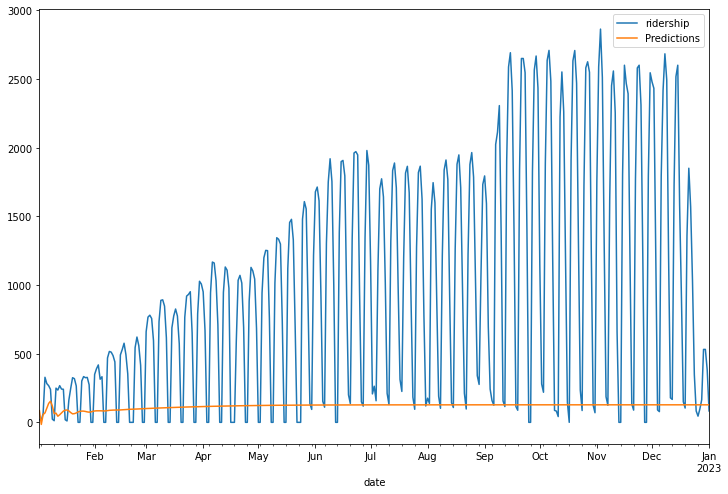

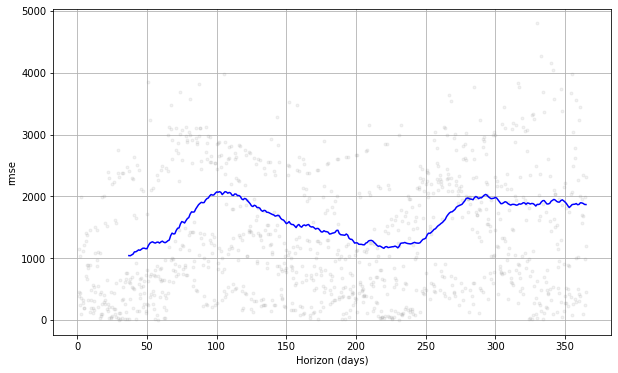

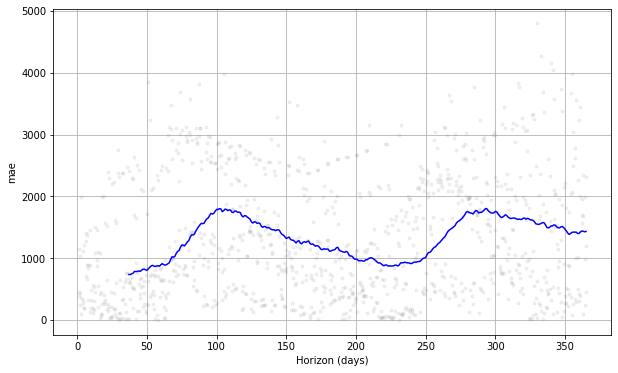

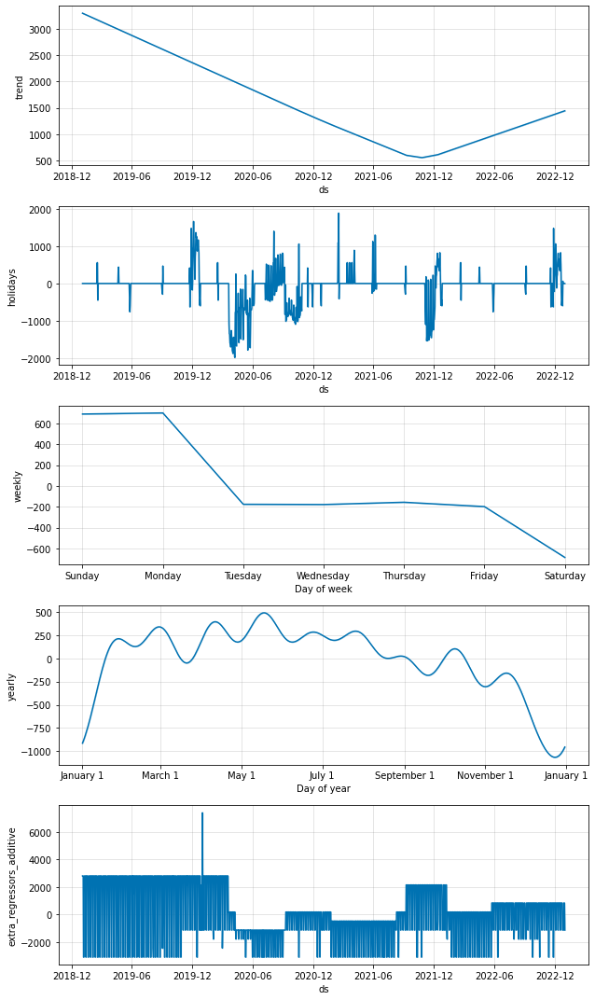

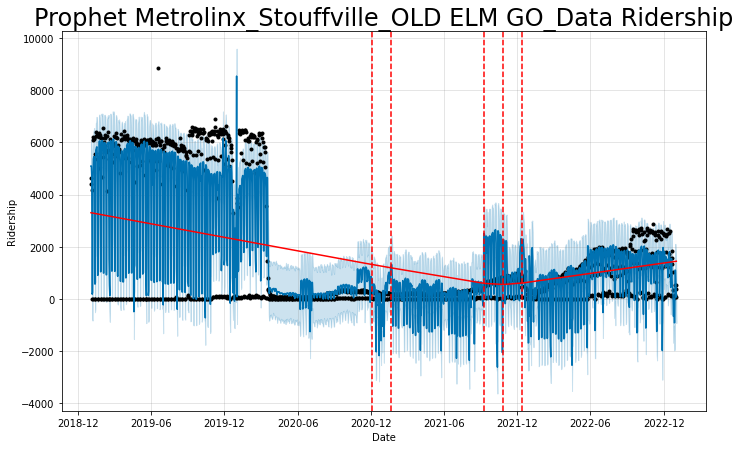

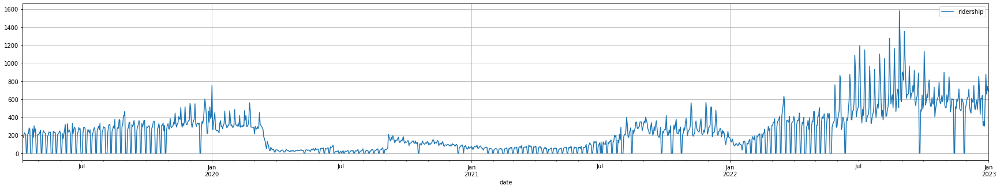

--------------
Test statistic:  -1.2417555735943089
p-value:  0.6553806861518309
Critical Values: {'1%': -3.4352394560472033, '5%': -2.863699314925706, '10%': -2.567919624081087}
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary


C:\Users\DKici\Desktop\Metrolinx\notebook\utils.py:248: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  data_decompose_add.plot().show()


<IPython.core.display.Javascript object>

C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

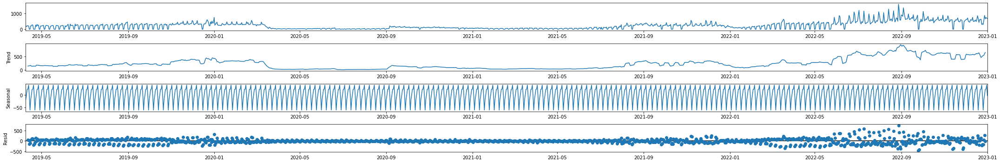

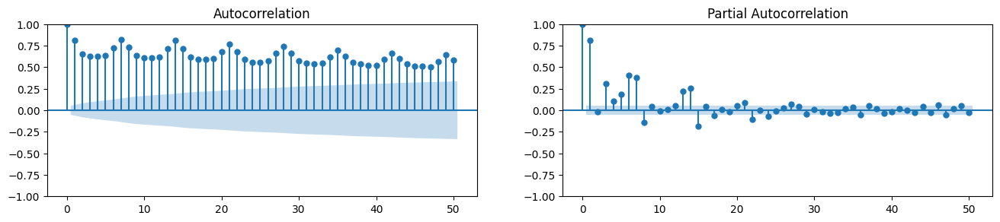

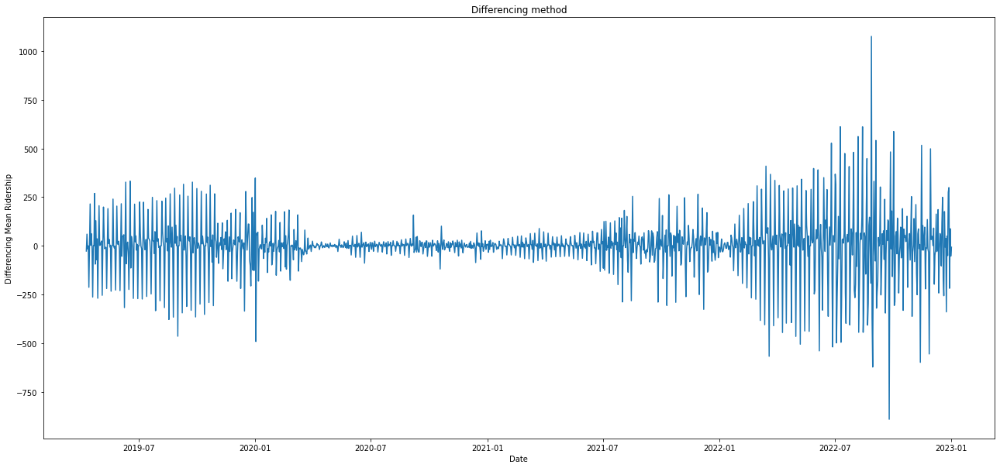

<IPython.core.display.Javascript object>

C:\Users\DKici\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[6] intercept   : AIC=11836.174, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[6] intercept   : AIC=11863.575, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[6] intercept   : AIC=11857.046, Time=0.12 sec
 ARIMA(0,1,1)(0,0,1)[6] intercept   : AIC=11718.013, Time=0.37 sec
 ARIMA(0,1,0)(0,0,0)[6]             : AIC=11861.575, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[6] intercept   : AIC=11762.793, Time=0.15 sec
 ARIMA(0,1,1)(1,0,1)[6] intercept   : AIC=11717.302, Time=0.57 sec
 ARIMA(0,1,1)(1,0,0)[6] intercept   : AIC=11730.469, Time=0.32 sec
 ARIMA(0,1,1)(2,0,1)[6] intercept   : AIC=11622.848, Time=0.84 sec
 ARIMA(0,1,1)(2,0,0)[6] intercept   : AIC=11693.320, Time=0.81 sec
 ARIMA(0,1,1)(2,0,2)[6] intercept   : AIC=11536.399, Time=2.81 sec
 ARIMA(0,1,1)(1,0,2)[6] intercept   : AIC=11653.857, Time=1.27 sec
 ARIMA(0,1,0)(2,0,2)[6] intercept   : AIC=11776.941, Time=1.82 sec
 ARIMA(1,1,1)(2,0,2)[6] intercept   : AIC=inf, Time=2.82 sec
 ARIMA(0,1,2)(2,0,2)[6] i

<IPython.core.display.Javascript object>


 Metrolinx_Stouffville_MOUNT JOY GO_Data ARIMA MSE Error: 122998.0702
 Metrolinx_Stouffville_MOUNT JOY GO_Data ARIMA  RMSE Error: 350.7108071 
 Metrolinx_Stouffville_MOUNT JOY GO_Data ARIMA  R square: -0.5472177017
Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_19 (LSTM)              (None, 100)               40800     
                                                                 
 dense_19 (Dense)            (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\ipykernel_launcher.py:101: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


969/969 [==============================] - 6s 5ms/step - loss: 0.0161
Epoch 2/100
969/969 [==============================] - 6s 6ms/step - loss: 0.0144
Epoch 3/100
969/969 [==============================] - 5s 6ms/step - loss: 0.0139
Epoch 4/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0133
Epoch 5/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0132
Epoch 6/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0120
Epoch 7/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0107
Epoch 8/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0104
Epoch 9/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0101
Epoch 10/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0096
Epoch 11/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0092
Epoch 12/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0086
Epoch 13/100
969/969 [===

Epoch 100/100
969/969 [==============================] - 5s 5ms/step - loss: 0.0046
Elapsed time:  528.9143233000013


<IPython.core.display.Javascript object>


 Metrolinx_Stouffville_MOUNT JOY GO_Data LSTM MSE Error: 253094.0213
 Metrolinx_Stouffville_MOUNT JOY GO_Data LSTM  RMSE Error: 503.0845072 
 Metrolinx_Stouffville_MOUNT JOY GO_Data LSTM  R square: -2.18372109
          ds    y  trips
0 2019-04-09  196      5
1 2019-04-10  169      3
2 2019-04-11  229      5
3 2019-04-12  213      5
4 2019-04-13  213      5
 
  ########## Cross validation for Metrolinx_Stouffville_MOUNT JOY GO_Data ######### 
 


19:07:02 - cmdstanpy - INFO - Chain [1] start processing
19:07:02 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/2 [00:00<?, ?it/s]

19:07:03 - cmdstanpy - INFO - Chain [1] start processing
19:07:03 - cmdstanpy - INFO - Chain [1] done processing
19:07:05 - cmdstanpy - INFO - Chain [1] start processing
19:07:05 - cmdstanpy - INFO - Chain [1] done processing


Elapsed time:  4.3020829999986745


C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:545: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaconda3\envs\Dart_env_37\lib\site-packages\prophet\plot.py:544: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\DKici\Anaco

 
 Ridership Metrolinx_Stouffville_MOUNT JOY GO_Data- CV-metrics mean 

horizon     201 days 00:00:00
mse              50450.117086
rmse               209.785902
mae                158.528756
mdape                0.446724
smape                0.721066
coverage             0.326581
dtype: object
             ds  trips
0    2019-04-09      5
1    2019-04-10      3
2    2019-04-11      5
3    2019-04-12      5
4    2019-04-13      5
...         ...    ...
1359 2022-12-28     12
1360 2022-12-29     10
1361 2022-12-30     10
1362 2022-12-31     10
1363 2023-01-01     12

[1364 rows x 2 columns]

 Metrolinx_Stouffville_MOUNT JOY GO_Data Prophet MSE Error: 23166.66539
 Metrolinx_Stouffville_MOUNT JOY GO_Data Prophet  RMSE Error: 152.2059966 
 Metrolinx_Stouffville_MOUNT JOY GO_Data Prophet  R square: 0.7085818116


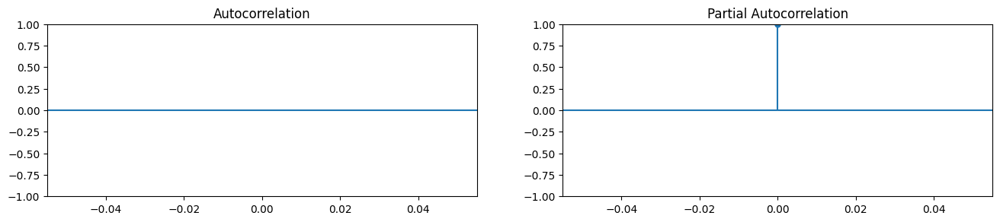

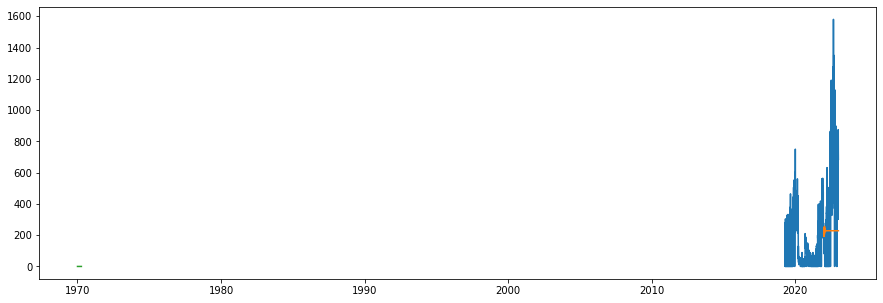

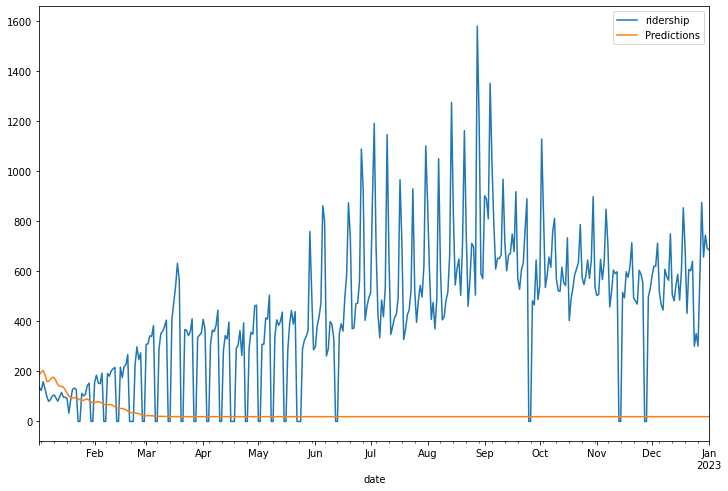

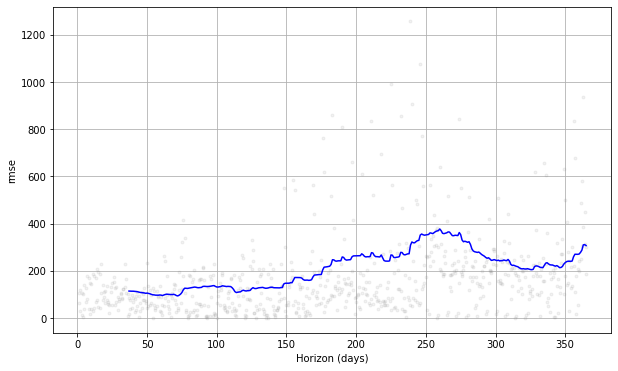

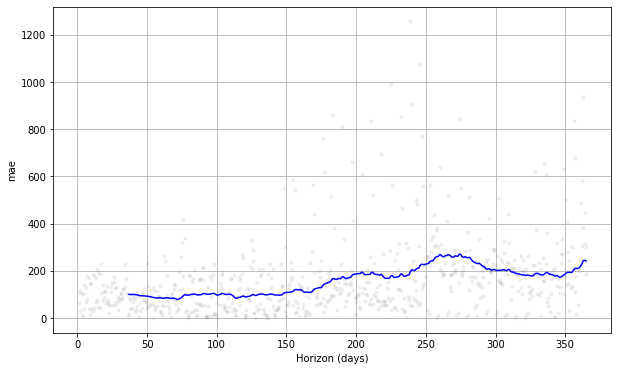

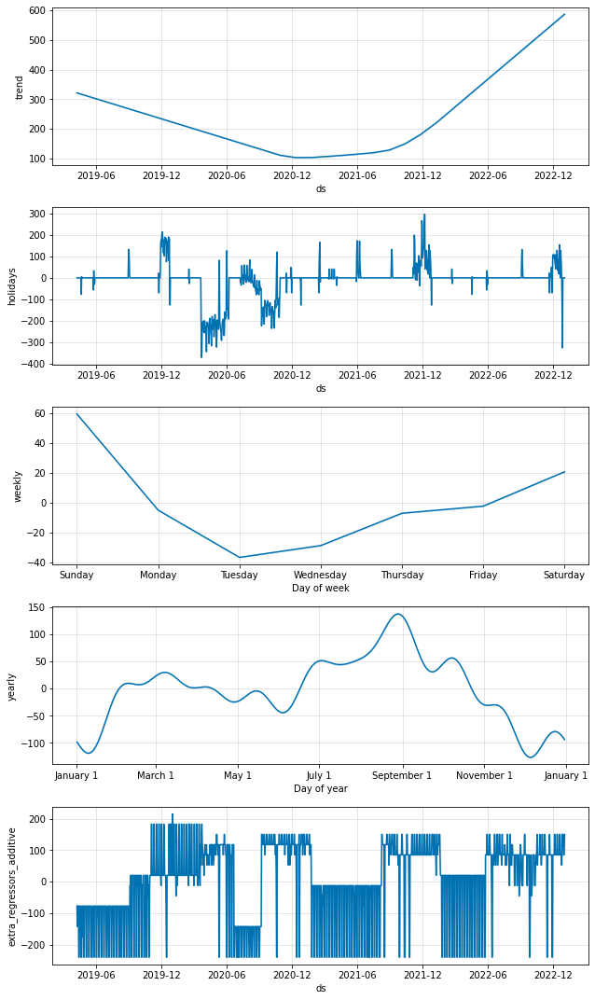

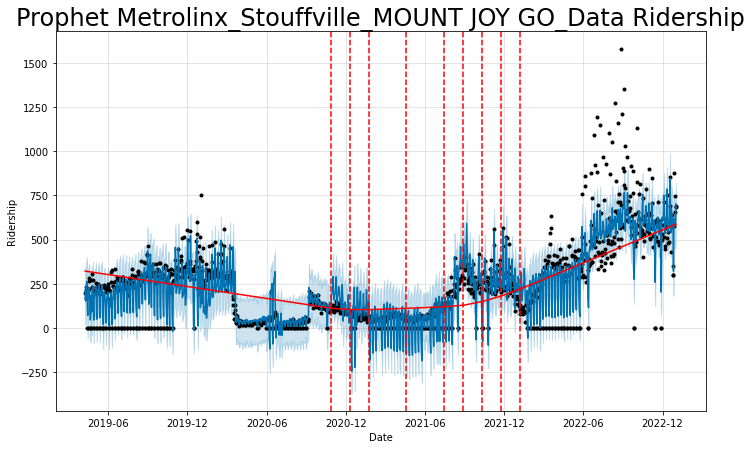

In [57]:
my_evaluation = pd.DataFrame({'model': [],
                                 'ts': [],
                                 'mse':[],
                                 'rmse':[],
                                 'R2':[],
                                 'time (min)' : []
                                })



for st in rc_st_data:
    print(f"================={st}==================")
    ts = f"{st}.csv"
    ts_data_path = ts_path + ts
    print(ts_data_path)
    data, data_all, data_regressors = load_single_timeseries(ts_data_path)
    print(data)
    timeseries_eda(data)
    print(f"--------------")
    check_adfuller(data)
    fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
    plot_acf(data, lags=50, ax=axes[0]);
    plot_pacf(data, lags=50, ax=axes[1]);
    
    data_diff = data - data.shift()
    plt.figure(figsize=(22,10))
    plt.plot(data_diff)
    plt.title("Differencing method") 
    plt.xlabel("Date")
    plt.ylabel("Differencing Mean Ridership")
    plt.show()
    
    fig, axes = plt.subplots(1,2,figsize=(16,3), dpi= 100)
    plot_acf(data_diff, lags=50, ax=axes[0]);
    plot_pacf(data_diff, lags=50, ax=axes[1]);
    
    train = data.iloc[:-365,:] # 3 years (75%)
    test = data.iloc[-365:,:] # 1 year (25%)
    len(train),len(test)
    
    
    ##################################### MODEL 1 - ARIMA #####################################
    # Start timer
    start_time = time.perf_counter()
    arima_model = auto_arima(train, start_p=0, start_q=0,
                      max_p=2, max_q=2, m=6,
                      d=None, trace=True,
                      error_action='ignore',   # we don't want to know if an order does not work
                      suppress_warnings=True,  # we don't want convergence warnings
                      stepwise=True)           # set to stepwise

    arima_model.summary()
    
    # End timer
    end_time = time.perf_counter()

    # Calculate elapsed time
    elapsed_time = end_time - start_time
    print("Elapsed time: ", elapsed_time)
    
    # Forecast
    prediction = arima_model.predict(n_periods=len(test))
    # prediction
    prediction_series = pd.Series(prediction,index=test.index)
    fig, ax = plt.subplots(1, 1, figsize=(15, 5))
    ax.plot(data.ridership)
    ax.plot(prediction_series)
    
    mse, rmse, r2 = model_evaluation(test['ridership'], prediction_series, "ARIMA", st)
    mse_score.append(mse)
    rmse_score.append(rmse)
    r2_score_.append(r2)
    
    r = my_evaluation.shape[0]
    my_evaluation.loc[r] = ['ARIMA', st, mse, rmse, r2, elapsed_time/60]


    ##################################### LSTM ####################################
    scaler = MinMaxScaler()
    scaler.fit(train.values.reshape(-1,1))

    scaled_train = scaler.transform(train.values.reshape(-1,1))
    scaled_test = scaler.transform(test.values.reshape(-1,1))
    
    # Let's redefine to get 3 months back and then predict the next month out
    n_input = 30
    n_features = 1
    generator = TimeseriesGenerator(scaled_train, scaled_train, length=n_input, batch_size=1)

    # define model
    model = Sequential()
    model.add(LSTM(100, activation='relu', input_shape=(n_input, n_features)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse')
    model.summary()
    
    # Start timer
    start_time = time.perf_counter()

    # fit model
    model.fit_generator(generator,epochs=100)

    # End timer
    end_time = time.perf_counter()

    # Calculate elapsed time
    elapsed_time = end_time - start_time
    print("Elapsed time: ", elapsed_time)
    
    loss_per_epoch = model.history.history['loss']
    plt.plot(range(len(loss_per_epoch)),loss_per_epoch)
    
    first_eval_batch = scaled_train[-30:]
    first_eval_batch = first_eval_batch.reshape((1, n_input, n_features))
    model.predict(first_eval_batch)

    test_predictions = []

    first_eval_batch = scaled_train[-n_input:]
    current_batch = first_eval_batch.reshape((1, n_input, n_features))

    for i in range(len(test)):
        # get prediction 1 time stamp ahead ([0] is for grabbing just the number instead of [array])
        current_pred = model.predict(current_batch)[0]
        # store prediction
        test_predictions.append(current_pred) 
        # update batch to now include prediction and drop first value
        current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)
        
    # Inverse Transformations and Compare
    true_predictions = scaler.inverse_transform(test_predictions)
    test = pd.DataFrame(test)
    test['Predictions'] = true_predictions
    test.plot(figsize=(12,8))
      
    mse, rmse, r2 = model_evaluation(test['ridership'], test['Predictions'], "LSTM", st)
    mse_score.append(mse)
    rmse_score.append(rmse)
    r2_score_.append(r2)
    
    r = my_evaluation.shape[0]
    my_evaluation.loc[r] = ['LSTM', st, mse, rmse, r2, elapsed_time/60]
                            
#     # save the model
#     model.save('ridership_lstm_model.h5')
#     # load the model back
#     from keras.models import load_model
#     new_model = load_model('ridership_lstm_model.h5')
#     new_model.summary()

############################## PROPHET ##############################
    df = data.merge(data_regressors, on ='date')  
    df = df.reset_index()
    df = df.rename(columns = {'ridership':'y', 'date':'ds'})
    print(df.head())
    
    ##### Model Development with Cross-Validation

    # Start timer
    start_time = time.perf_counter()
    
    print(f" \n  ########## Cross validation for {st} ######### \n ")

    m = Prophet(holidays=holidays
                ,holidays_prior_scale=0.25
                ,changepoint_prior_scale=0.01
                ,seasonality_mode='additive'
                ,weekly_seasonality=True)

    m.add_regressor('trips' , prior_scale=0.5, mode='additive')
    m.fit(df)
    m_cv = cross_validation(m, initial='730 days', period='180 days', horizon = '365 days')


    # End timer
    end_time = time.perf_counter()

    # Calculate elapsed time
    elapsed_time = end_time - start_time
    print("Elapsed time: ", elapsed_time)
    
    metrics = performance_metrics(m_cv)
    # print(f" \n Ridership - CV-metrics \n")
    # print("metrics are:",metrics)

    fig = plot_cross_validation_metric(m_cv, metric='rmse')
    fig = plot_cross_validation_metric(df_cv=m_cv, metric='mae', rolling_window=0.1)
    print(f" \n Ridership {st}- CV-metrics mean \n")
    print(metrics.mean())

    data_regressors = data_regressors.reset_index()
    data_futures = data_regressors.copy()
    data_futures = data_futures.rename(columns={'date':'ds'})
    print(data_futures)

    forecast = m.predict(data_futures)
    forecast.to_csv(f"C:\\Users\\DKici\\Desktop\\Metrolinx\\forecasts\\Prophet_{st}_Ridership_forecast.csv")
    f = m.plot_components(forecast).savefig(f'{figures_path}/Prophet_{st}_Components_Ridership.jpeg');

    from prophet.plot import add_changepoints_to_plot
    fig = m.plot(forecast, xlabel='Date', ylabel='Ridership')
    a = add_changepoints_to_plot(fig.gca(), m, forecast)
    ax = fig.gca()
    ax.set_title(f"Prophet {st} Ridership", size=24)

    fig.savefig(f'{figures_path}/Prophet_{st}_change_points_Ridership.jpeg');
    
    mse, rmse, r2 = model_evaluation(test['ridership'], forecast.iloc[-365:,-1], "Prophet", st)
    mse_score.append(mse)
    rmse_score.append(rmse)
    r2_score_.append(r2)
    
    r = my_evaluation.shape[0]
    my_evaluation.loc[r] = ['Prophet', st, mse, rmse, r2, elapsed_time/60]



    # print(f" \n Ridership- regressor coefficients {regressor_coefficients}")
    # print(regressor_coefficients(m))

#     ########### Save the model ###########
#     #In Python, models should not be saved with pickle; 
#     #the Stan backend attached to the model object will not pickle well, 
#     #and will produce issues under certain versions of Python. 
#     #Instead, you should use the built-in serialization functions to serialize the model to json:

#     # from prophet.serialize import model_to_json, model_from_json

#     # with open(f'{path}/models/serialized_model_Ridership.json', 'w') as fout:
#     #     fout.write(model_to_json(m))  # Save model



In [61]:
my_evaluation.sort_values(by = 'R2', ascending=False)

,model,ts,mse,rmse,R2,time (min)
32,Prophet,Metrolinx_Kitchener_MOUNT PLEASANT GO_Data,2.830351e+04,168.236482,0.783950,0.094075
29,Prophet,Metrolinx_Kitchener_KITCHENER GO_Data,4.286345e+05,654.701833,0.772813,0.106755
5,Prophet,Metrolinx_Barrie_AURORA GO_Data,1.165693e+04,107.967280,0.741255,0.095547
20,Prophet,Metrolinx_Lakeshore West_ALDERSHOT GO_Data,1.391345e+06,1179.552805,0.728033,0.094173
50,Prophet,Metrolinx_Stouffville_MOUNT JOY GO_Data,2.316667e+04,152.205997,0.708582,0.071701
26,Prophet,Metrolinx_Kitchener_UNION STATION_Data,8.612845e+05,928.054167,0.701372,0.090264
14,Prophet,Metrolinx_Lakeshore East_OSHAWA GO_Data,3.716981e+06,1927.947374,0.557740,0.075365
2,Prophet,Metrolinx_Barrie_ALLANDALE WATERFRONT GO_Data,5.500281e+05,741.638781,0.521176,0.083982
17,Prophet,Metrolinx_Lakeshore West_UNION STATION_Data,8.146776e+06,2854.255848,0.501102,0.085385
11,Prophet,Metrolinx_Lakeshore East_UNION STATION_Data,3.449942e+06,1857.401976,0.493546,0.095676


In [62]:
my_evaluation.to_csv(f"{output_path}\\results\\Model_results_Stations.csv")

As a result, we received acceptable results for following 6 stations with Prophet model:

Metrolinx_Kitchener_MOUNT PLEASANT GO_Data

Metrolinx_Kitchener_KITCHENER GO_Data

Metrolinx_Barrie_AURORA GO_Data

Metrolinx_Lakeshore West_ALDERSHOT GO_Data

Metrolinx_Stouffville_MOUNT JOY GO_Data

Metrolinx_Kitchener_UNION STATION_Data